In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

import numpy as np
import matplotlib.pyplot as plt
from numpy.fft import rfft,irfft
from matplotlib.colors import LogNorm
from itertools import combinations
import sys, os
import astropy.coordinates
import astropy.cosmology
from scipy.ndimage import gaussian_filter

parent_directory = os.path.dirname(os.getcwd())
sys.path.append(parent_directory)
import telescope_1d

Redundant array with 32 dishes, Npix_fft is 4096.

In [2]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=32, DDish=6, Npix_fft=2**12, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky (power range from 0 to 2).

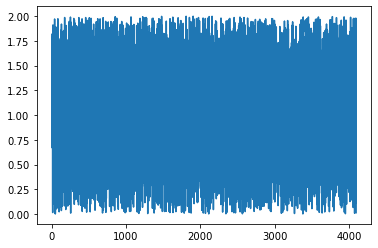

In [3]:
image = t.get_uniform_sky(high=2)
plt.plot(image); plt.show()
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


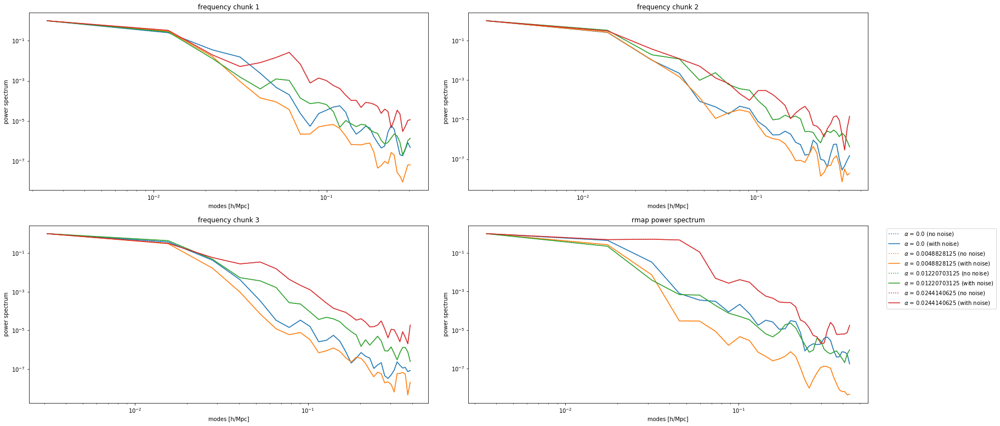

In [4]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


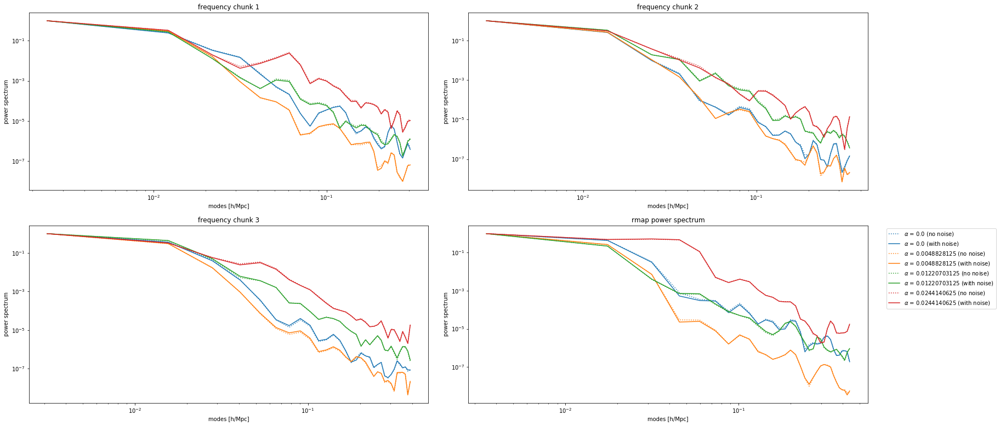

In [5]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


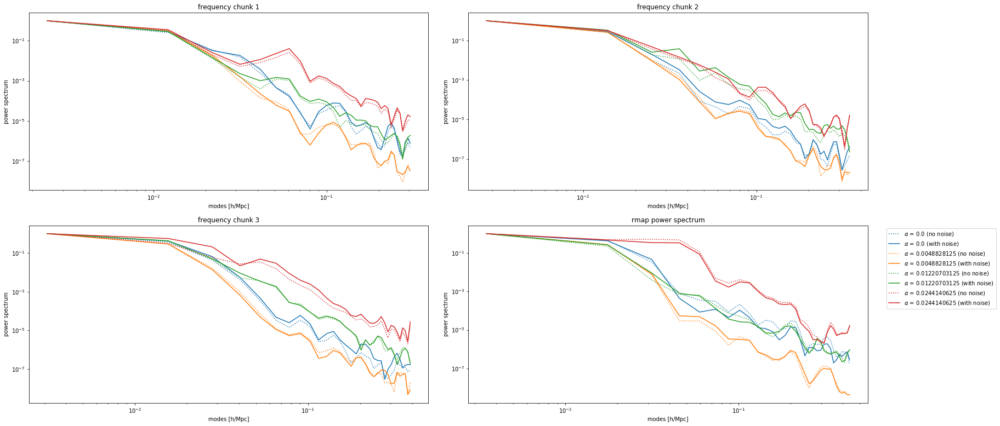

In [6]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky (lambda of 1).

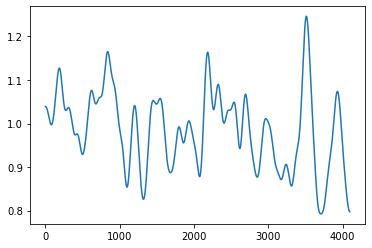

In [7]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
plt.plot(image); plt.show()
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


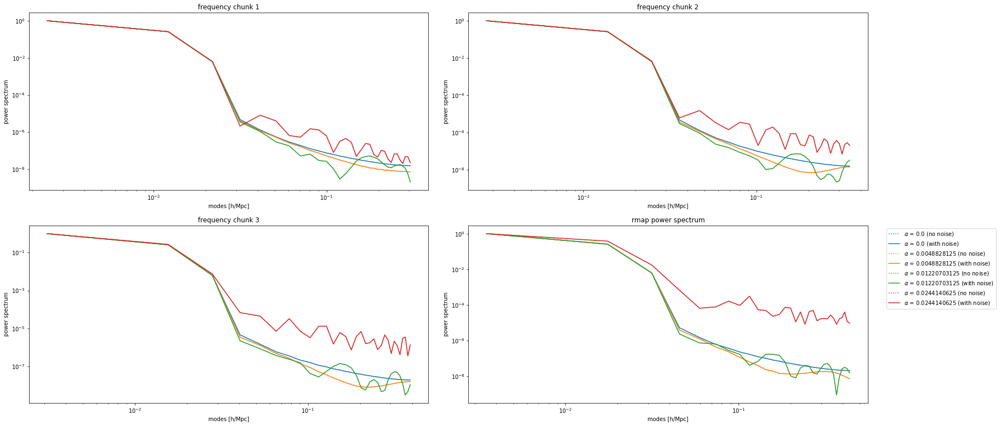

In [8]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


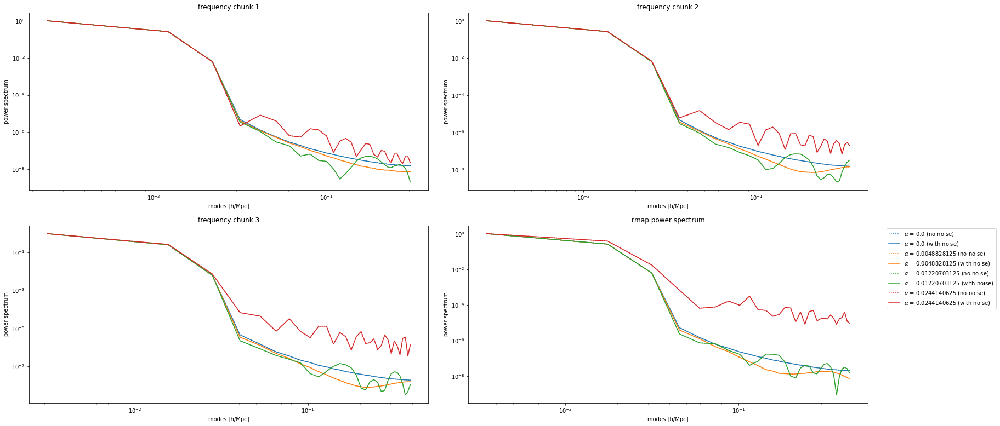

In [9]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


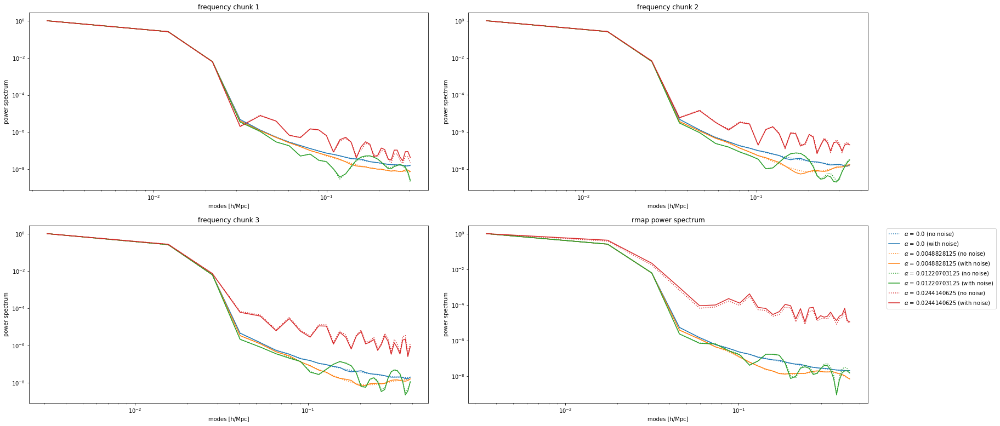

In [10]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky (mean of 1, sigma of 0.5).

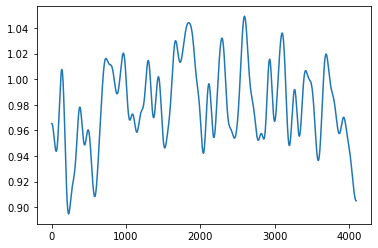

In [11]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
plt.plot(image); plt.show()
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


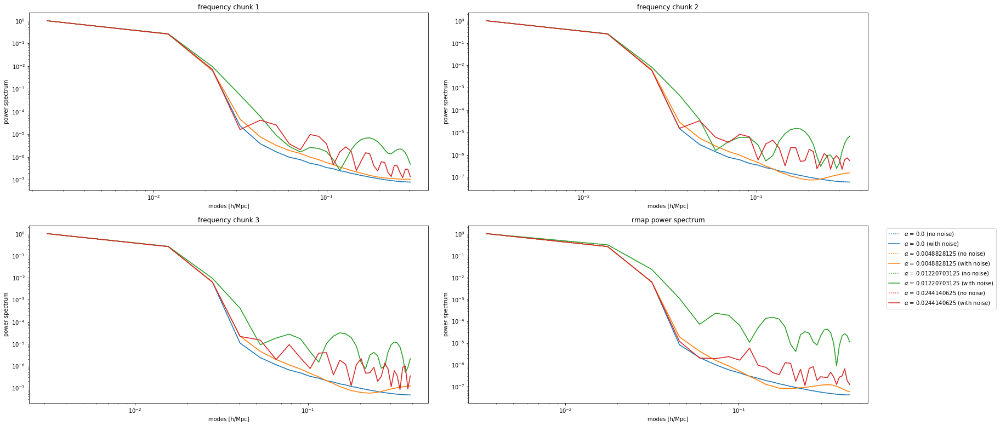

In [12]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


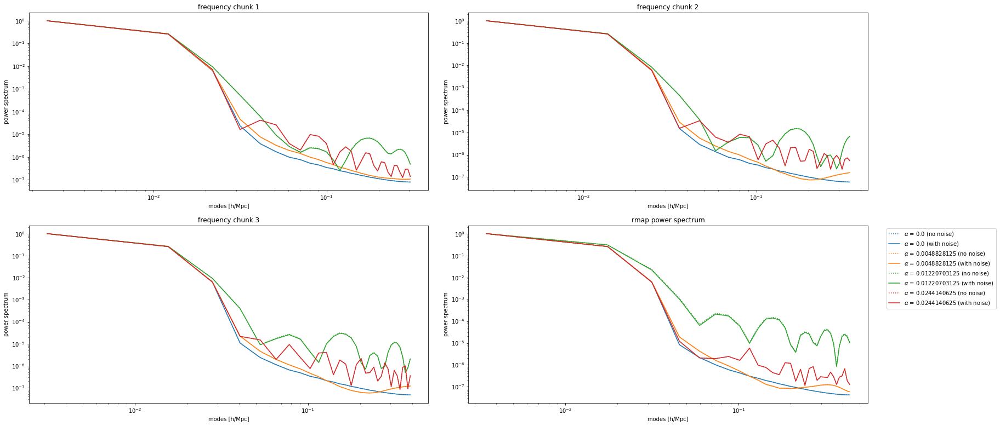

In [13]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


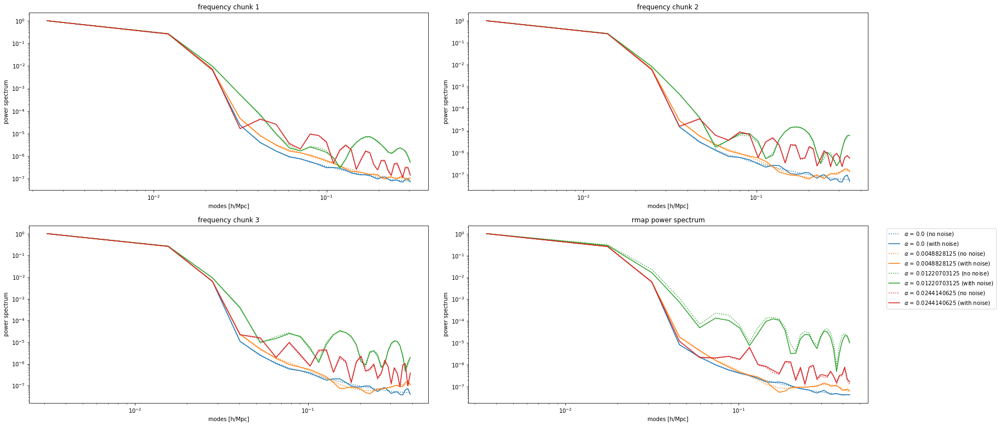

In [14]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 32 dishes, Npix_fft is 4096.

In [15]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=32, DDish=6, Npix_fft=2**12, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [16]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


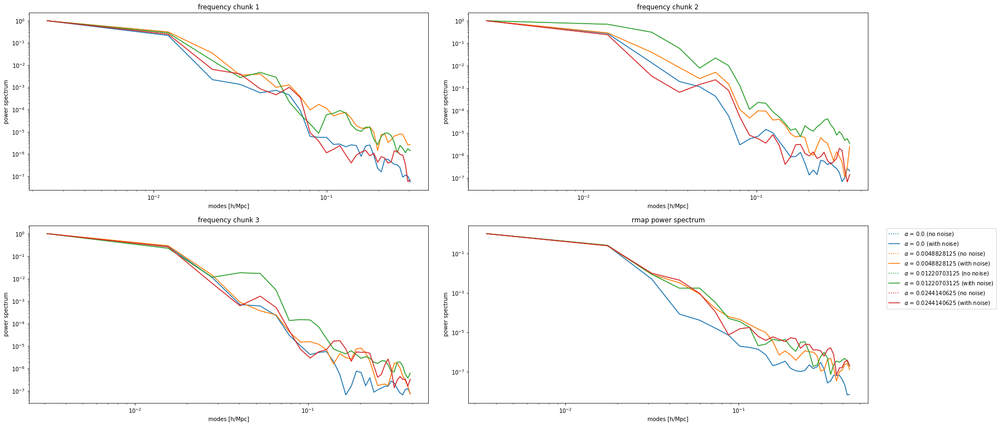

In [17]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


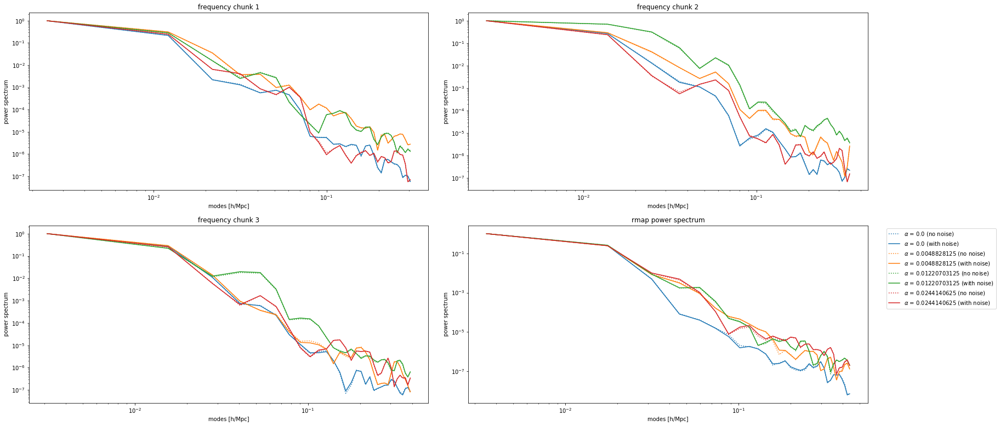

In [18]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


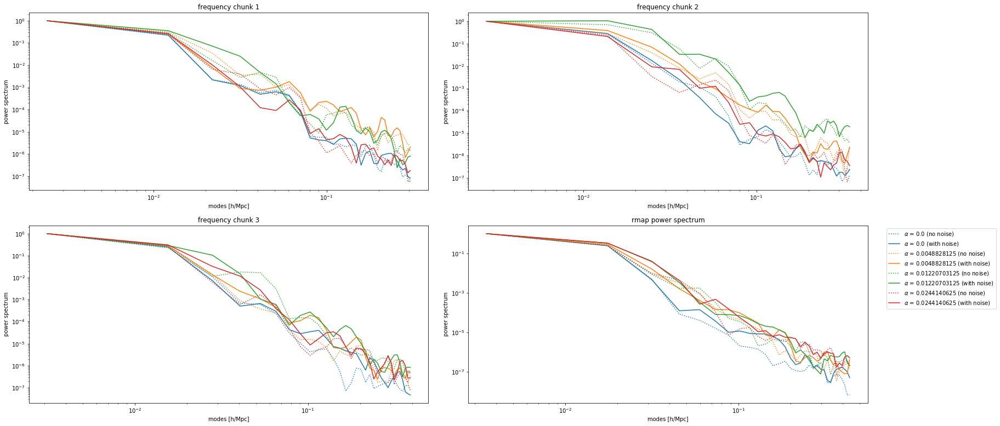

In [19]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [20]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


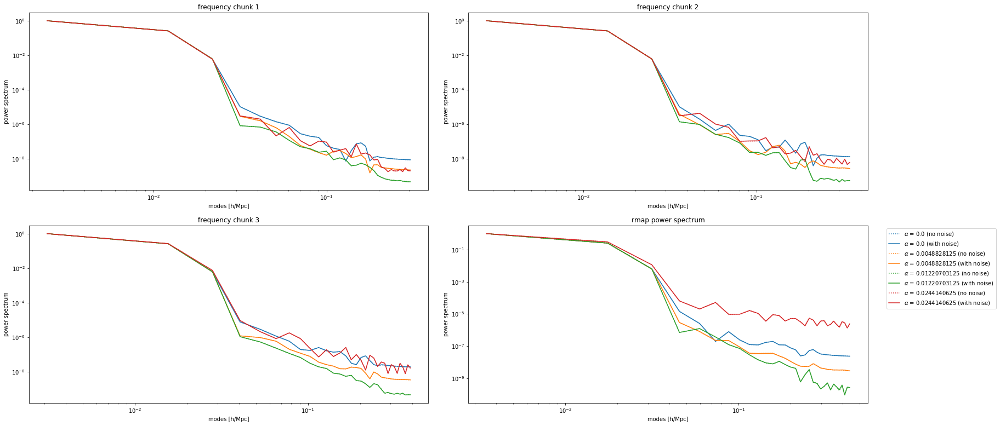

In [21]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


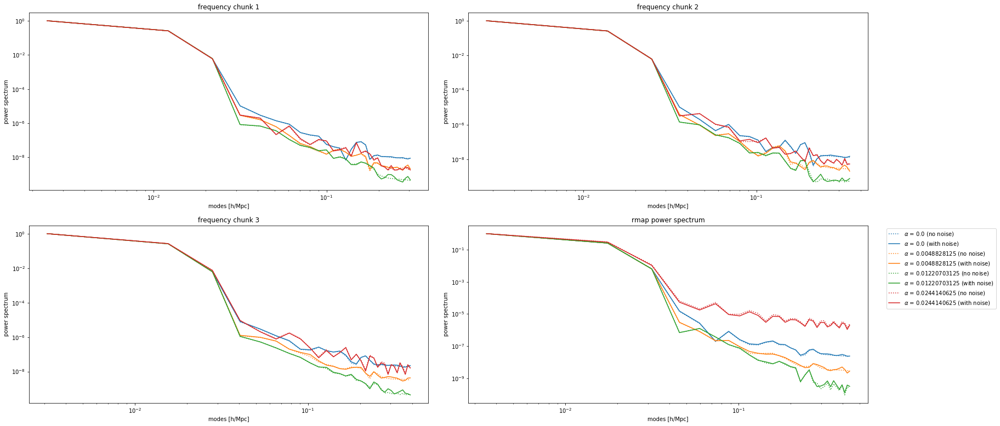

In [22]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


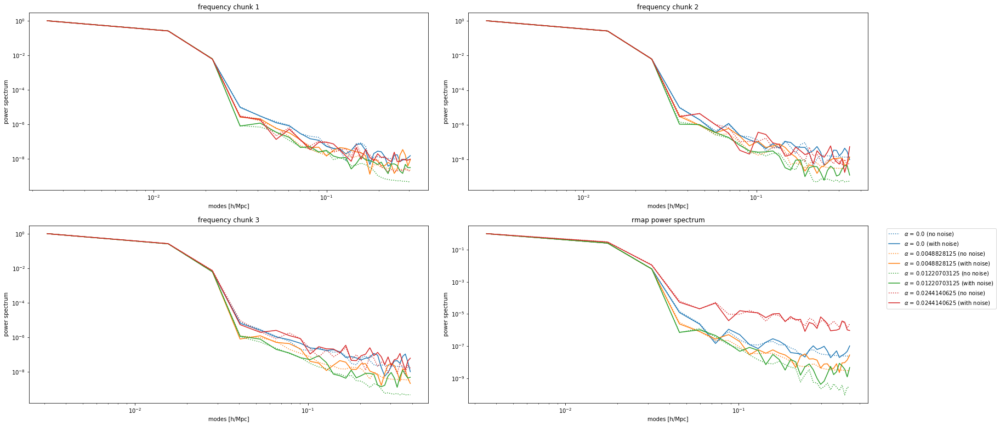

In [23]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [24]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


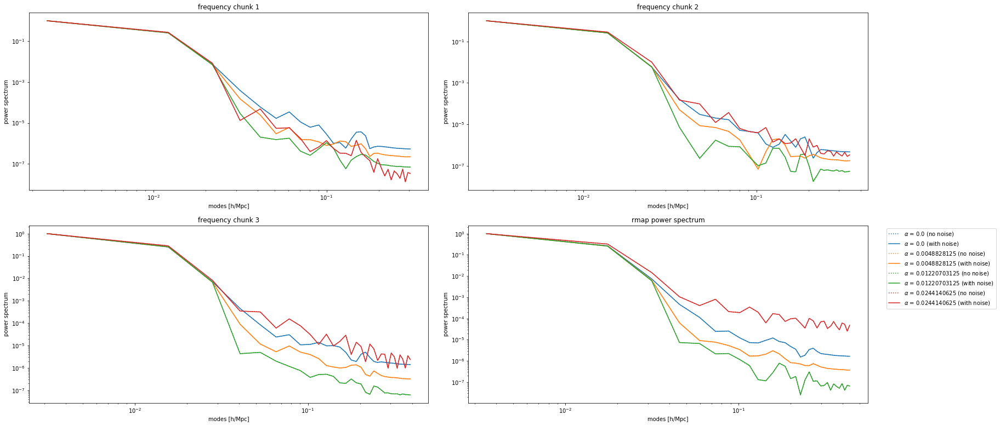

In [25]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


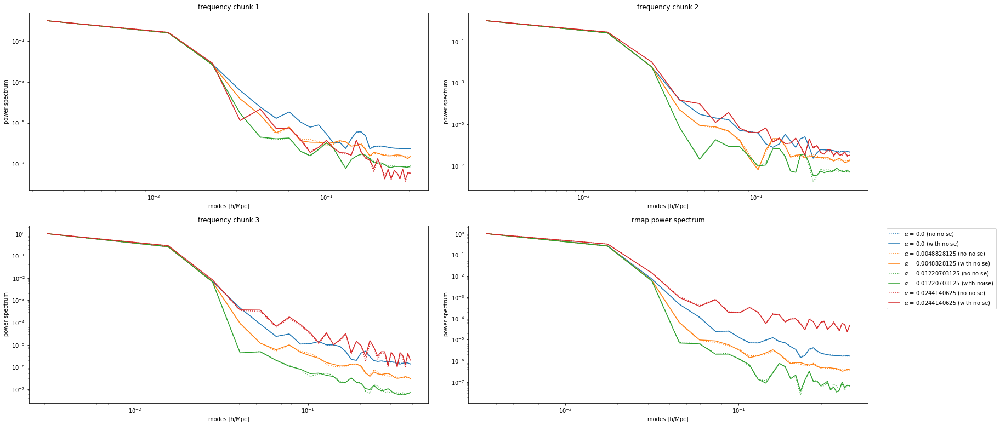

In [26]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


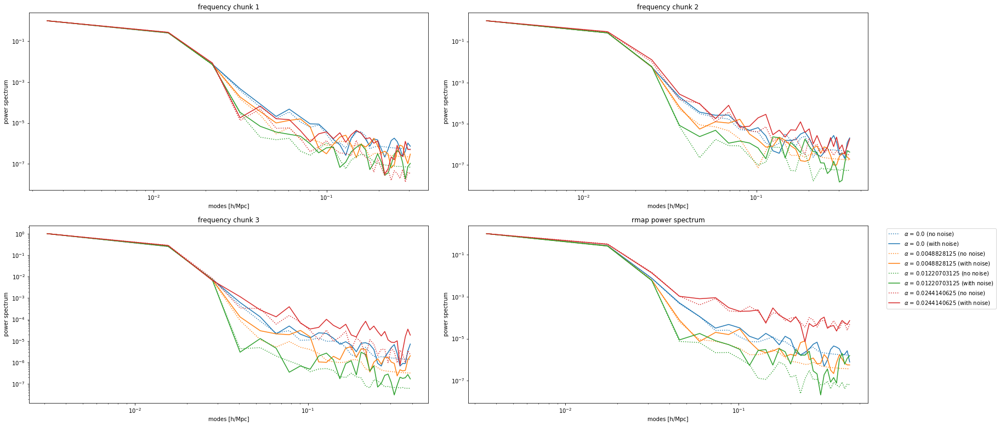

In [27]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Redundant array with 64 dishes, Npix_fft is 4096.

In [28]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=64, DDish=6, Npix_fft=2**12, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky.

In [29]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


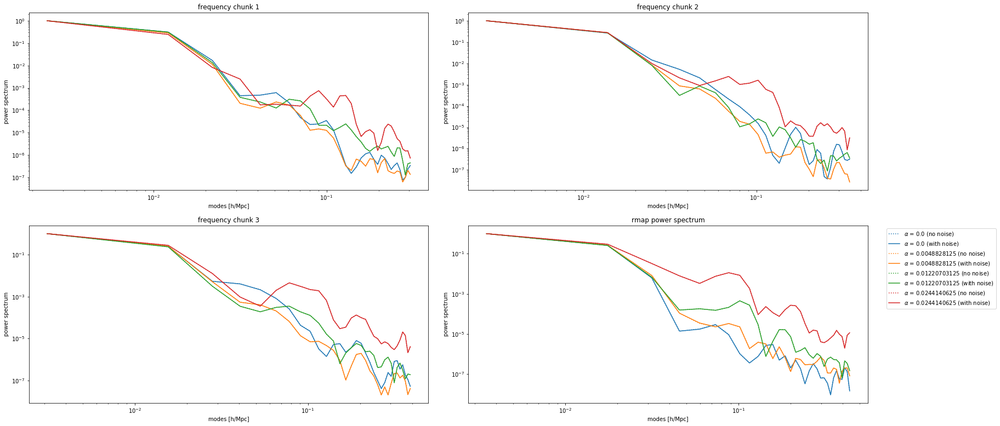

In [30]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


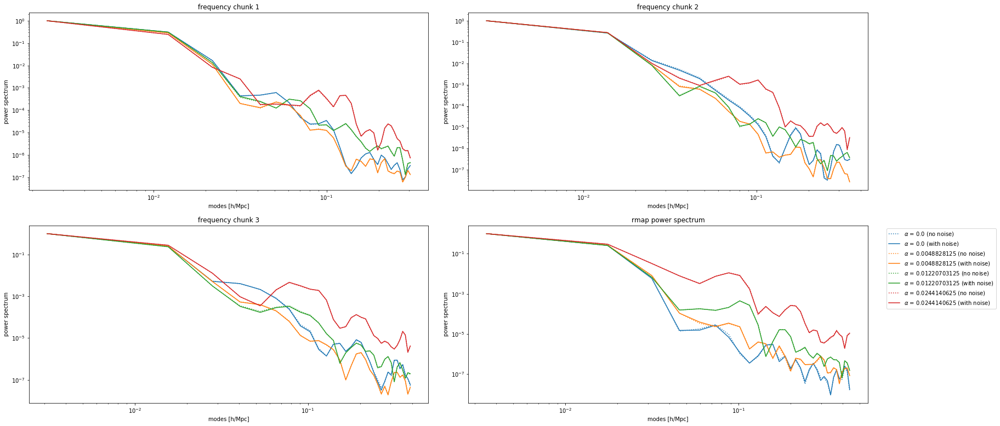

In [31]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


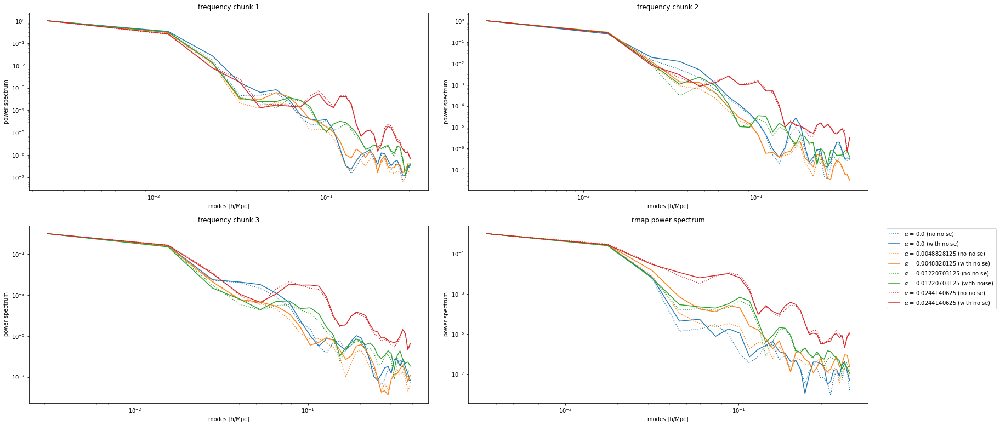

In [32]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [33]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


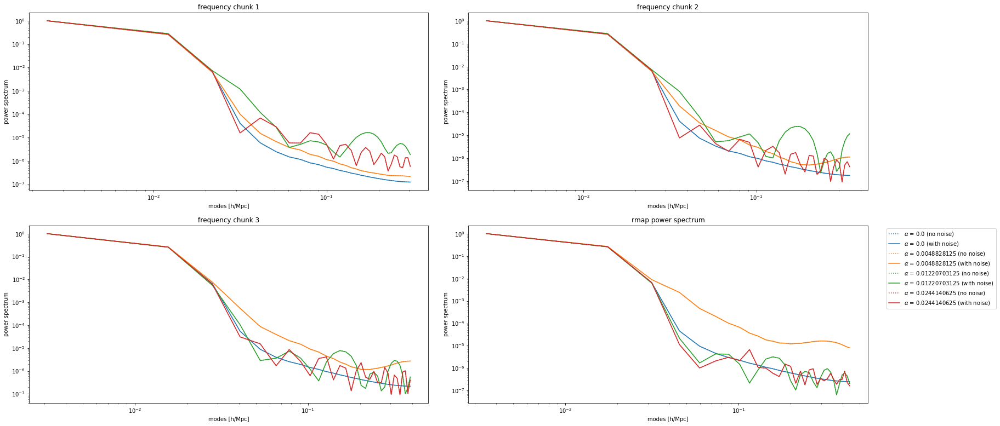

In [34]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


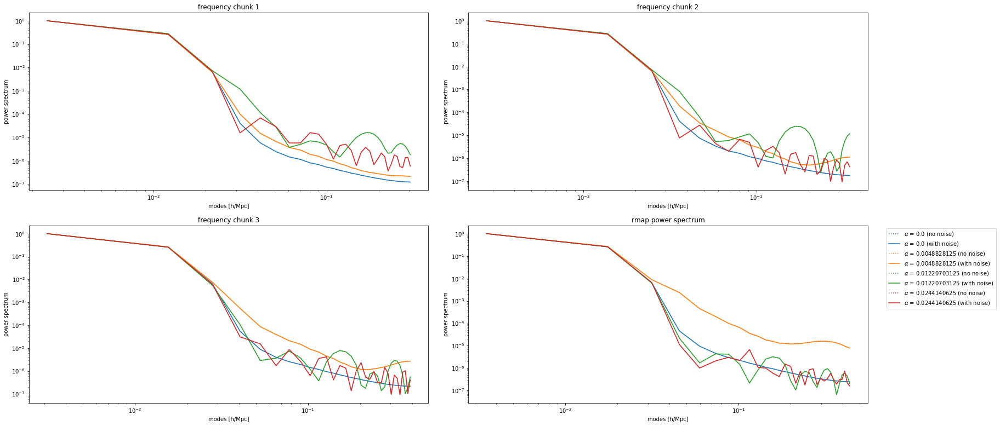

In [35]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


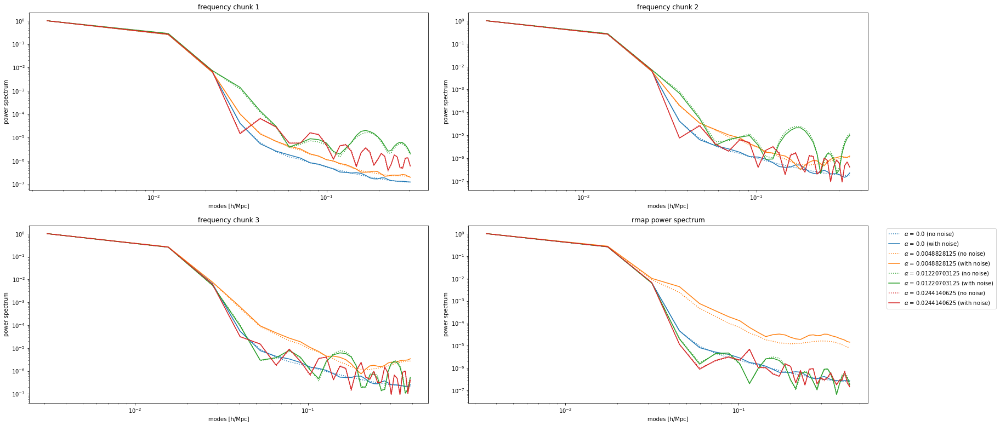

In [36]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [37]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


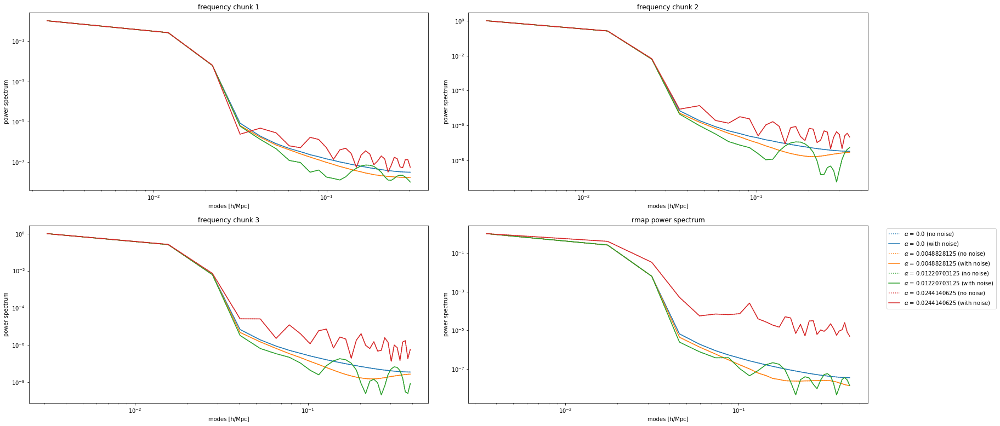

In [38]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


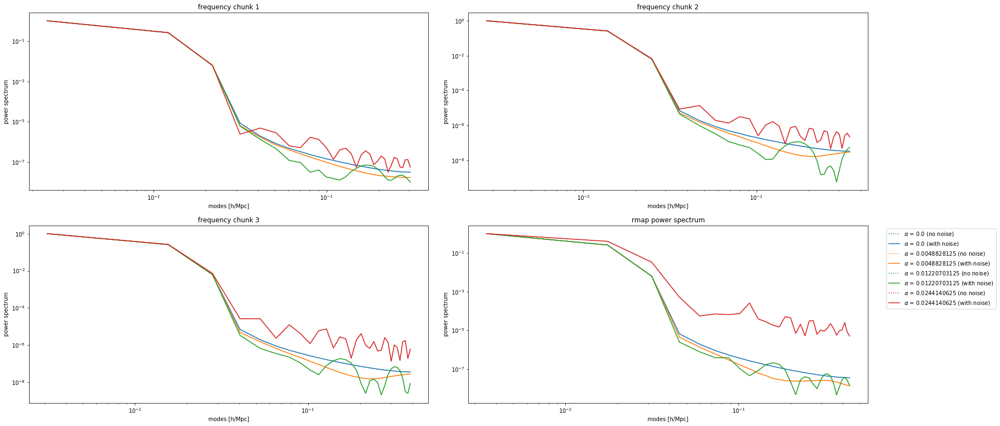

In [39]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


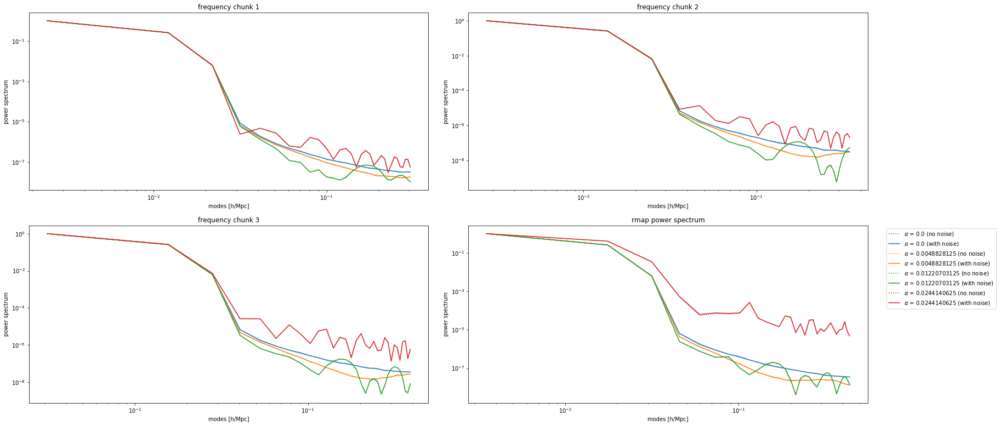

In [40]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 64 dishes, Npix_fft is 4096.

In [41]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=64, DDish=6, Npix_fft=2**12, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [42]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


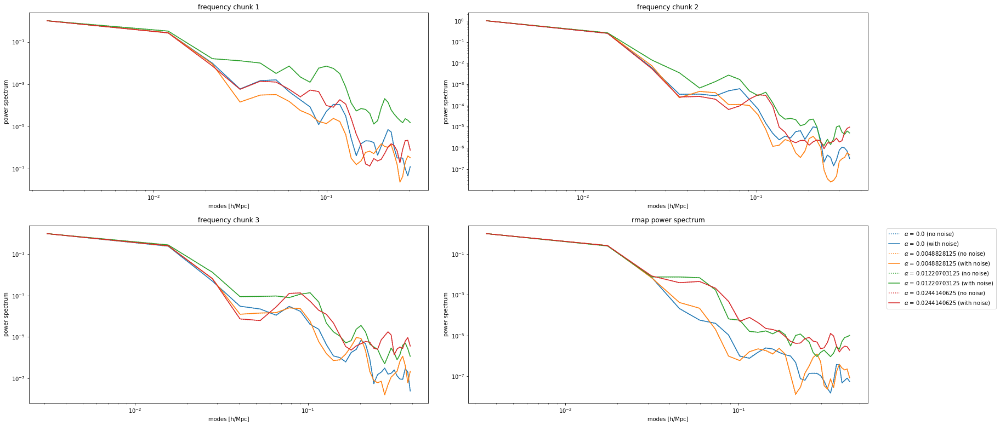

In [43]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


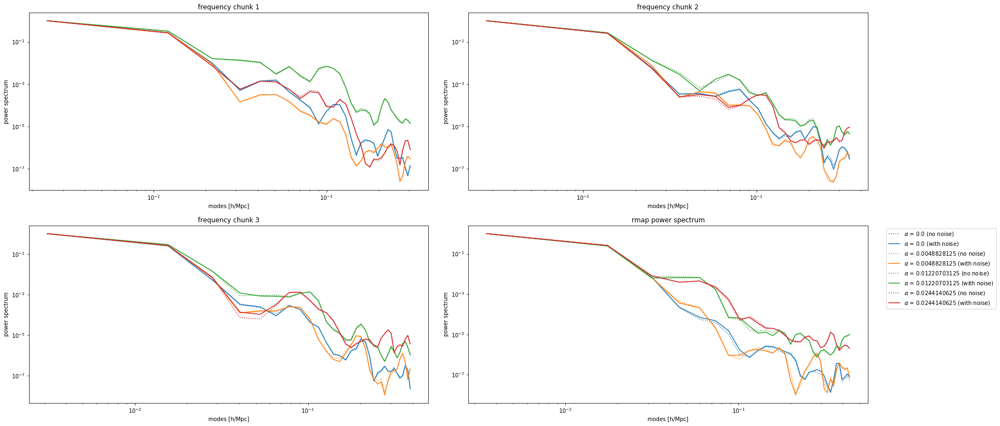

In [44]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


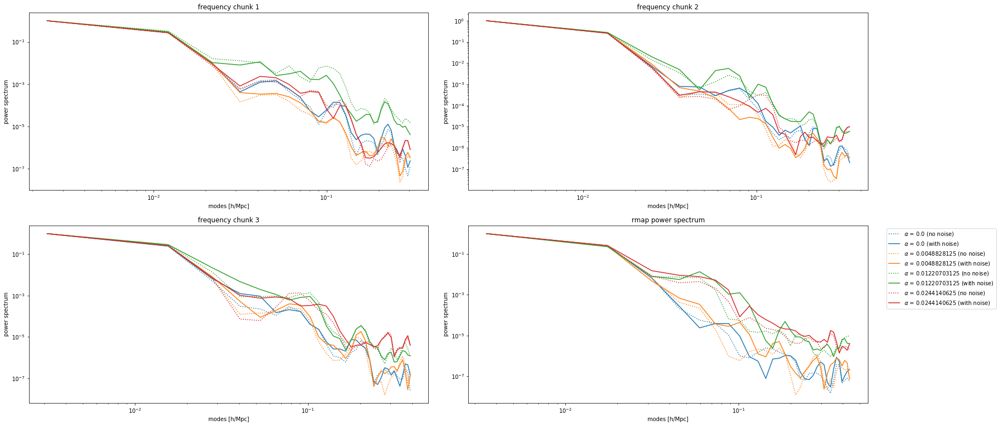

In [45]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [46]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


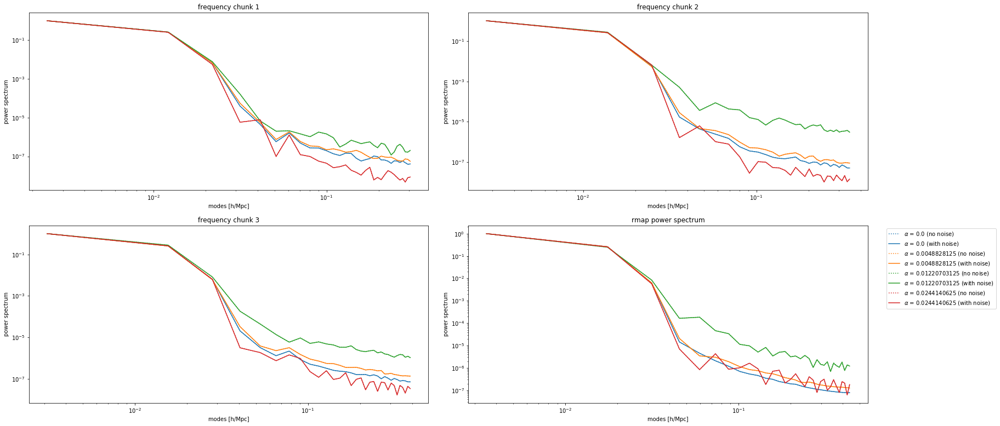

In [47]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


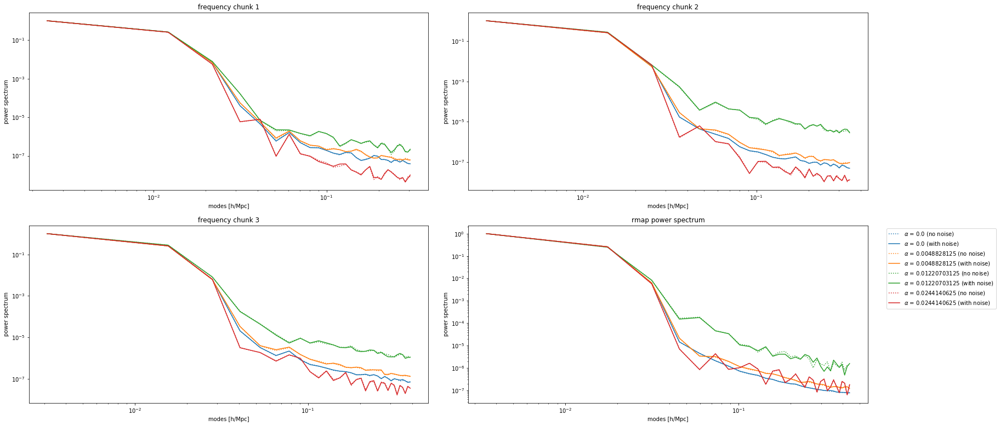

In [48]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


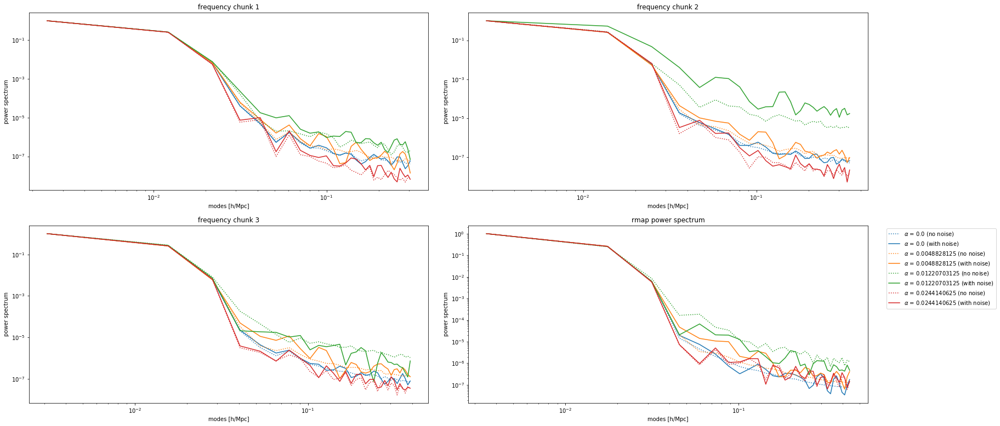

In [49]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [50]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


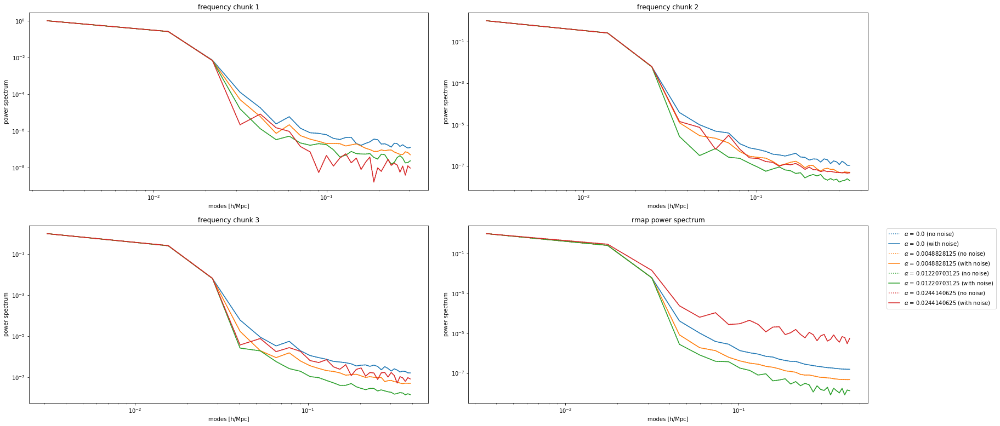

In [51]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


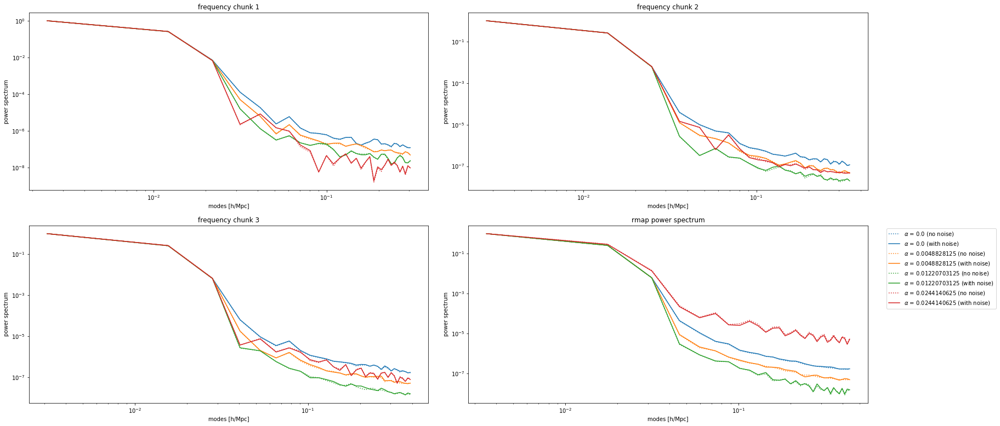

In [52]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


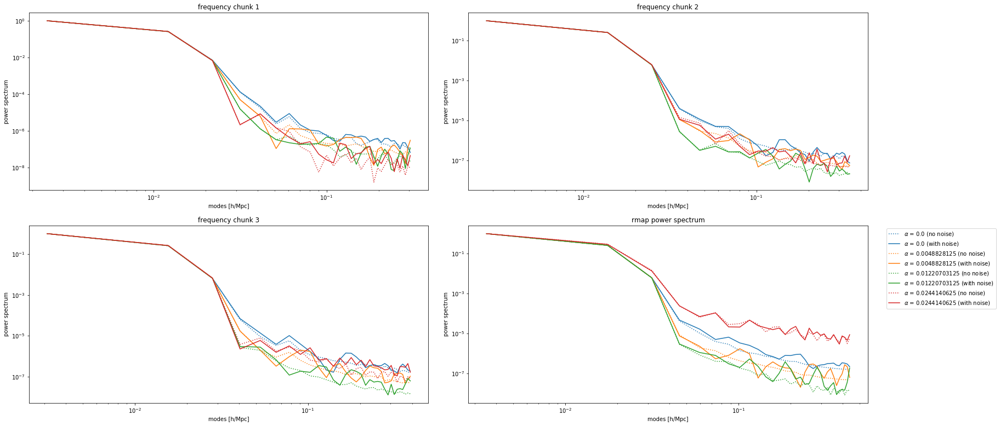

In [53]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Redundant array with 128 dishes, Npix_fft is 4096.

In [54]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=128, DDish=6, Npix_fft=2**12, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky.

In [55]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


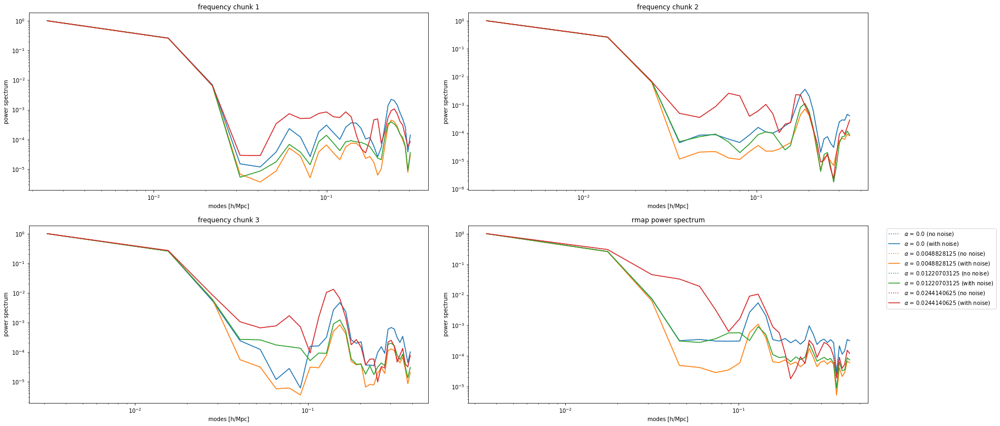

In [56]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


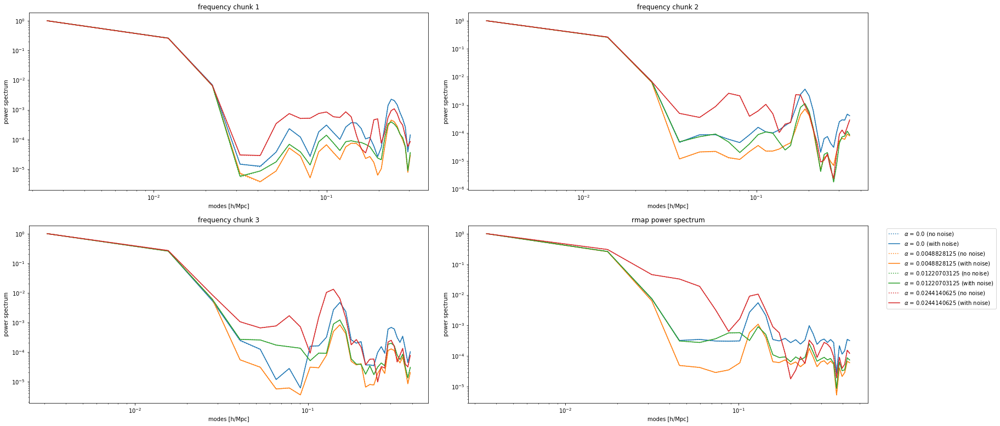

In [57]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


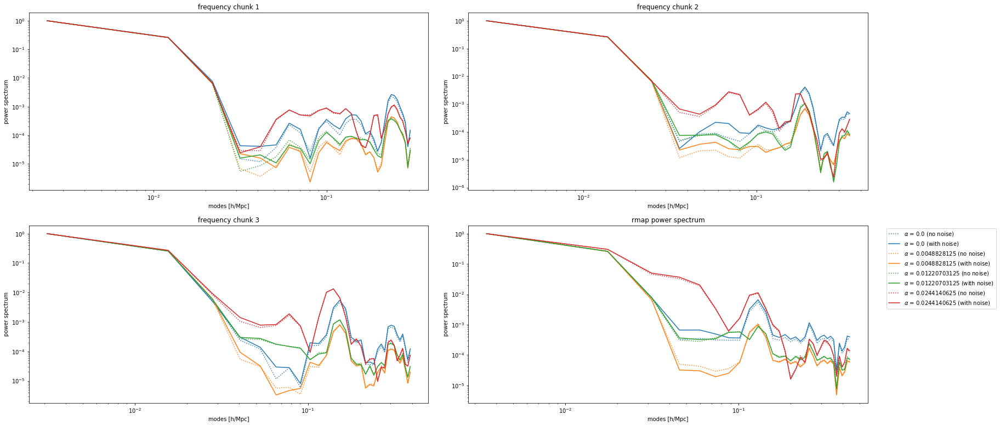

In [58]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [59]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


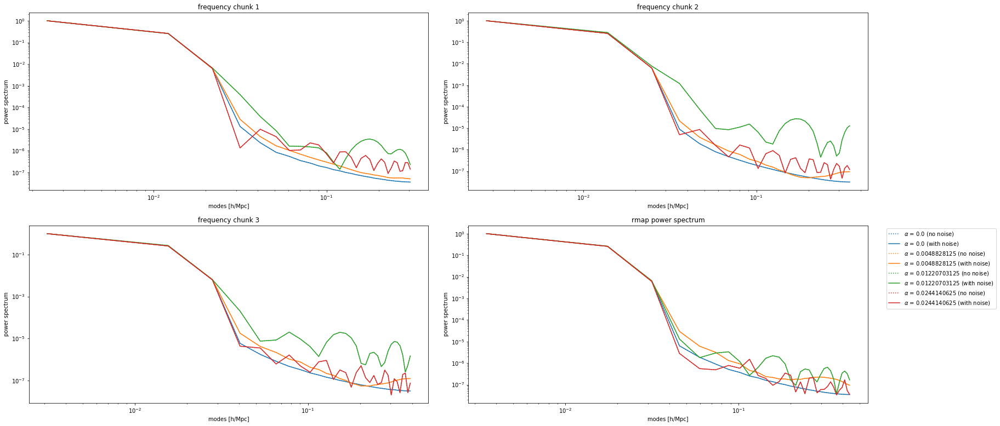

In [60]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


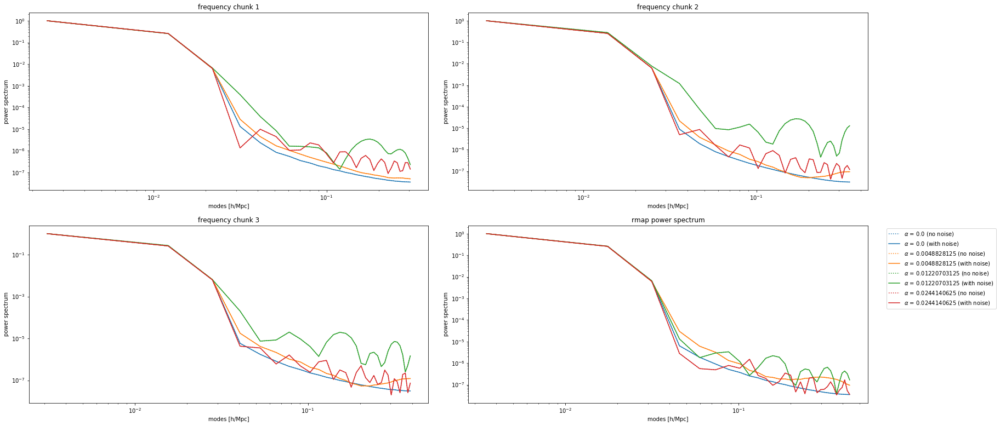

In [61]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


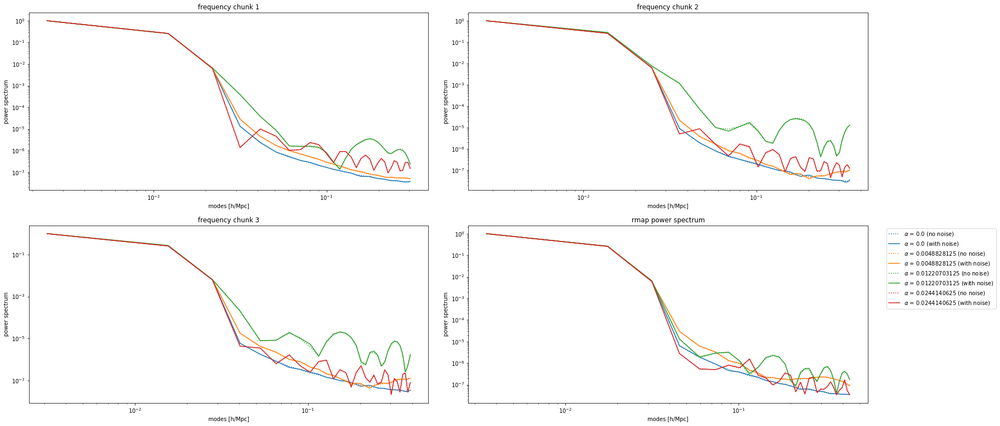

In [62]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [63]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


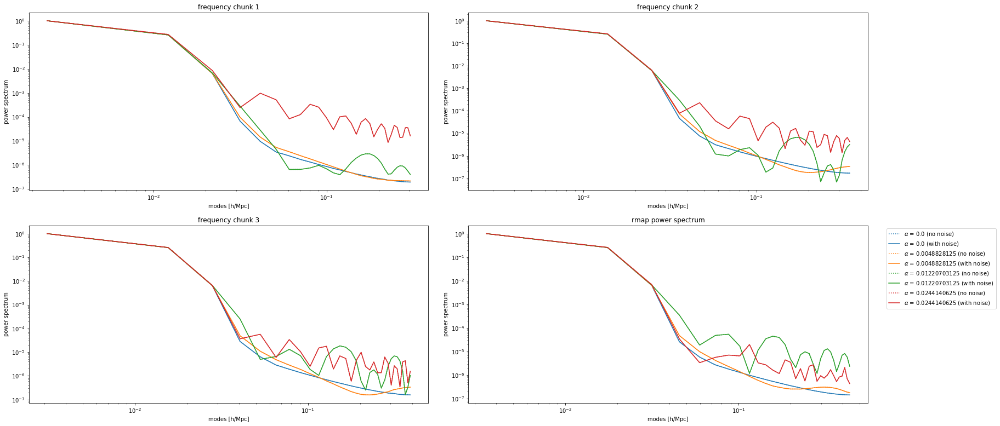

In [64]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


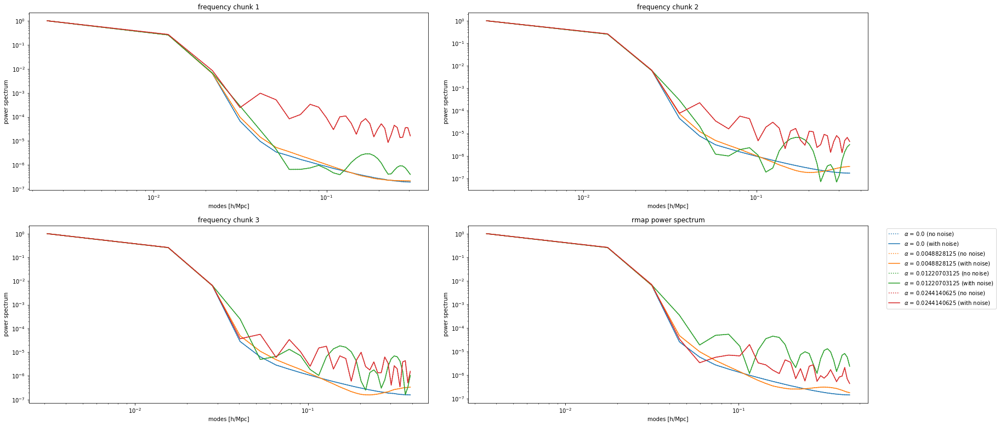

In [65]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


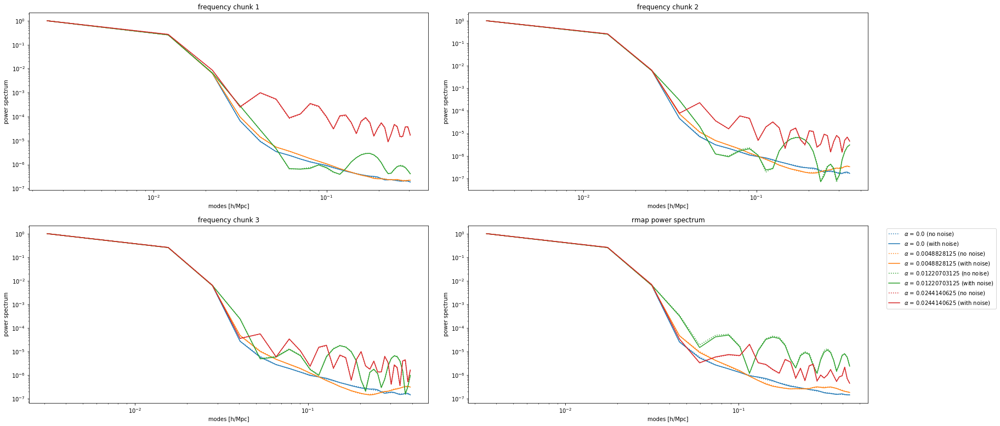

In [66]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 128 dishes, Npix_fft is 4096.

In [67]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=128, DDish=6, Npix_fft=2**12, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [68]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


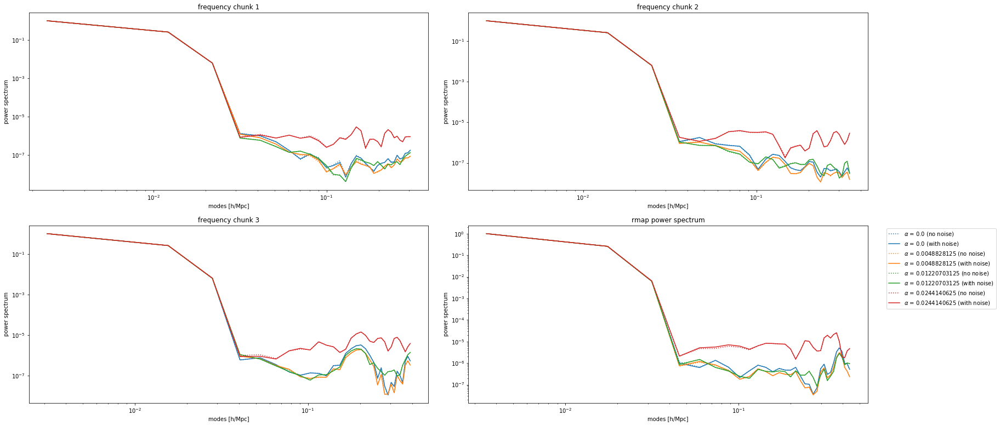

In [69]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


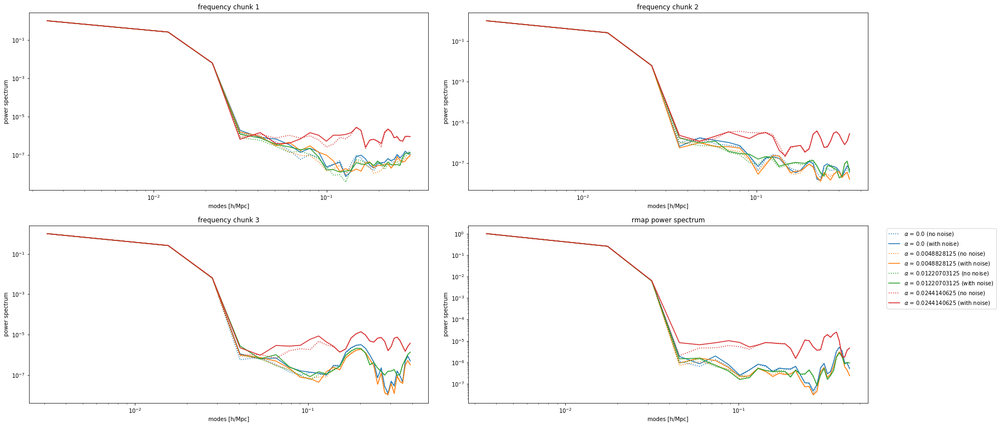

In [70]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


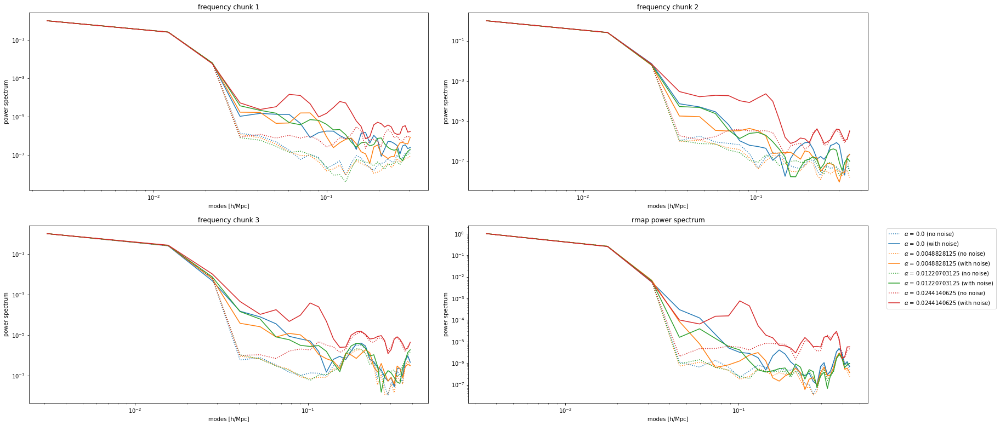

In [71]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [72]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


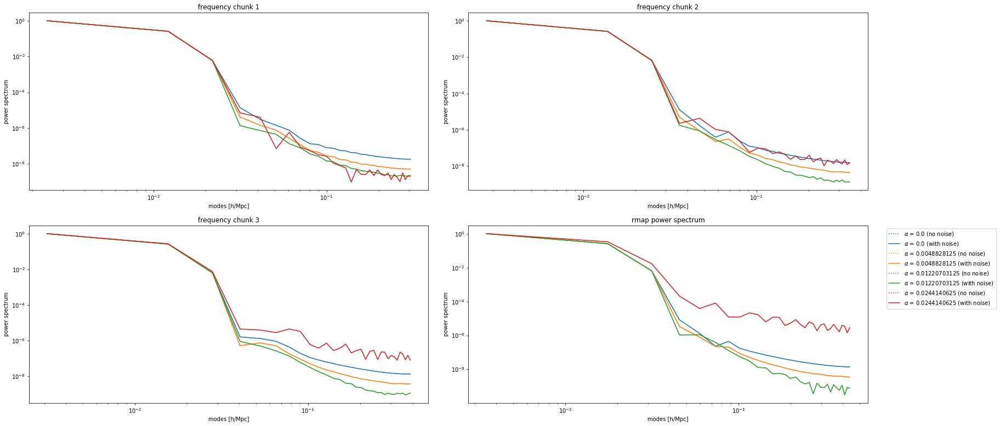

In [73]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


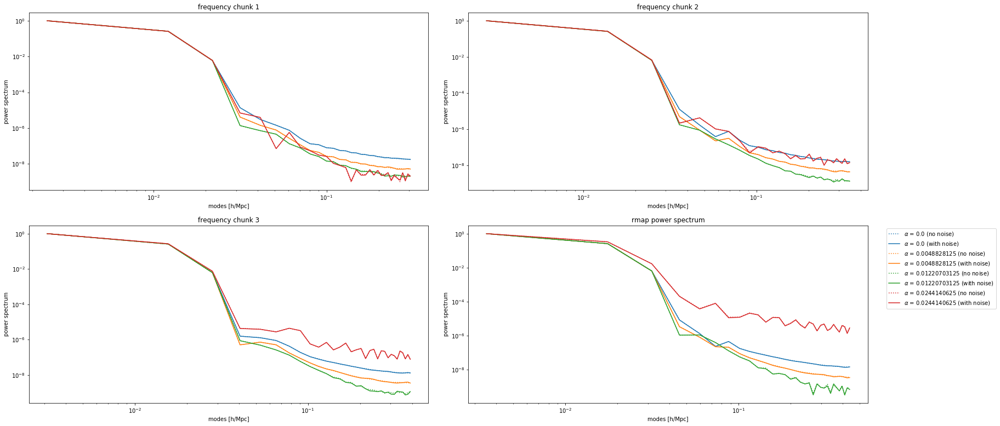

In [74]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


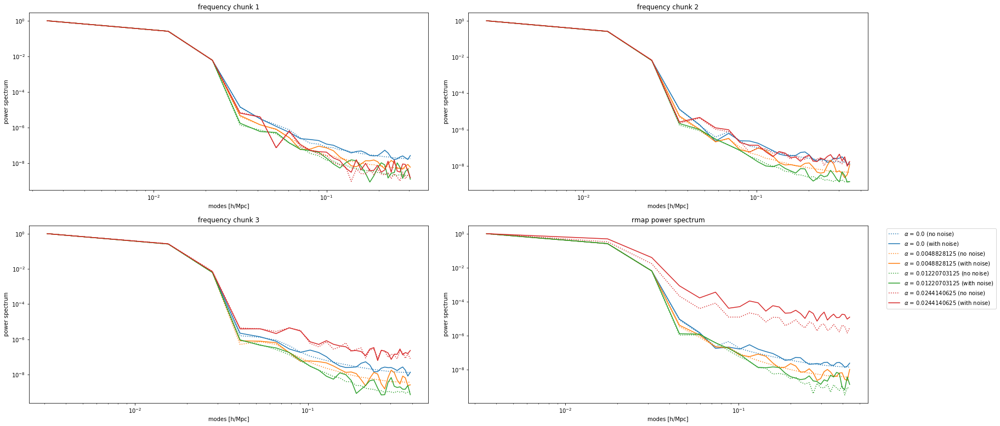

In [75]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [76]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


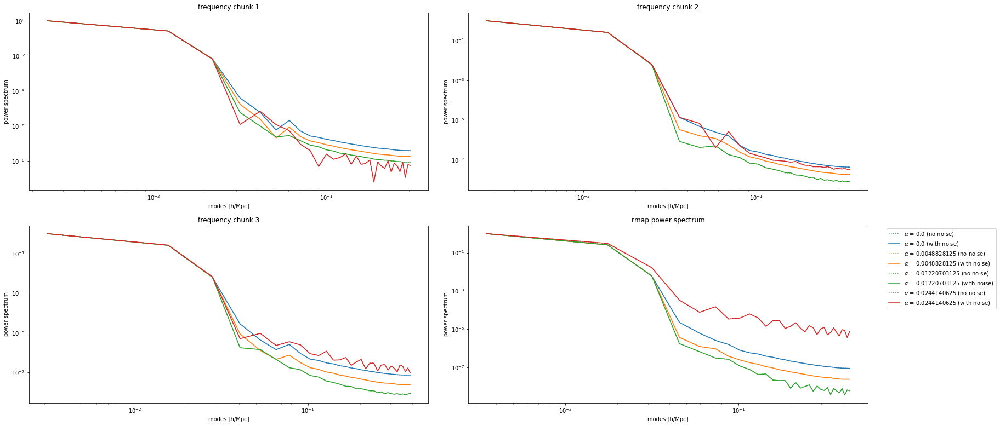

In [77]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


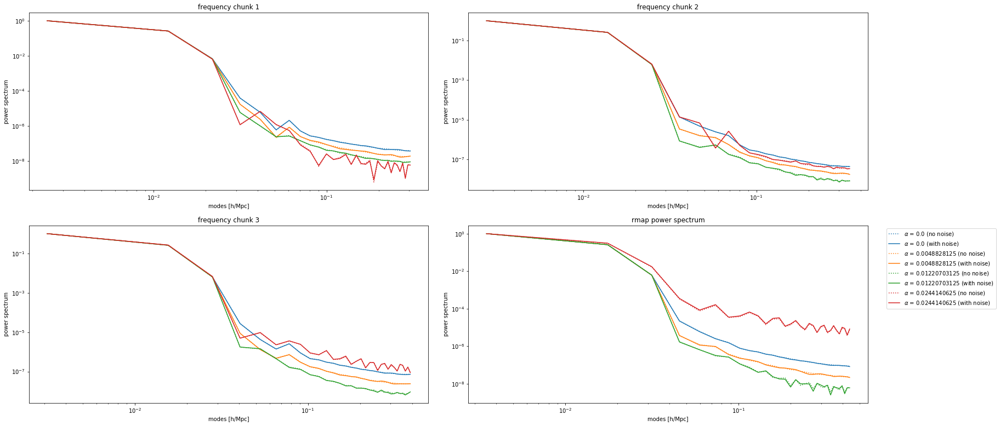

In [78]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


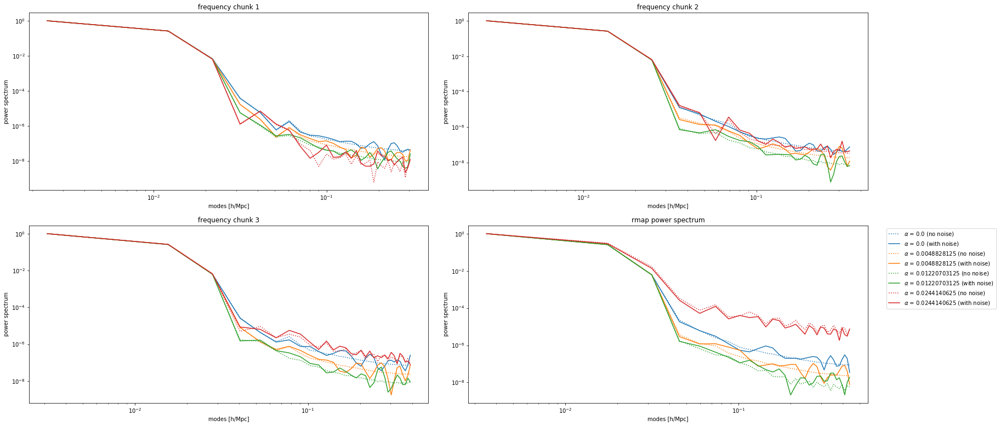

In [79]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Redundant array with 32 dishes, Npix_fft is 2048.

In [80]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=32, DDish=6, Npix_fft=2**11, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky.

In [81]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


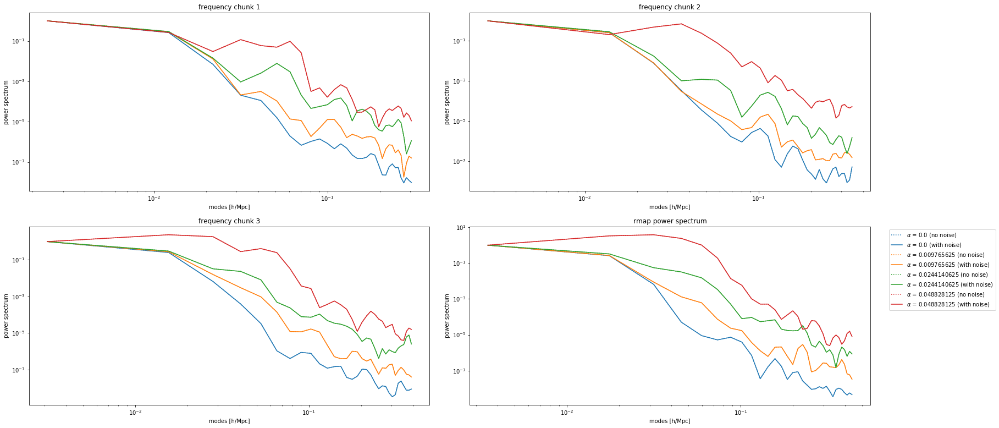

In [82]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


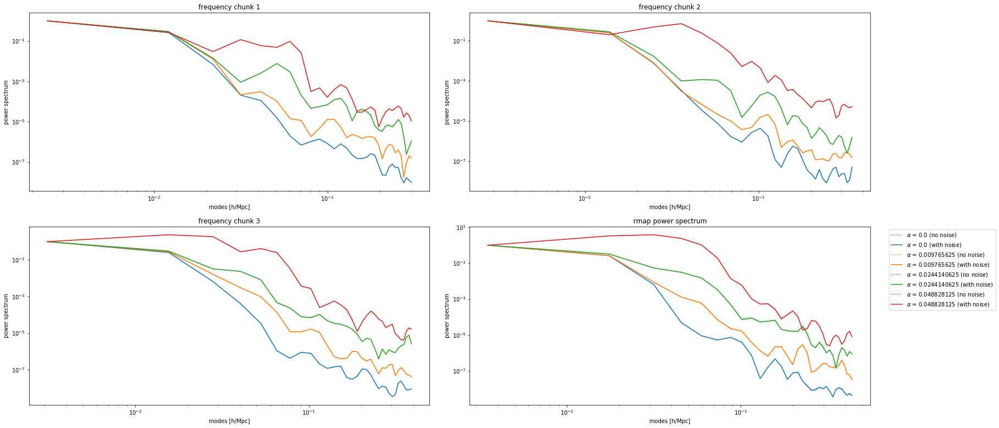

In [83]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


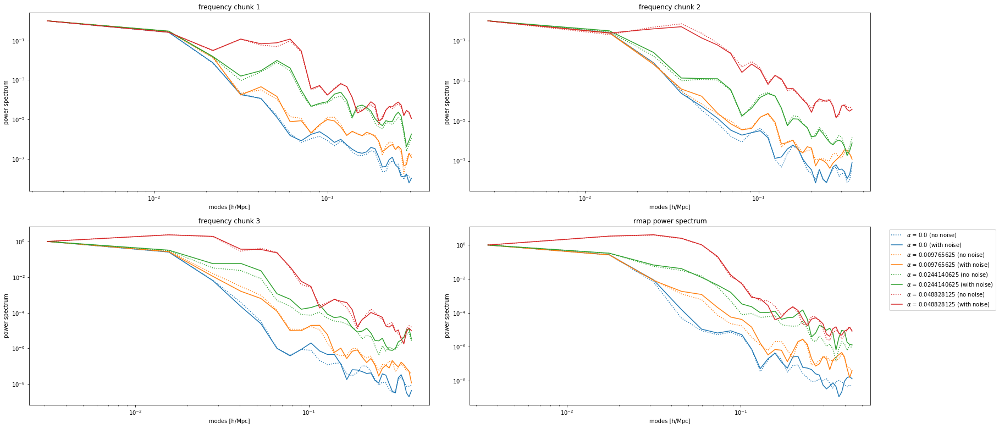

In [84]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [85]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


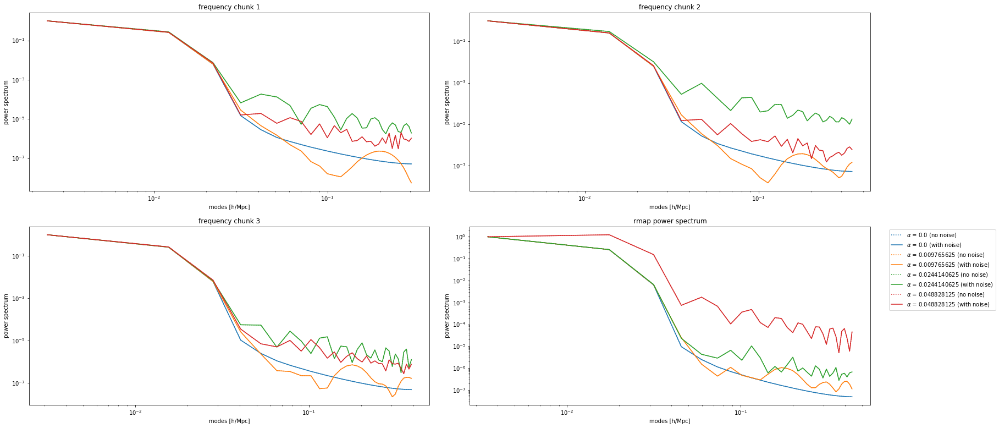

In [86]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


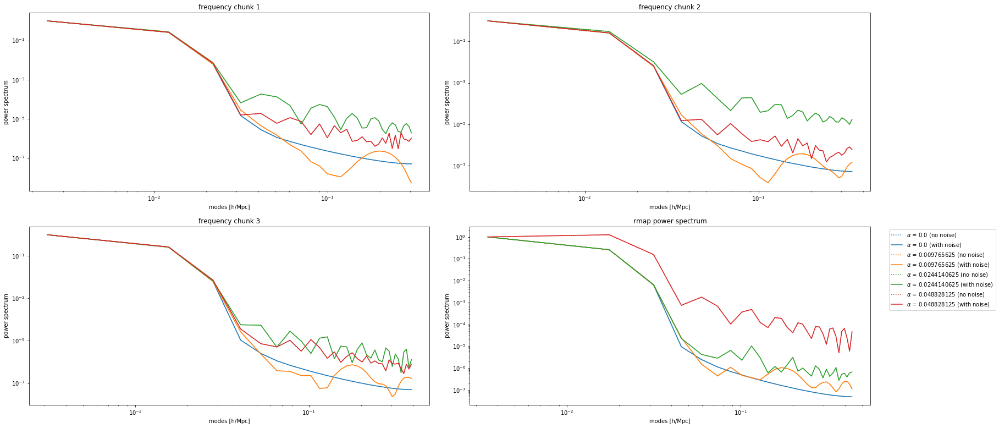

In [87]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


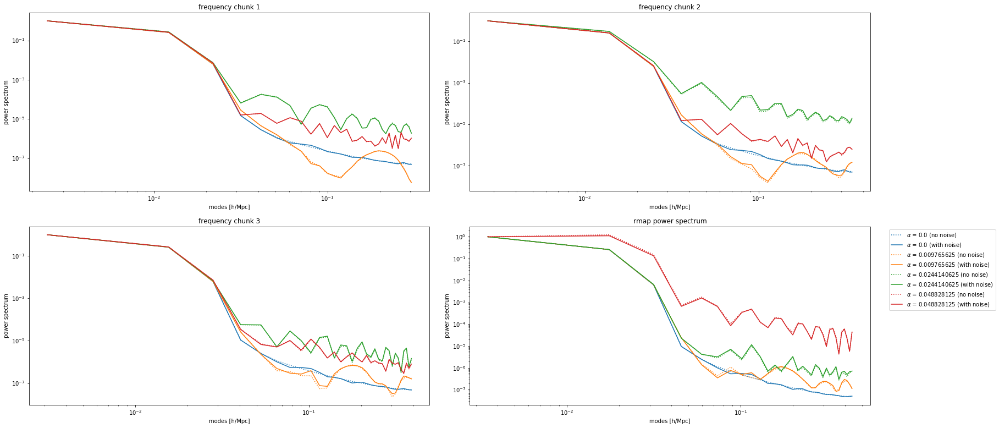

In [88]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [89]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


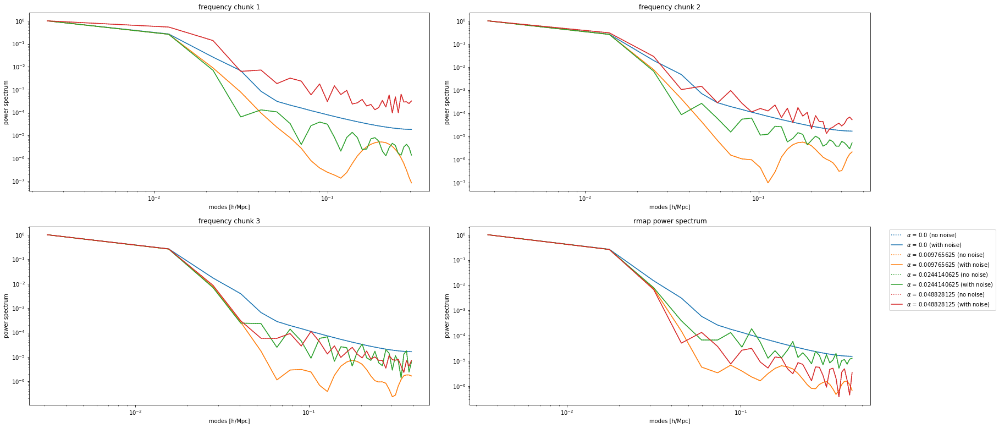

In [90]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


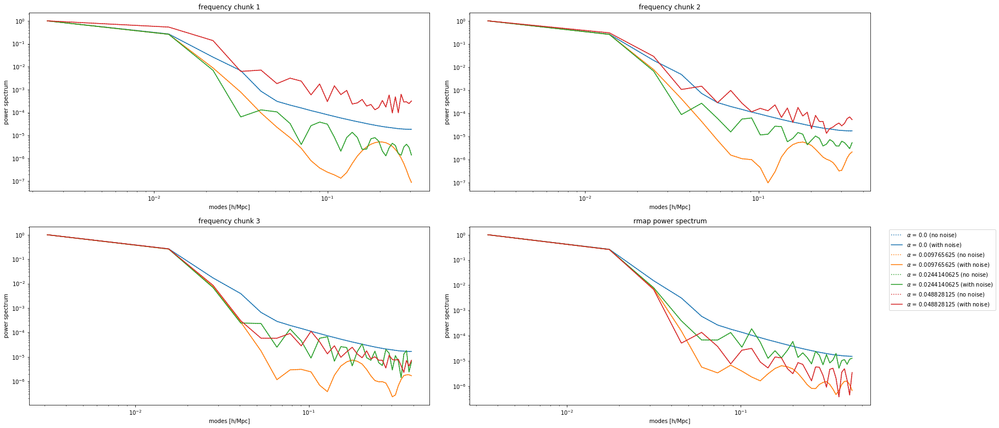

In [91]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


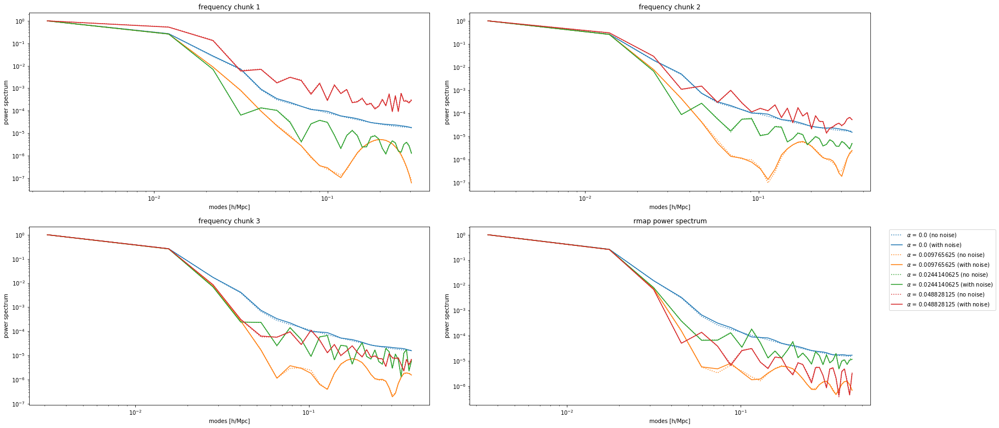

In [92]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 32 dishes, Npix_fft is 2048.

In [93]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=32, DDish=6, Npix_fft=2**11, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [94]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


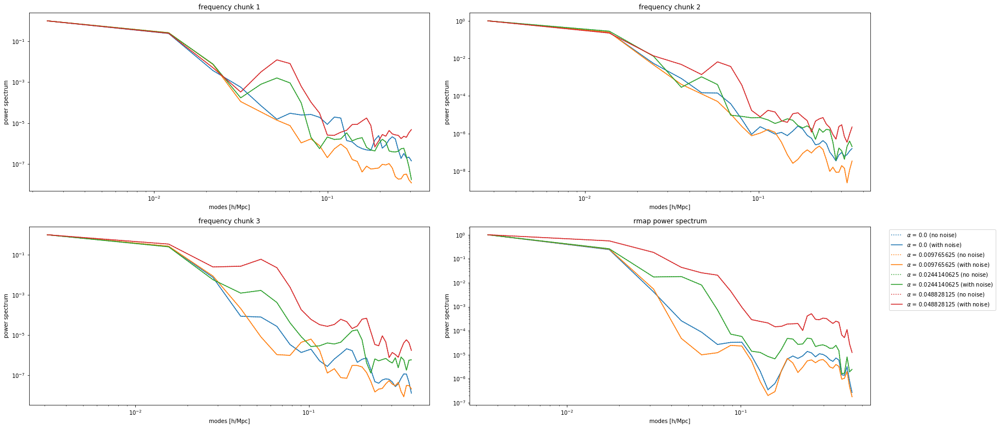

In [95]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


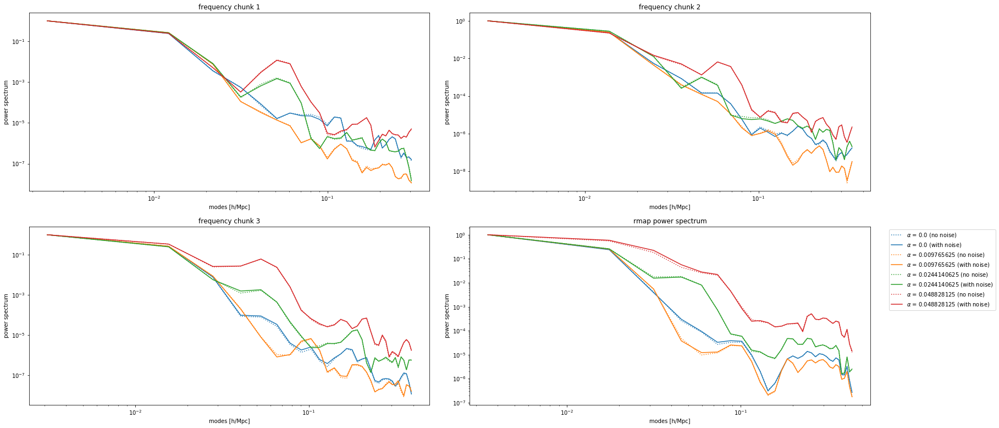

In [96]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


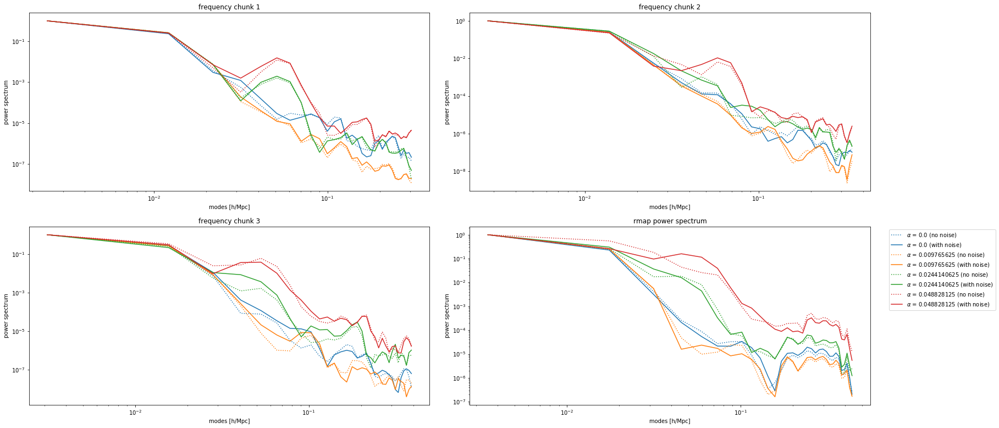

In [97]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [98]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


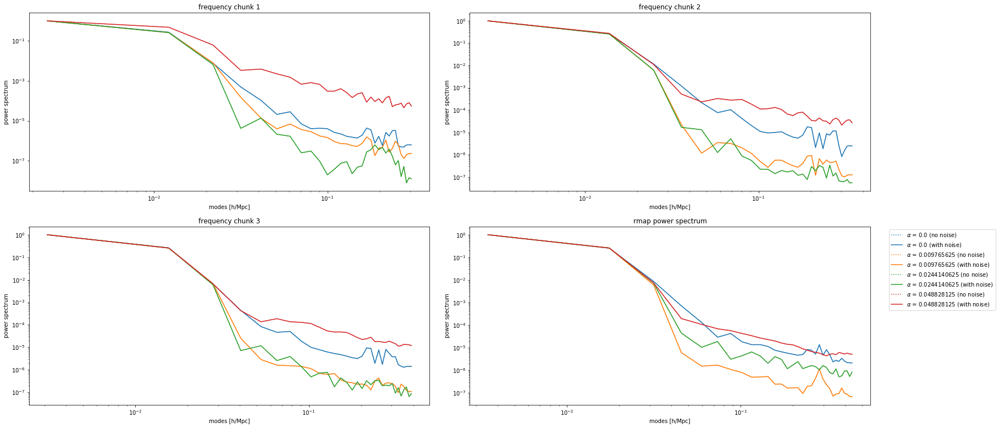

In [99]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


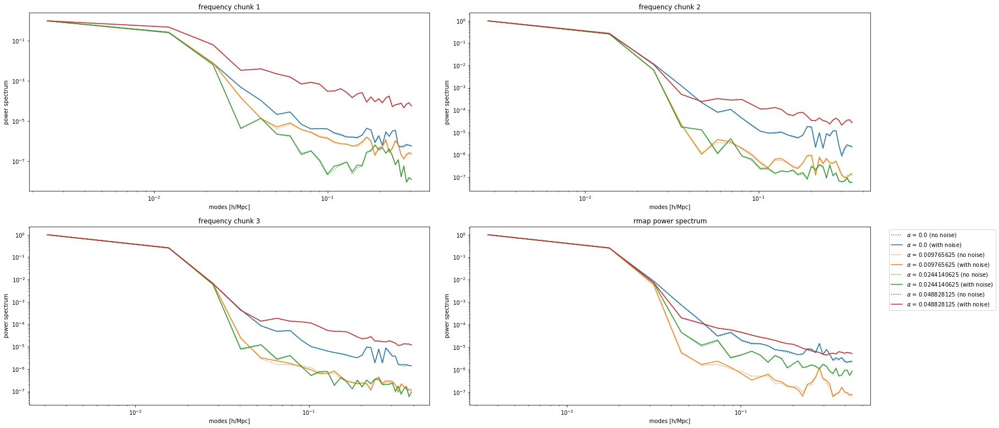

In [100]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


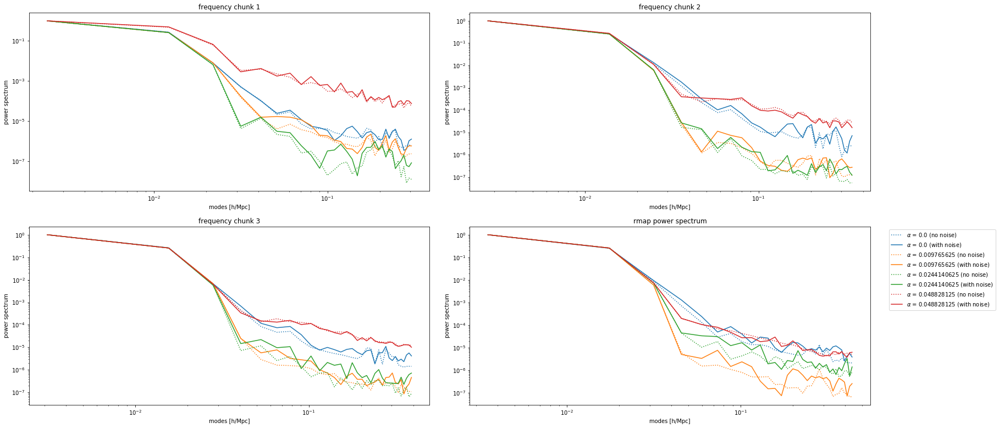

In [101]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [102]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


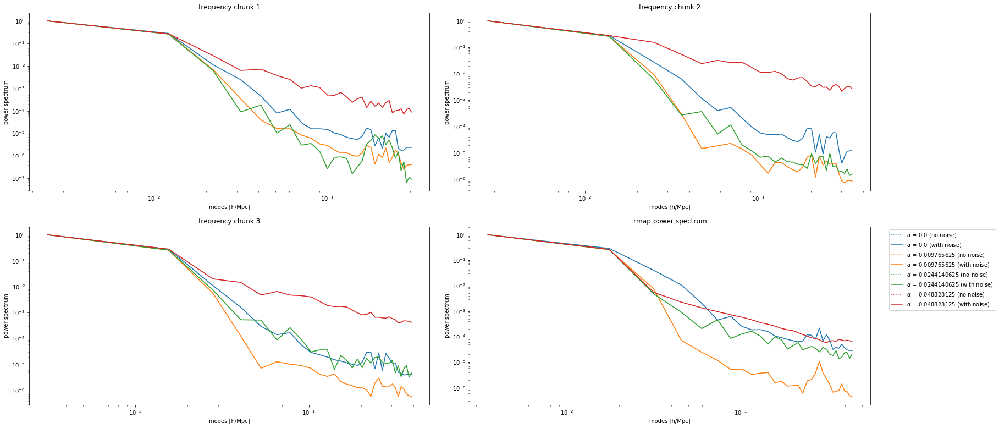

In [103]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


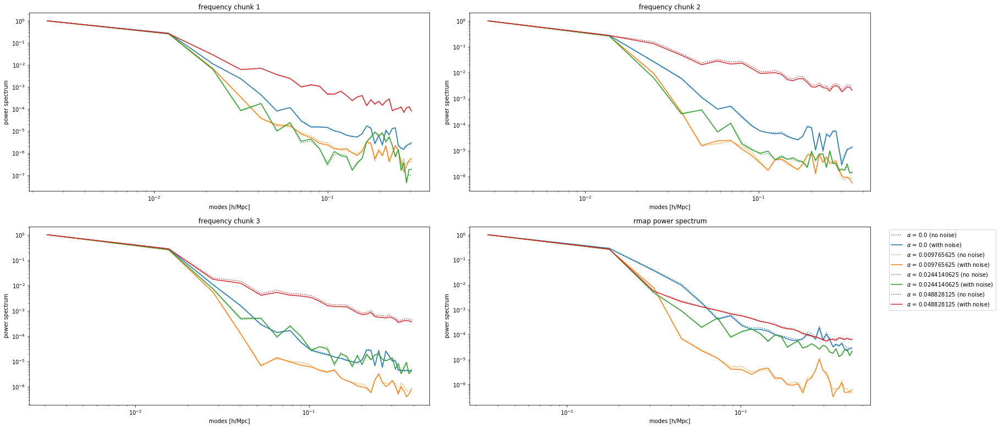

In [104]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


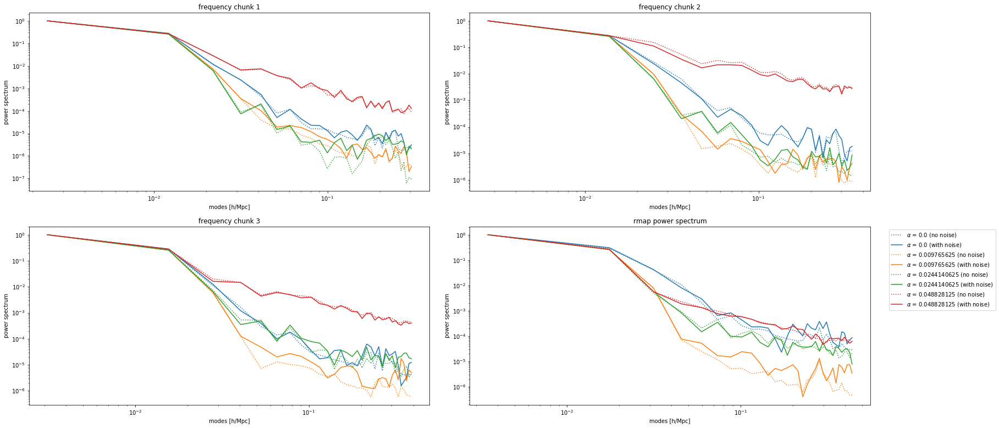

In [105]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Redundant array with 64 dishes, Npix_fft is 2048.

In [106]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=64, DDish=6, Npix_fft=2**11, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky.

In [107]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


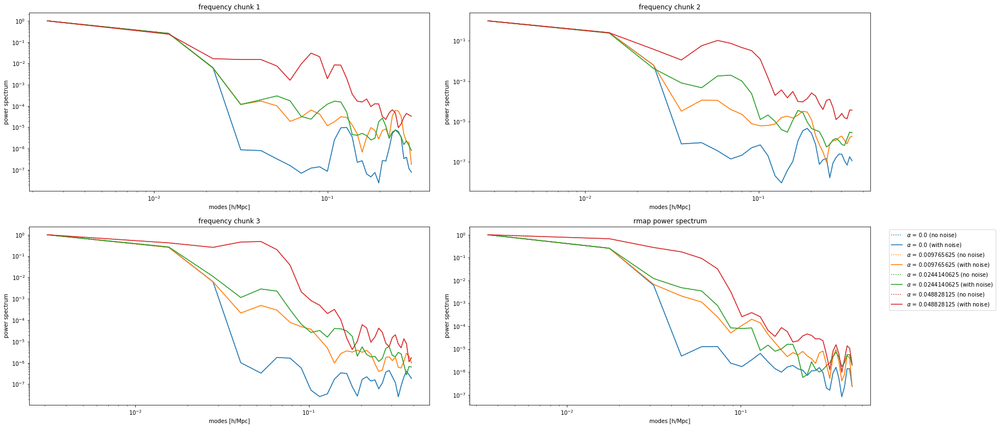

In [108]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


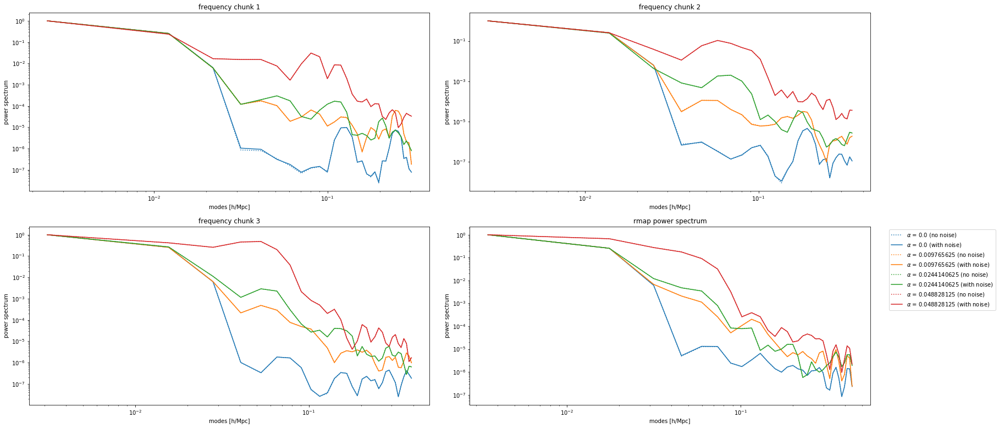

In [109]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


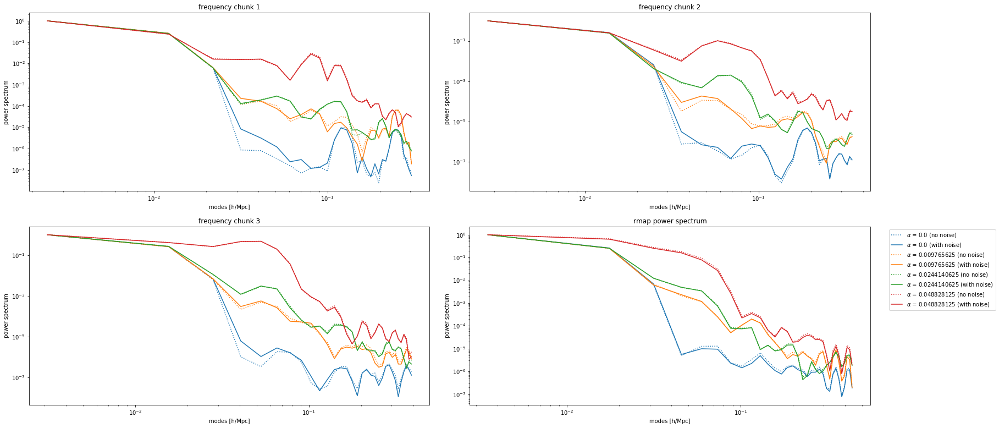

In [110]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [111]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


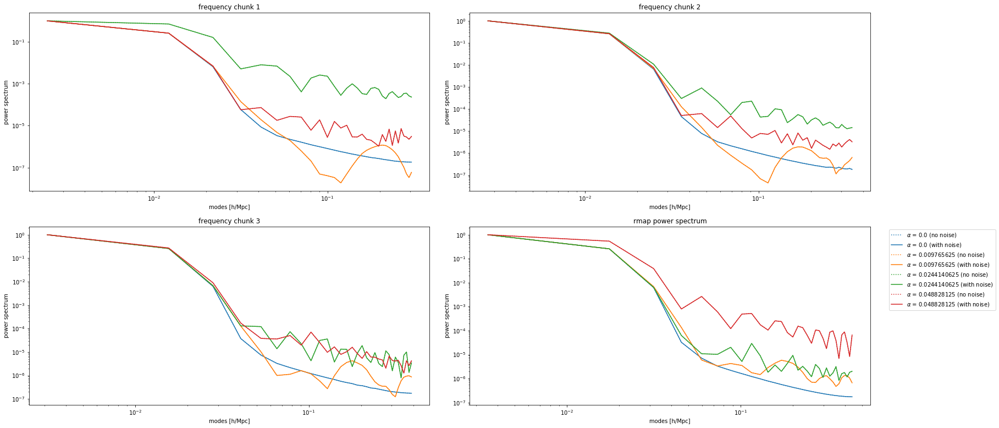

In [112]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


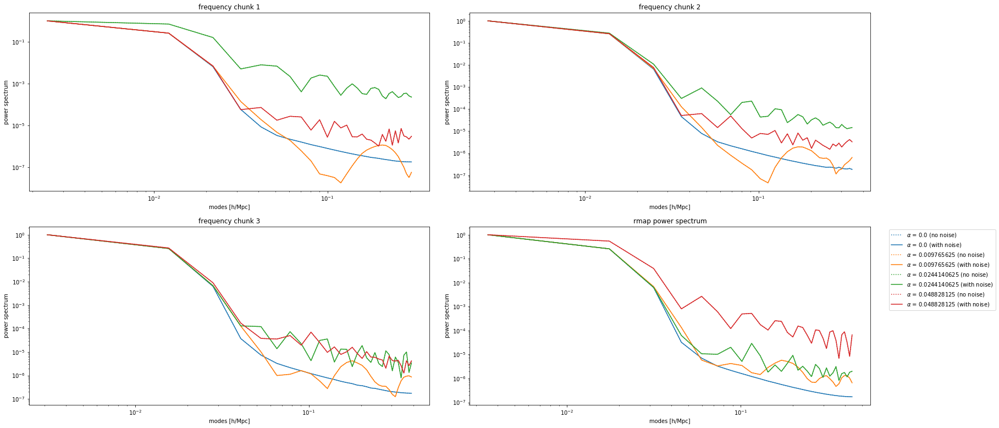

In [113]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


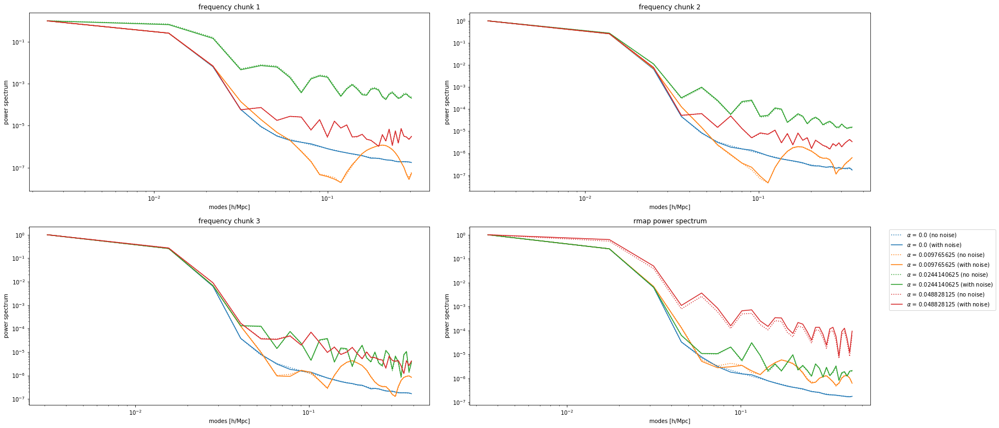

In [114]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [115]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


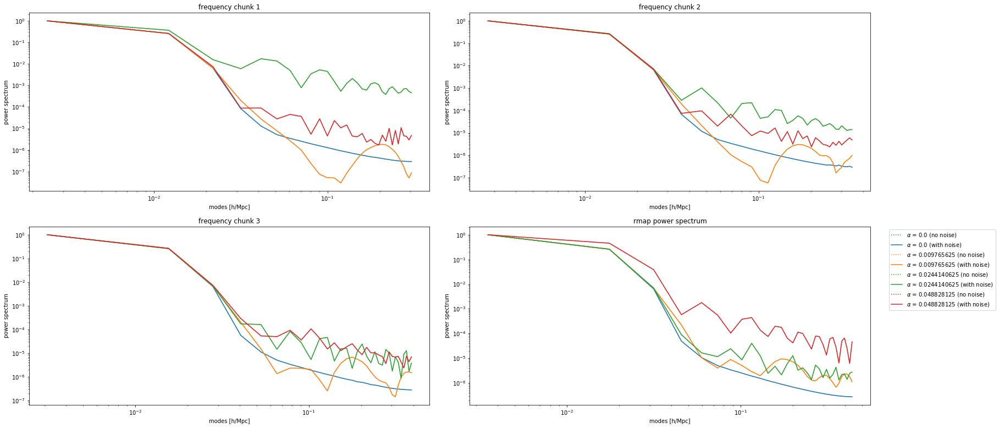

In [116]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


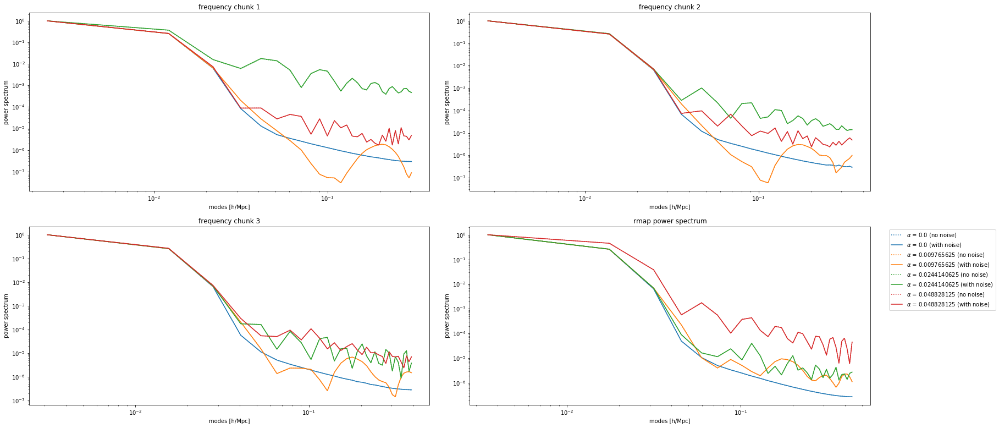

In [117]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


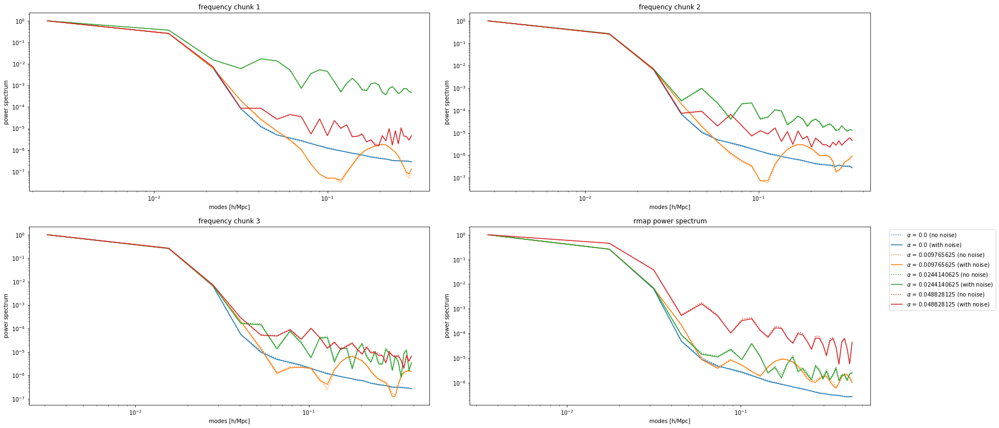

In [118]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 64 dishes, Npix_fft is 2048.

In [119]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=64, DDish=6, Npix_fft=2**11, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [120]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


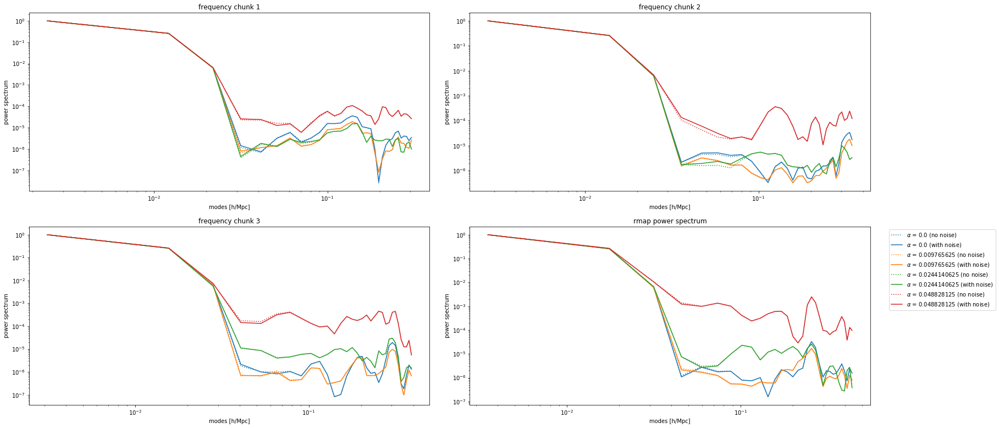

In [121]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


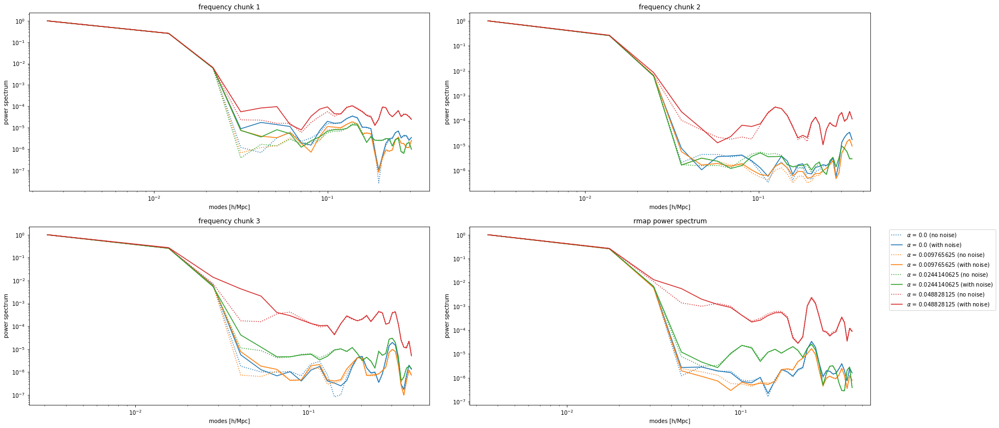

In [122]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


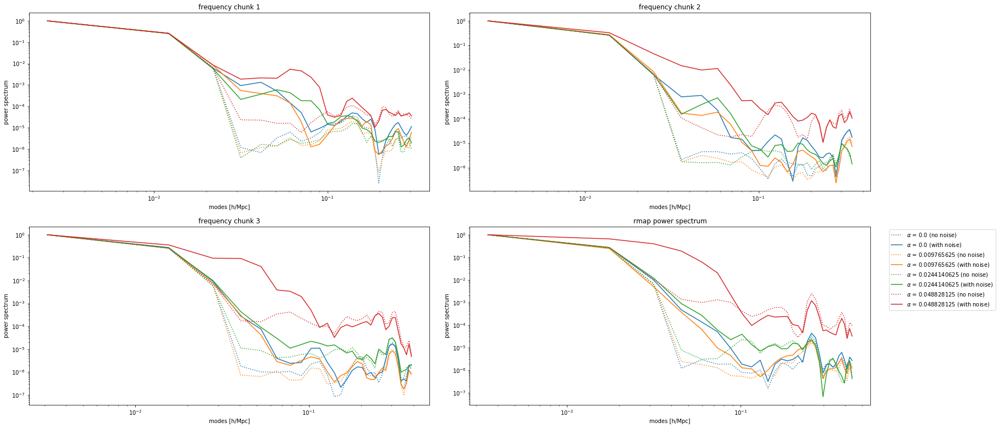

In [123]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [124]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


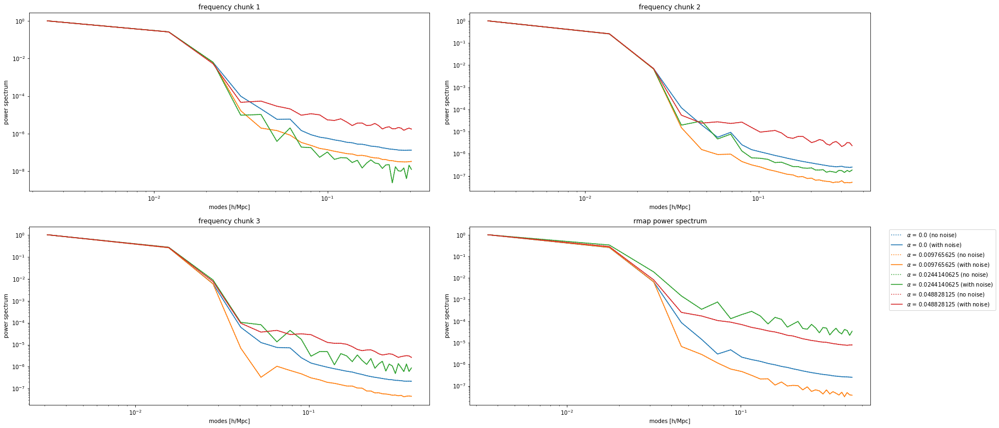

In [125]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


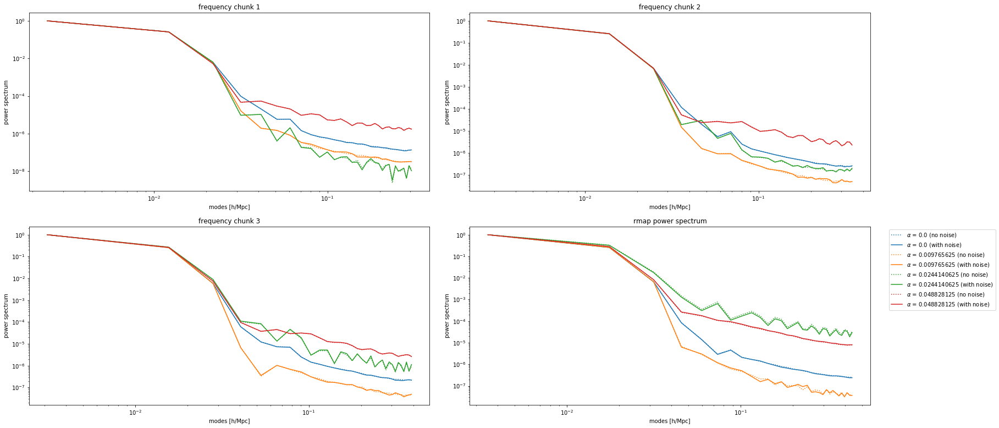

In [126]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


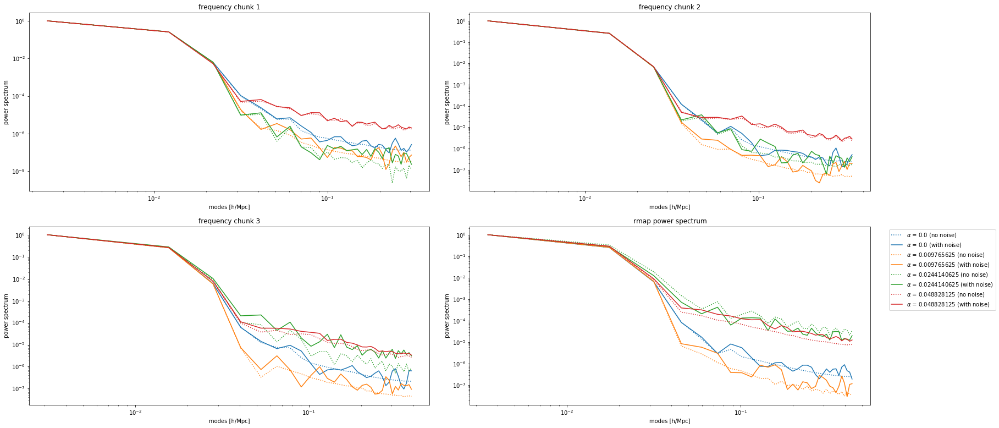

In [127]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [128]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


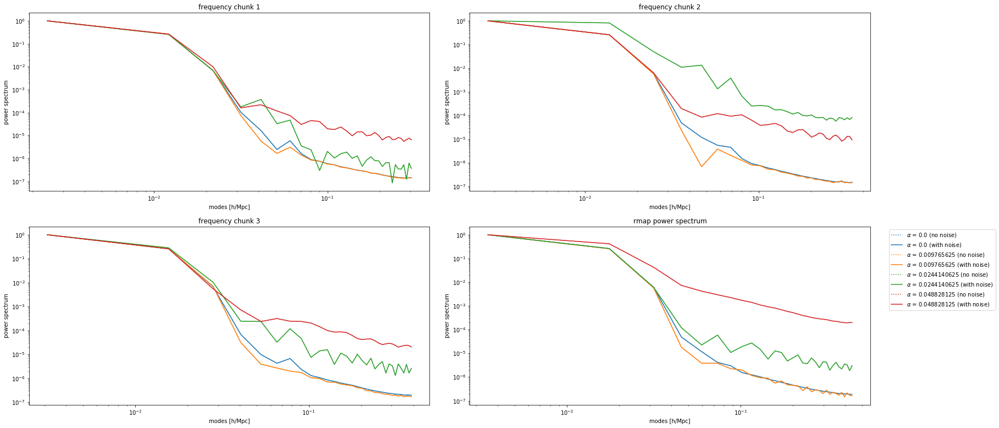

In [129]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


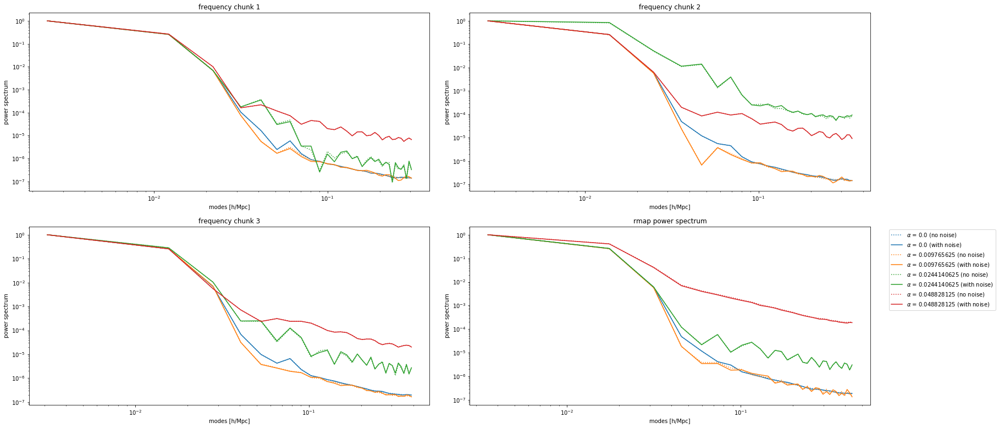

In [130]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


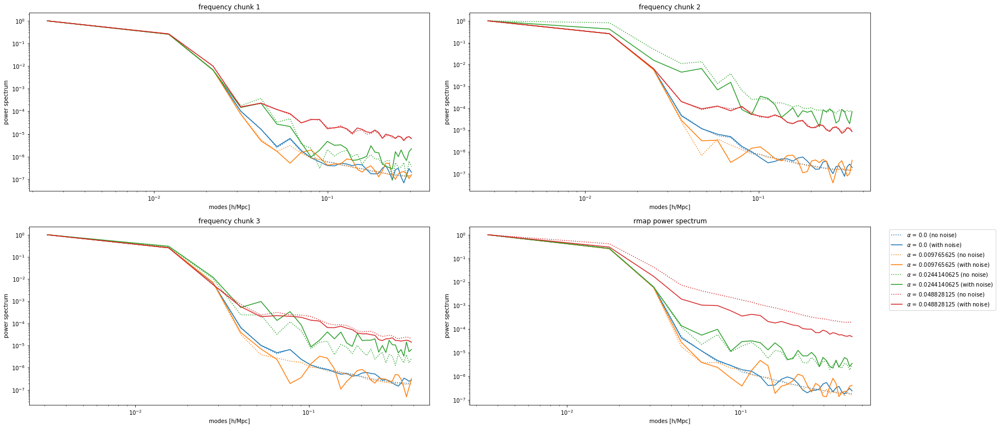

In [131]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Redundant array with 128 dishes, Npix_fft is 2048.

In [132]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=128, DDish=6, Npix_fft=2**11, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky.

In [133]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


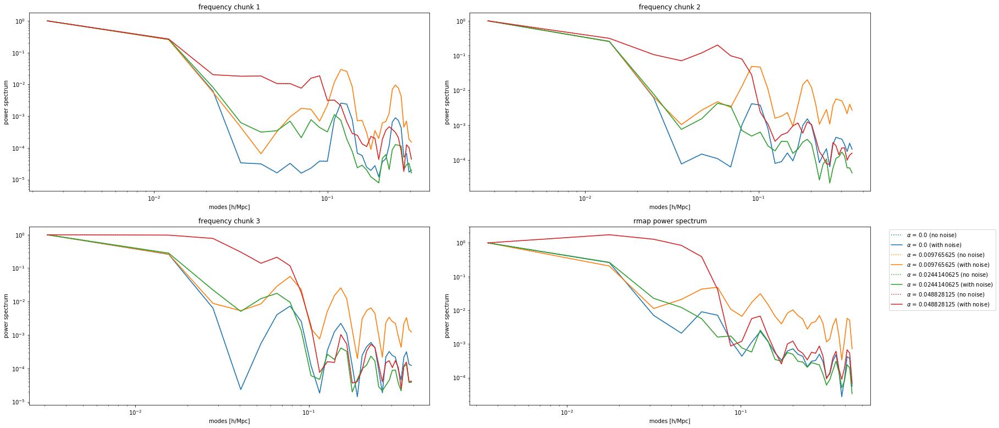

In [134]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


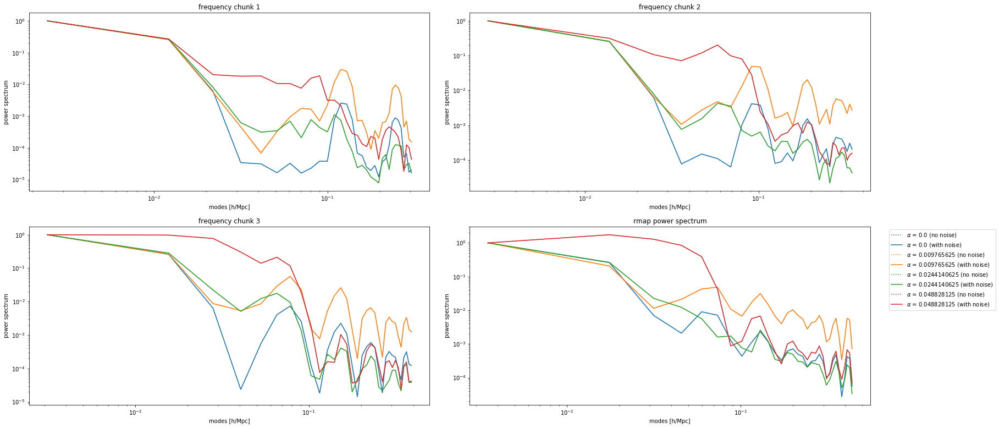

In [135]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


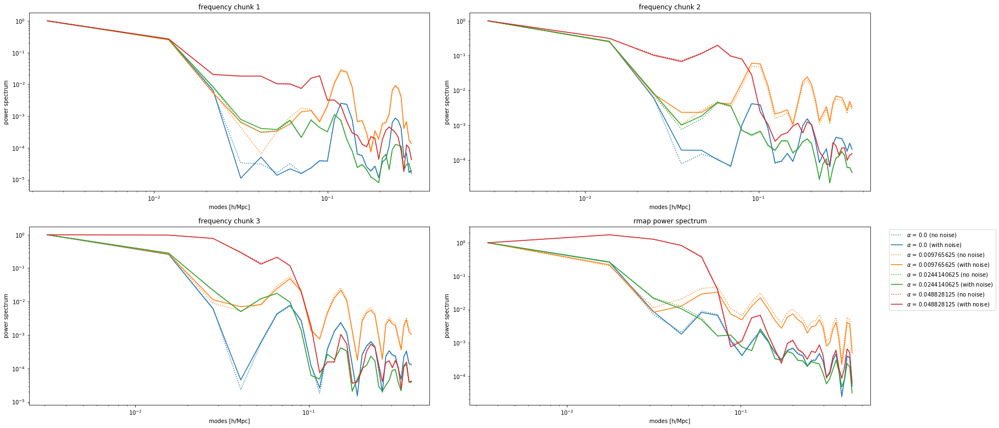

In [136]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [137]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


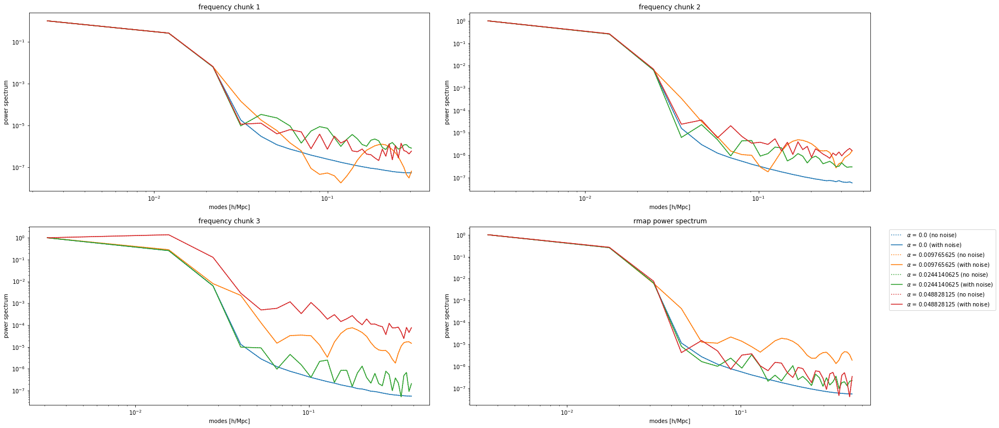

In [138]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


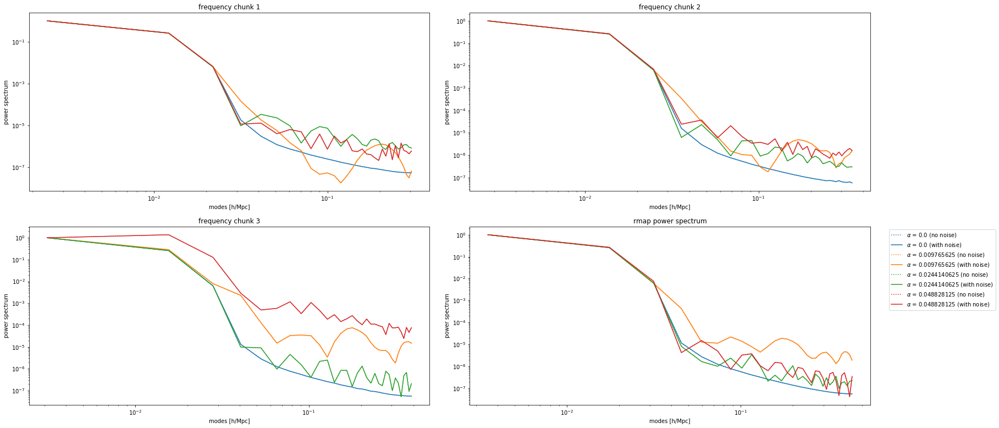

In [139]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


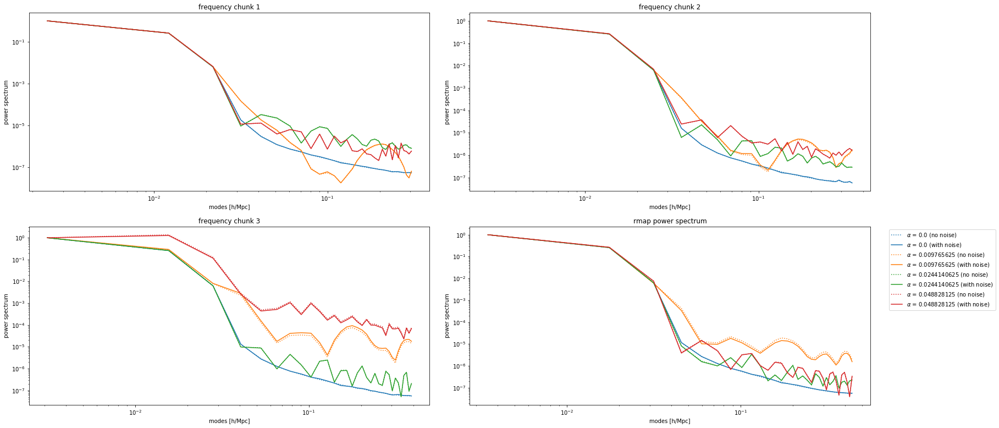

In [140]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [141]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


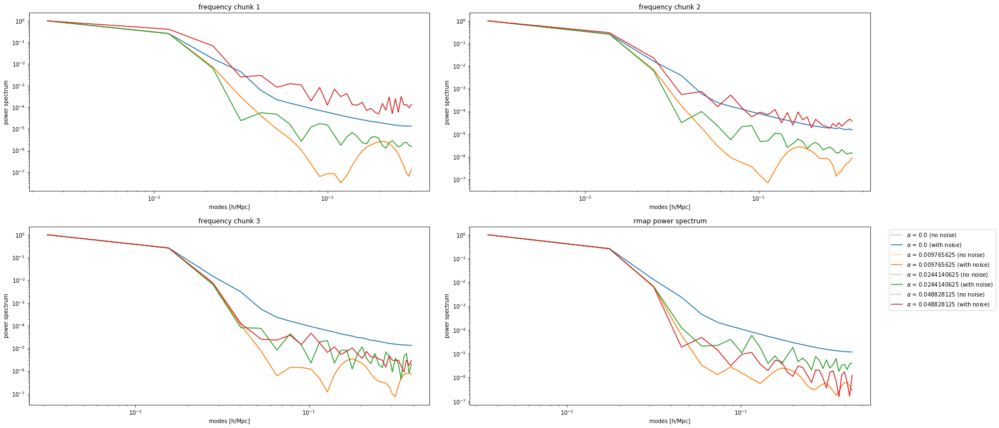

In [142]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


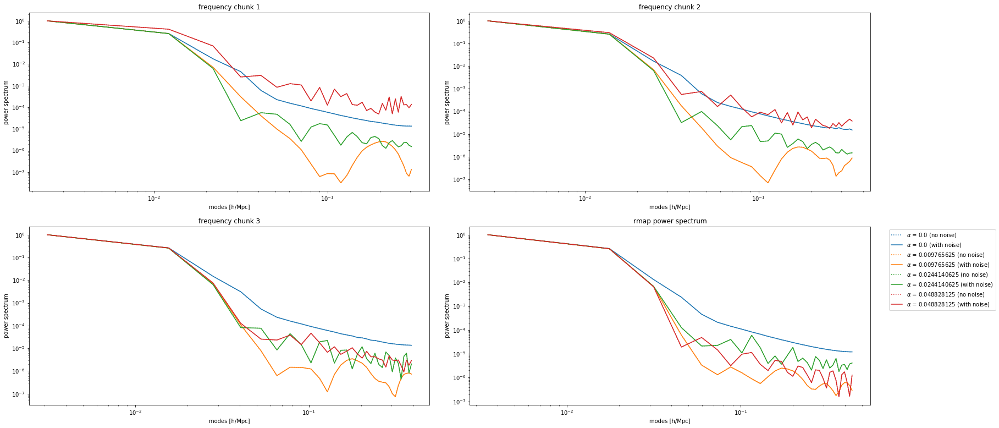

In [143]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


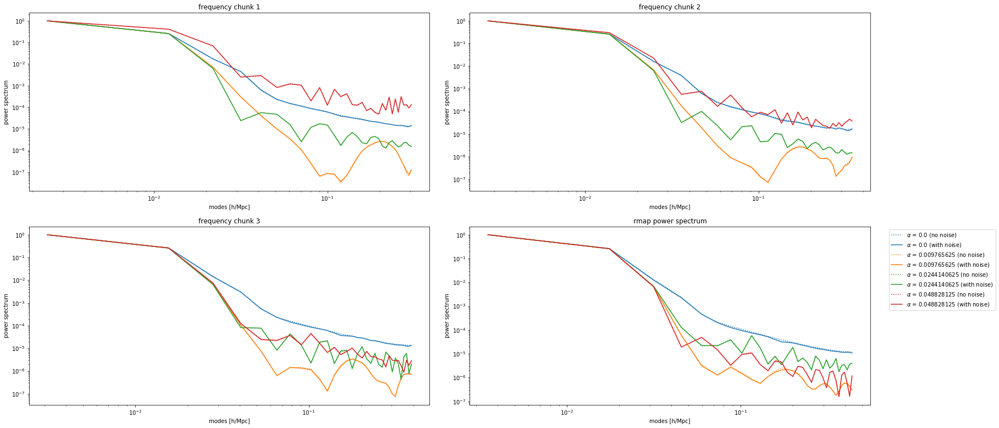

In [144]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 128 dishes, Npix_fft is 2048.

In [145]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=128, DDish=6, Npix_fft=2**11, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [146]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


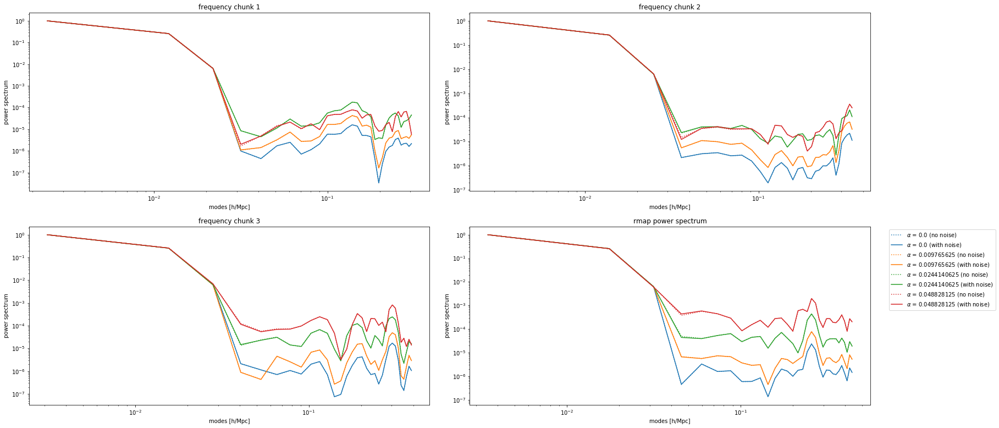

In [147]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


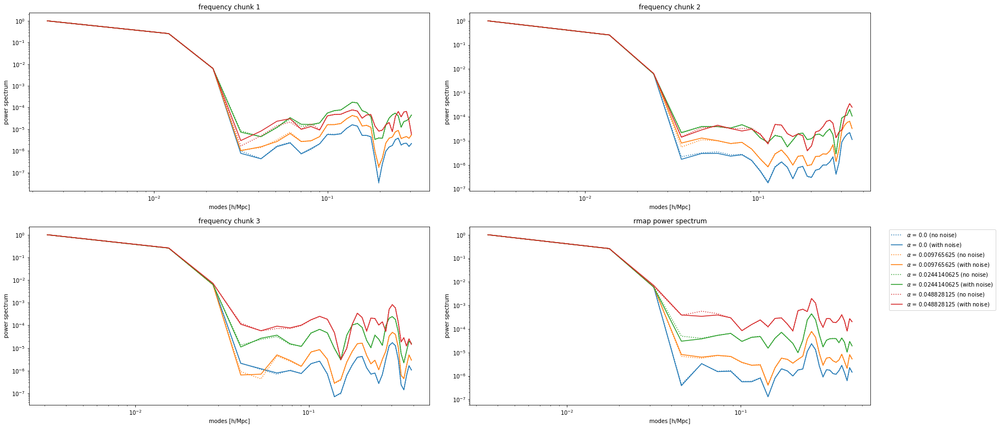

In [148]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


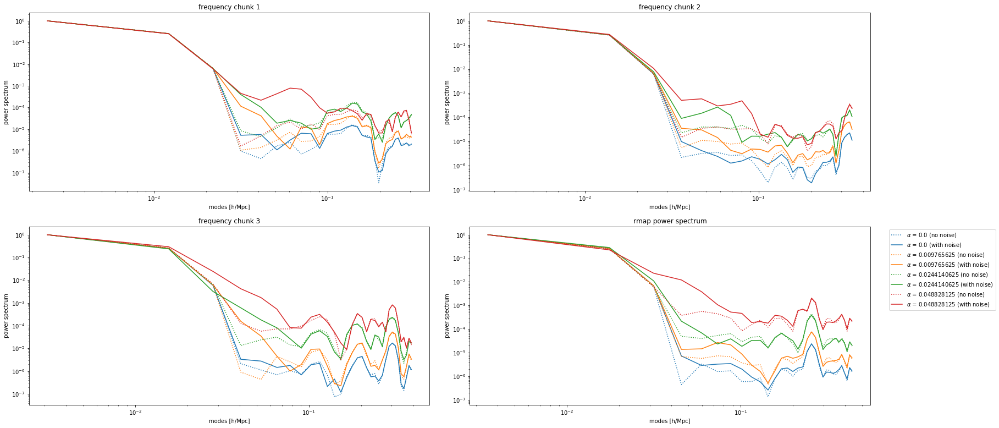

In [149]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [150]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


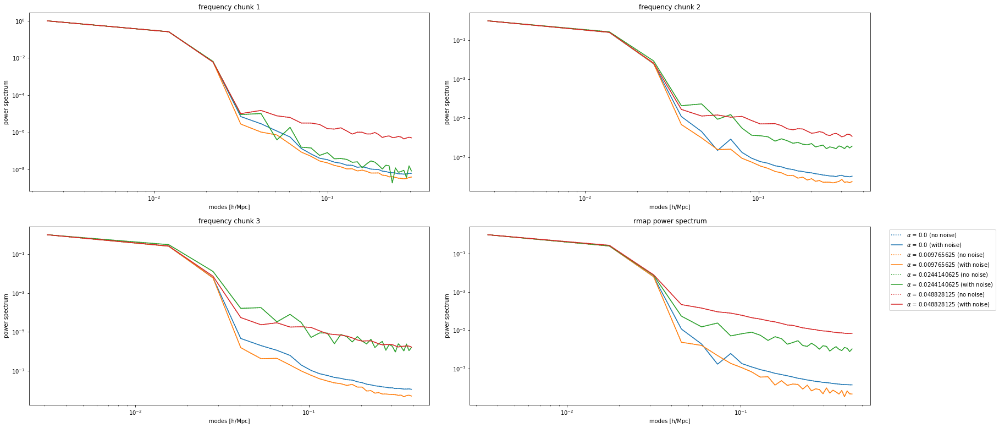

In [151]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


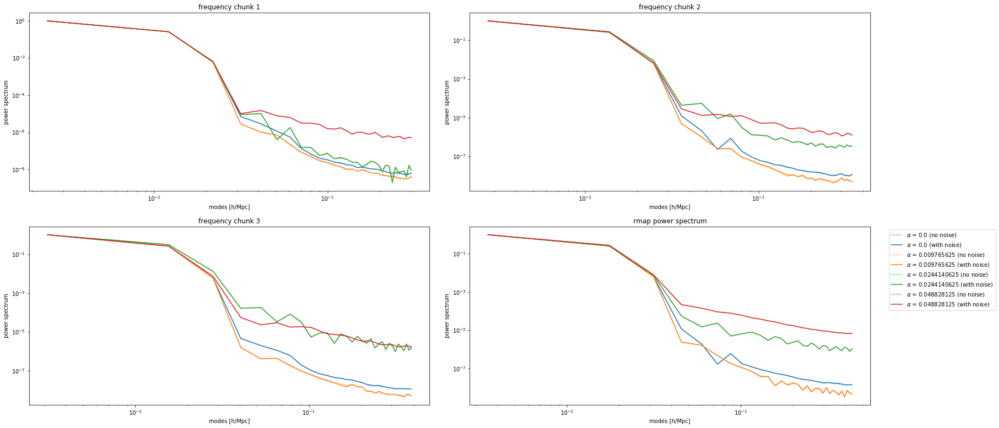

In [152]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


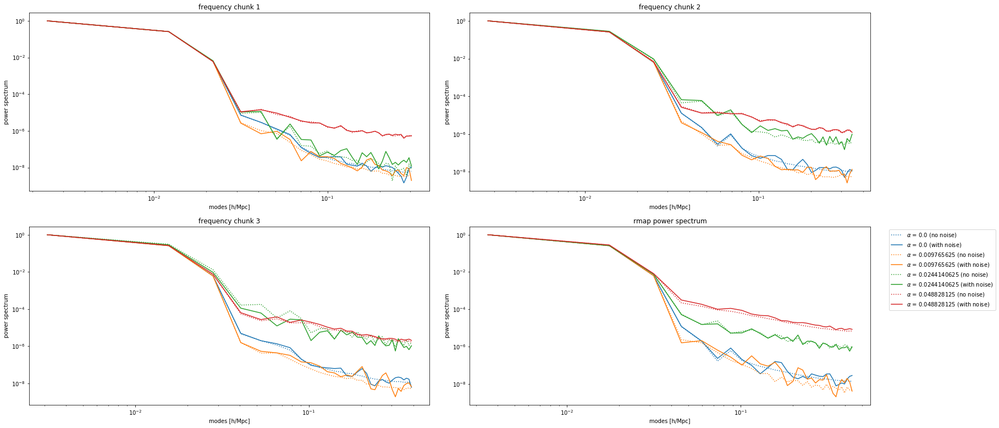

In [153]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [154]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


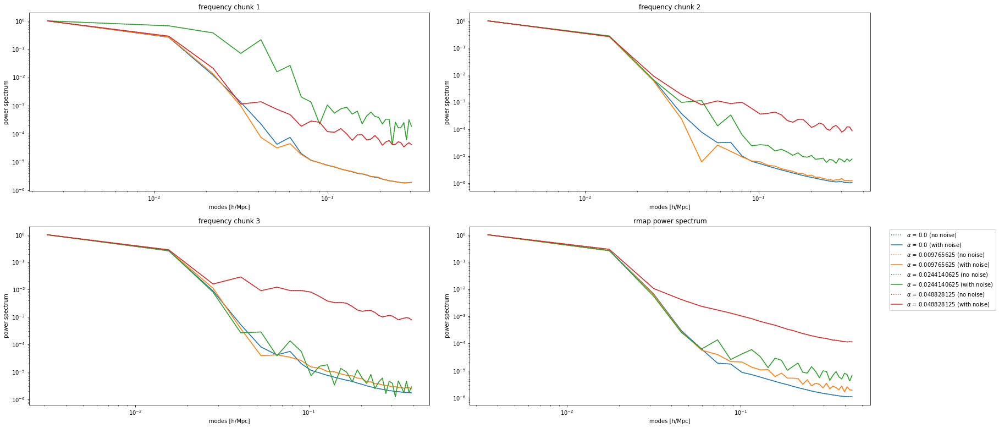

In [155]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


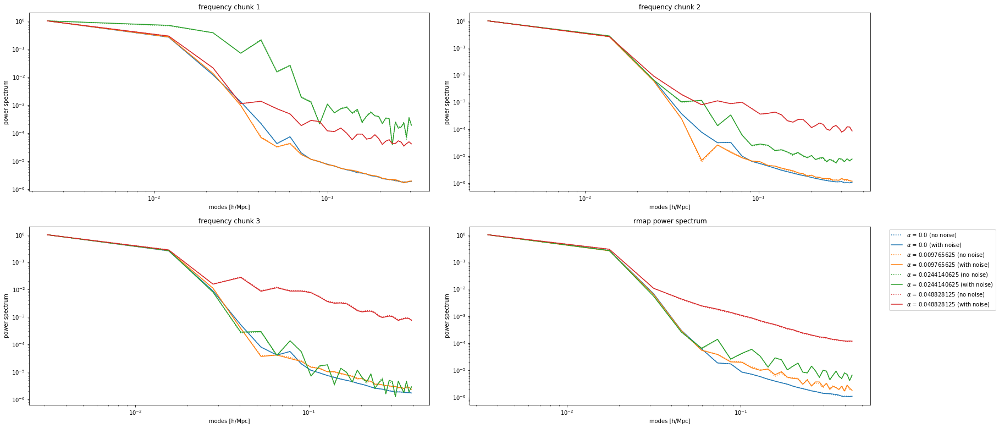

In [156]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


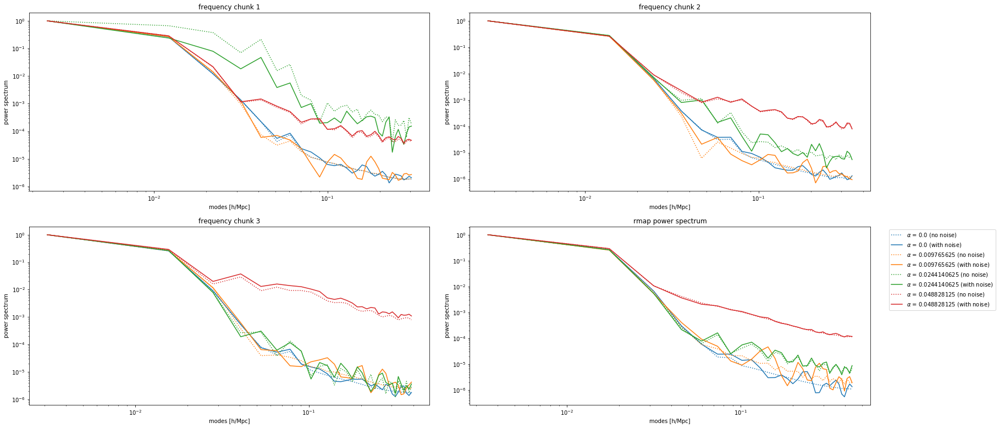

In [157]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Redundant array with 32 dishes, Npix_fft is 8192.

In [158]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=32, DDish=6, Npix_fft=2**13, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky.

In [159]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


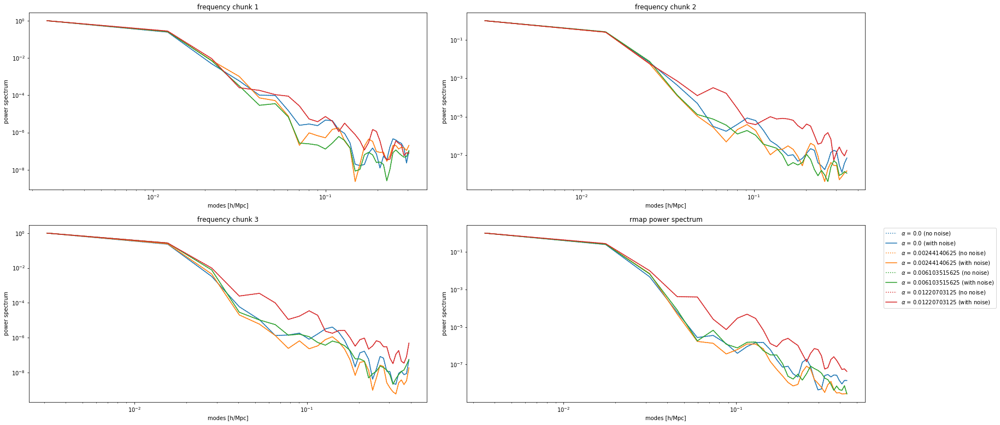

In [160]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


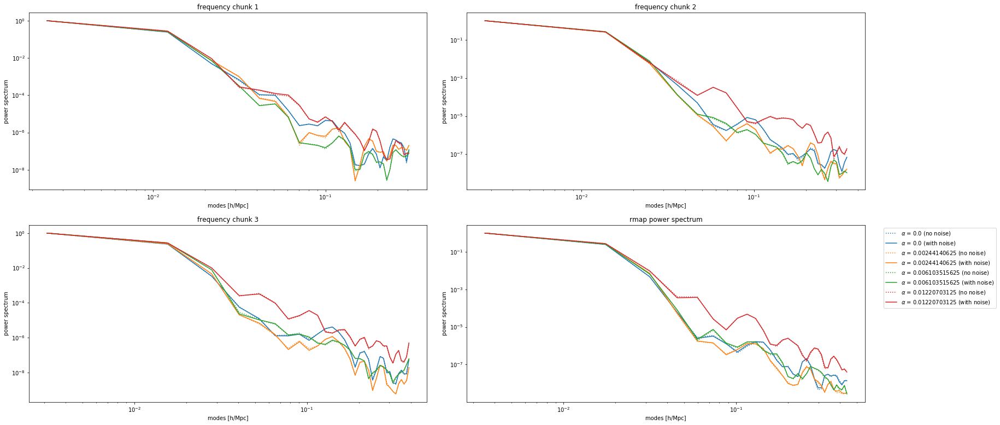

In [161]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


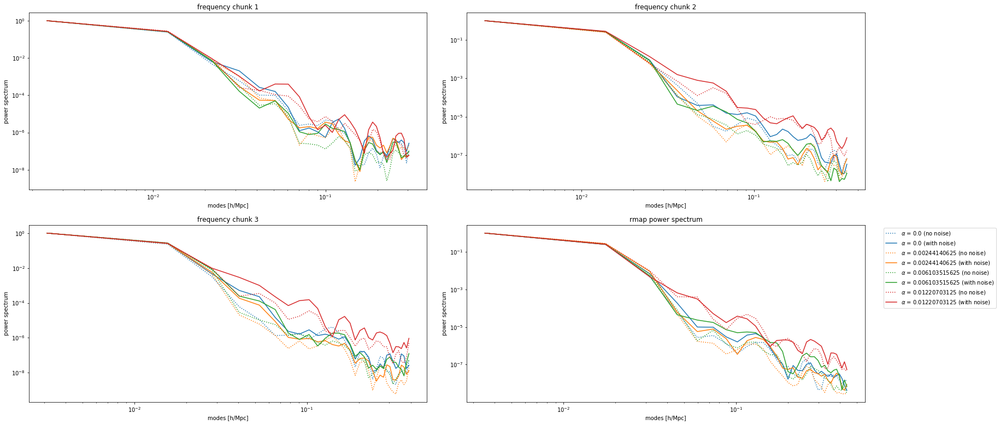

In [162]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [163]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


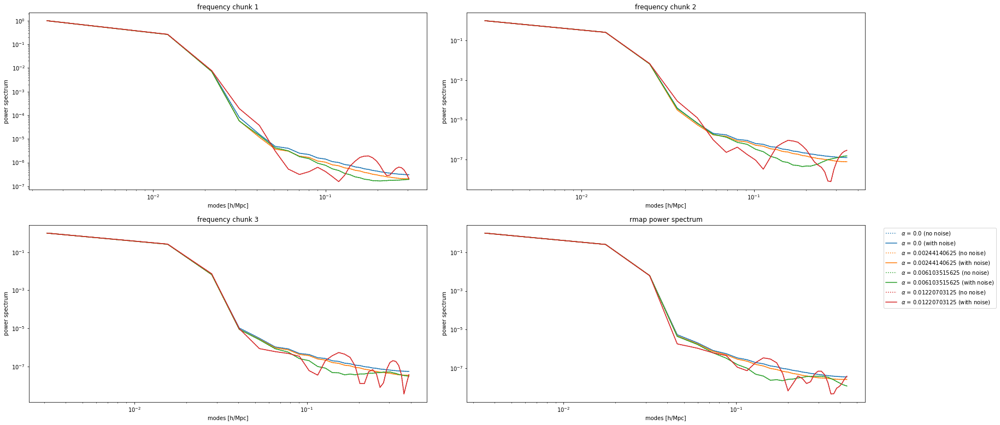

In [164]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


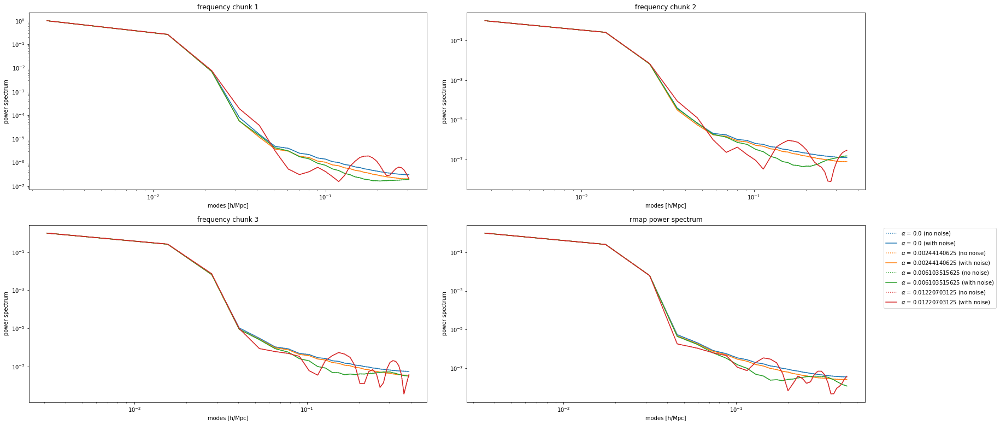

In [165]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


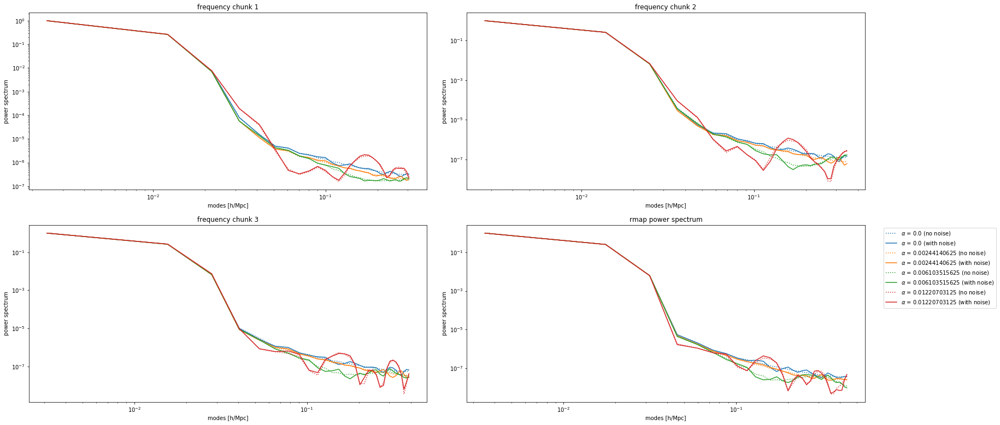

In [166]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [167]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


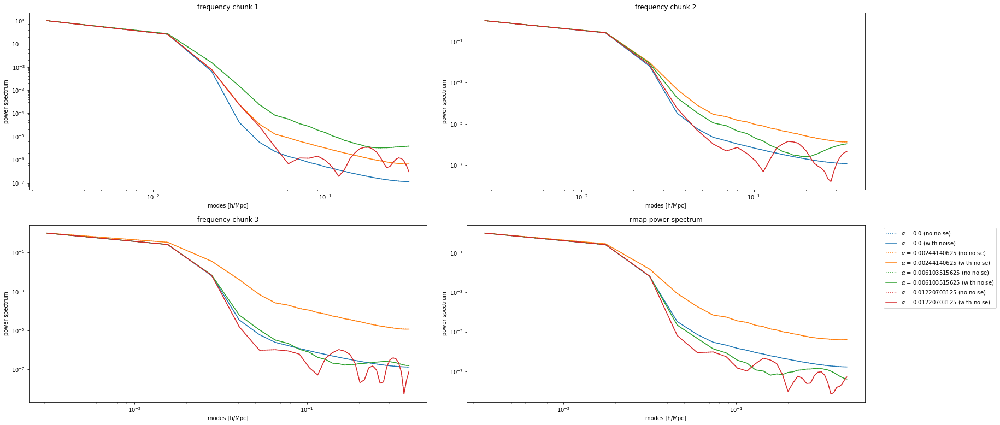

In [168]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


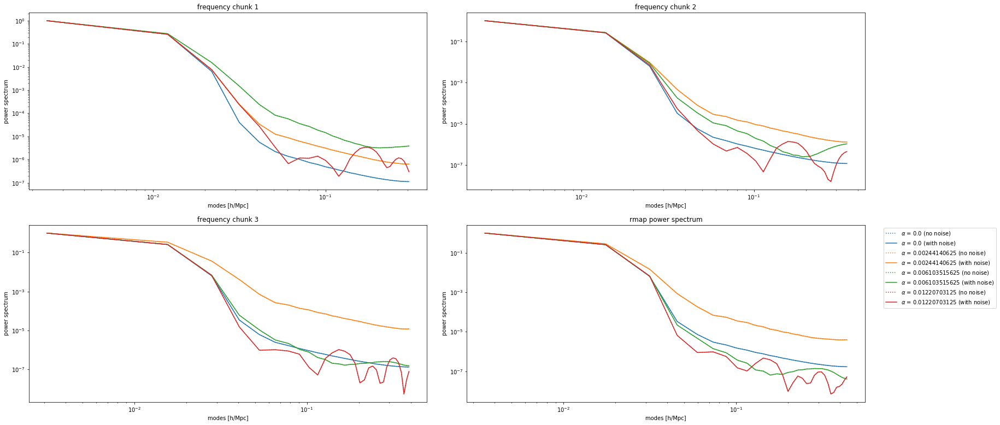

In [169]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


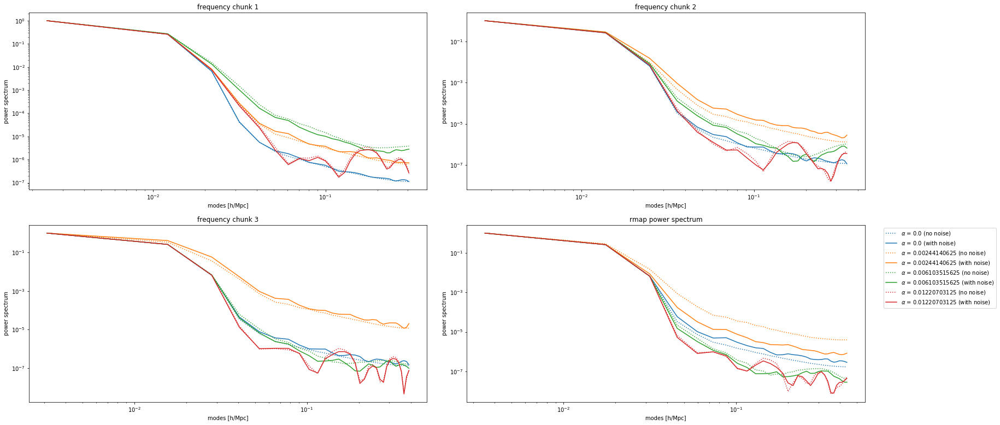

In [170]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 32 dishes, Npix_fft is 8192.

In [171]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=32, DDish=6, Npix_fft=2**13, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [172]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


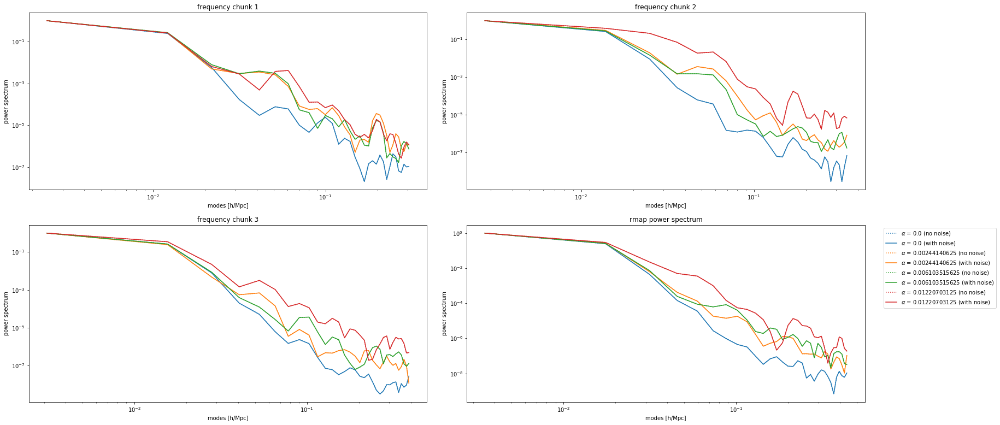

In [173]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


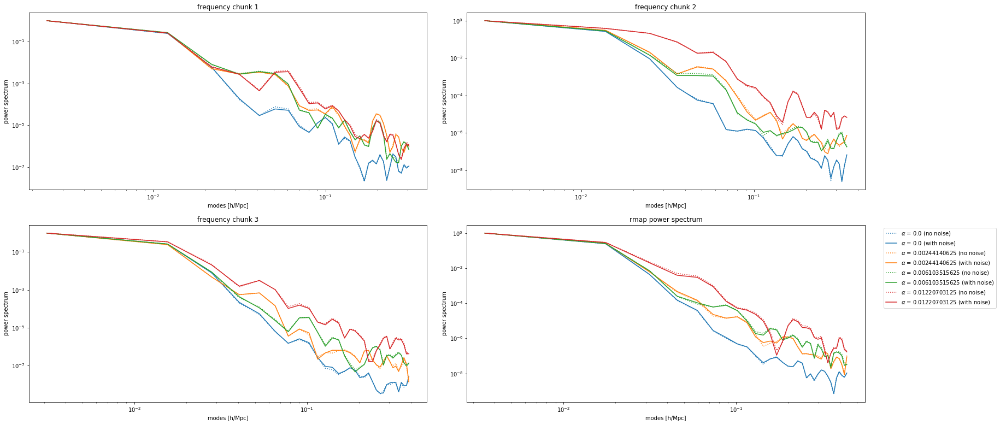

In [174]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


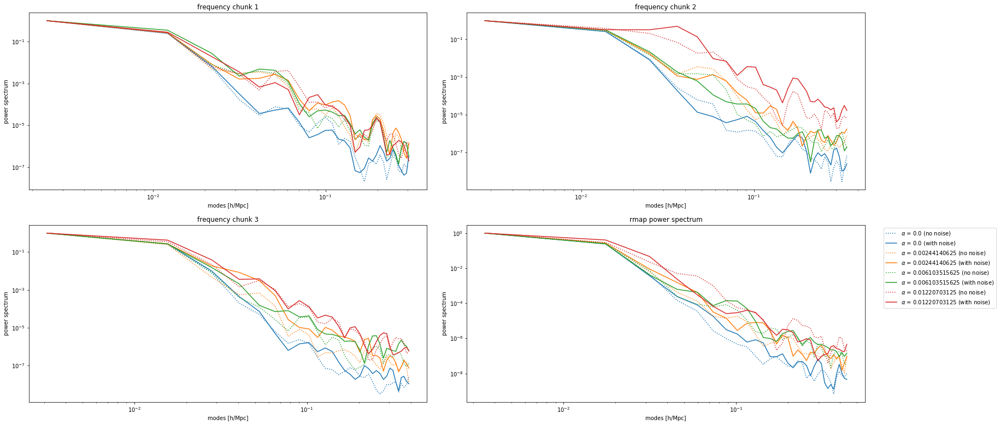

In [175]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [176]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


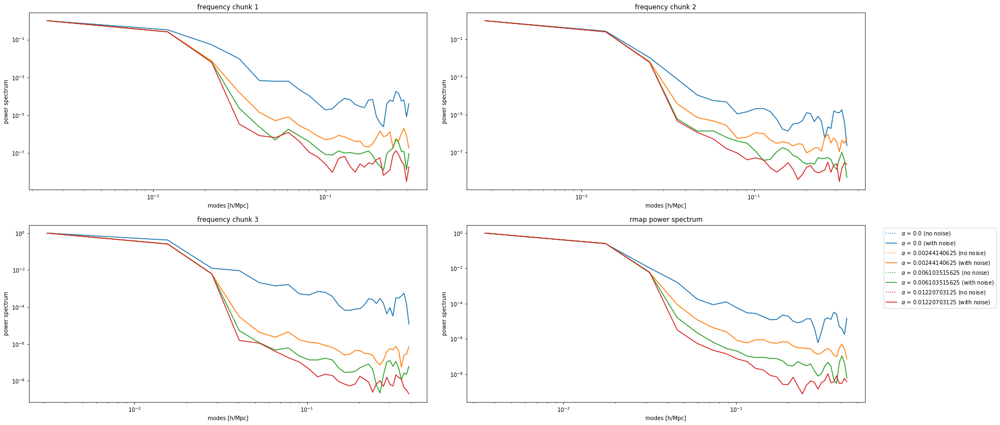

In [177]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


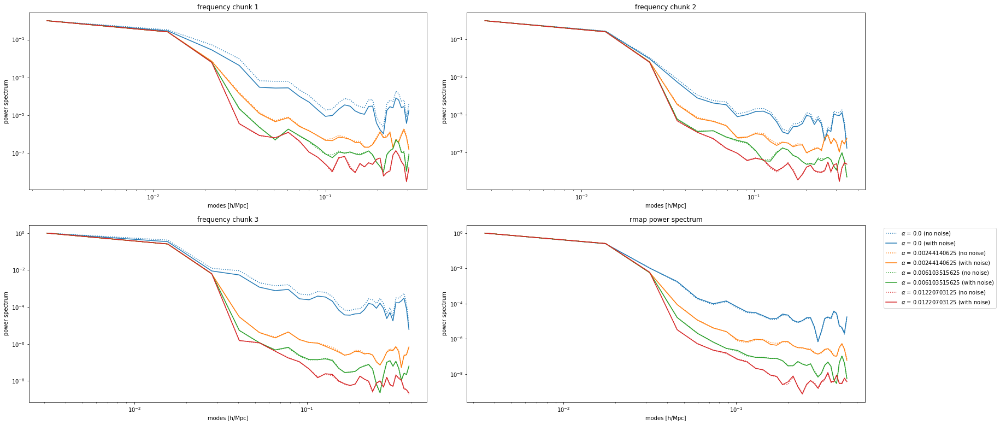

In [178]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


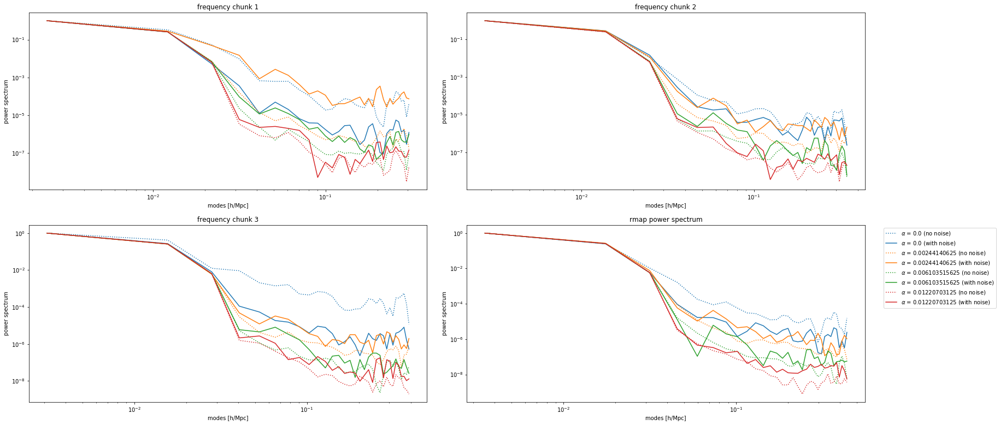

In [179]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [180]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


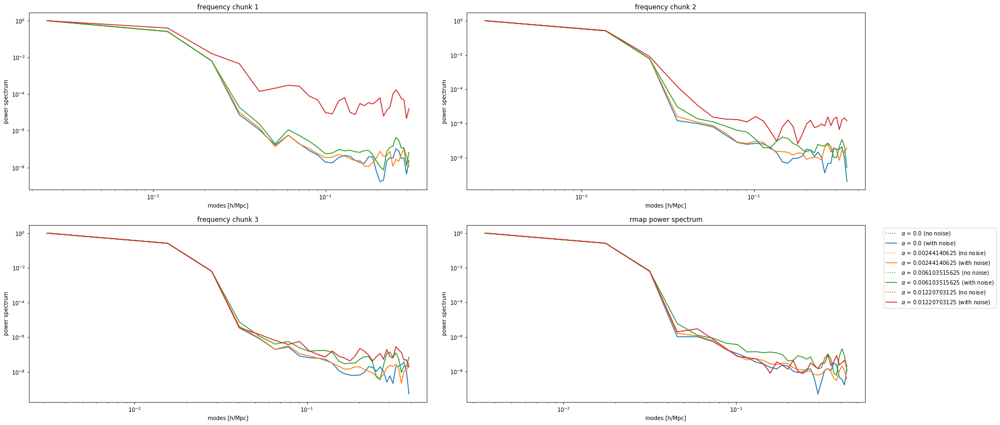

In [181]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


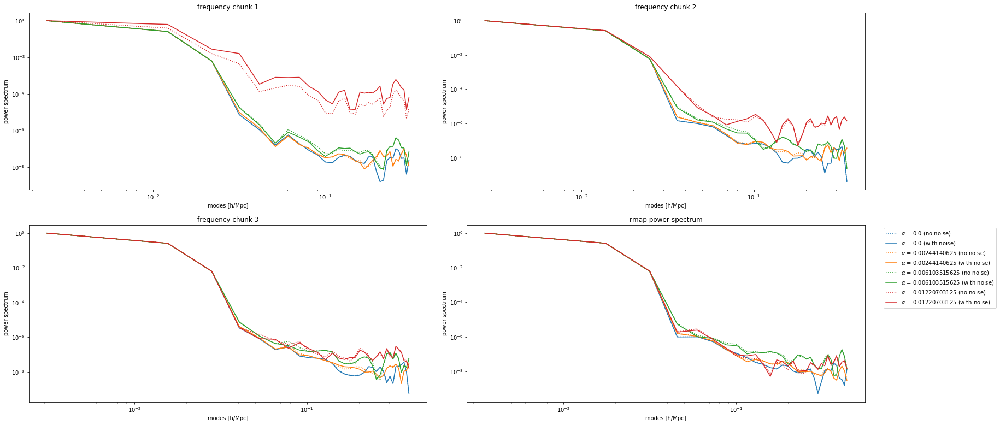

In [182]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


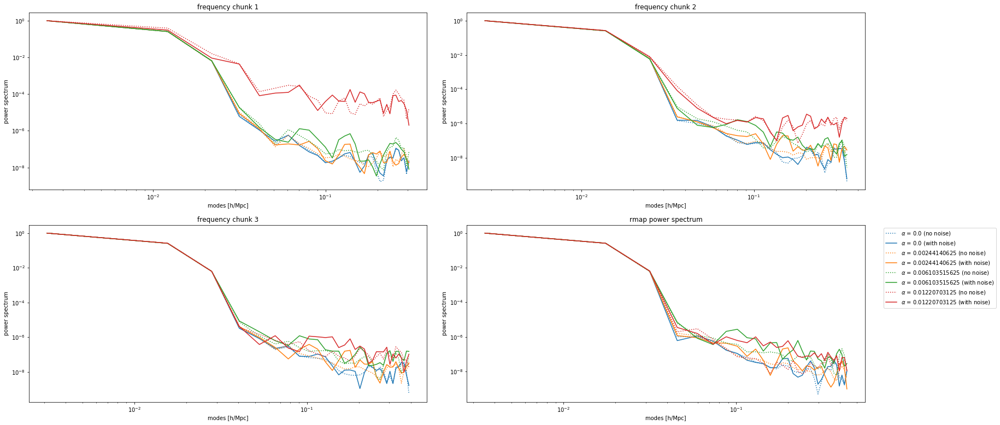

In [183]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Redundant array with 64 dishes, Npix_fft is 8192.

In [184]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=64, DDish=6, Npix_fft=2**13, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky.

In [185]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


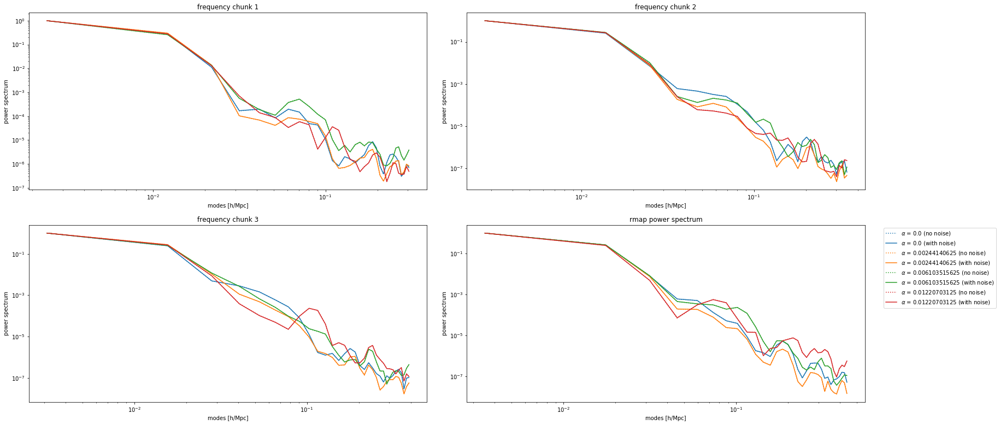

In [186]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


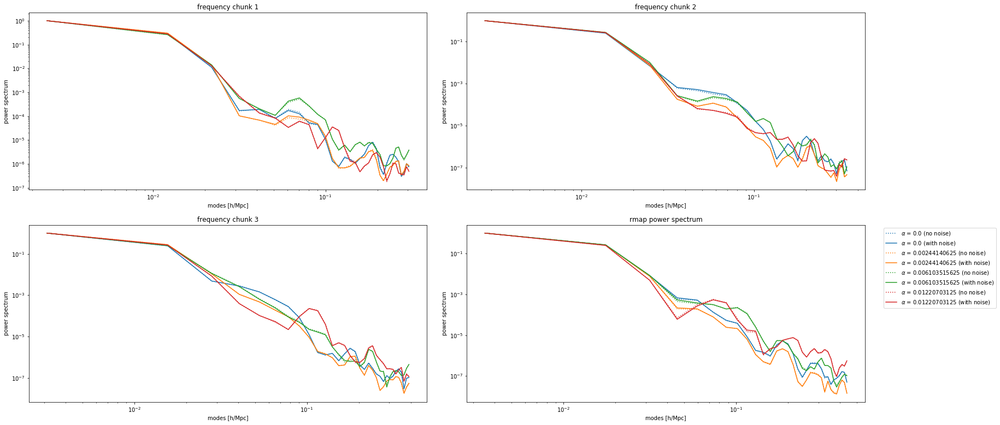

In [187]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


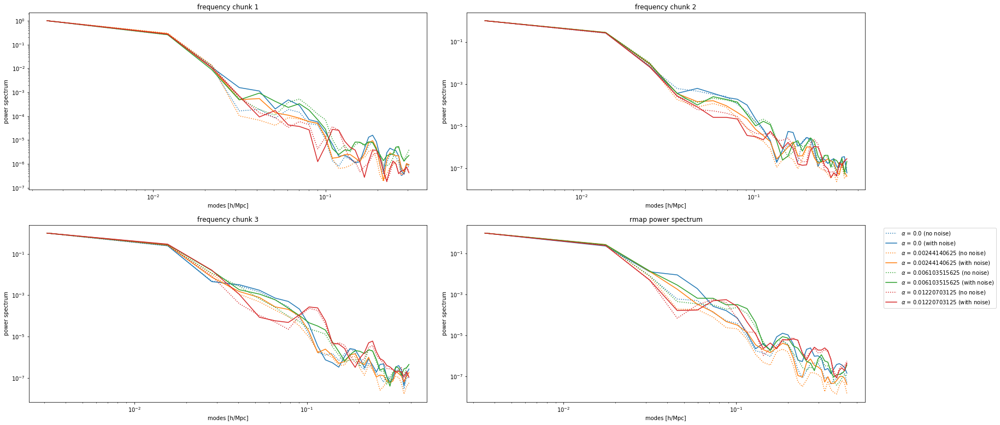

In [188]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [189]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


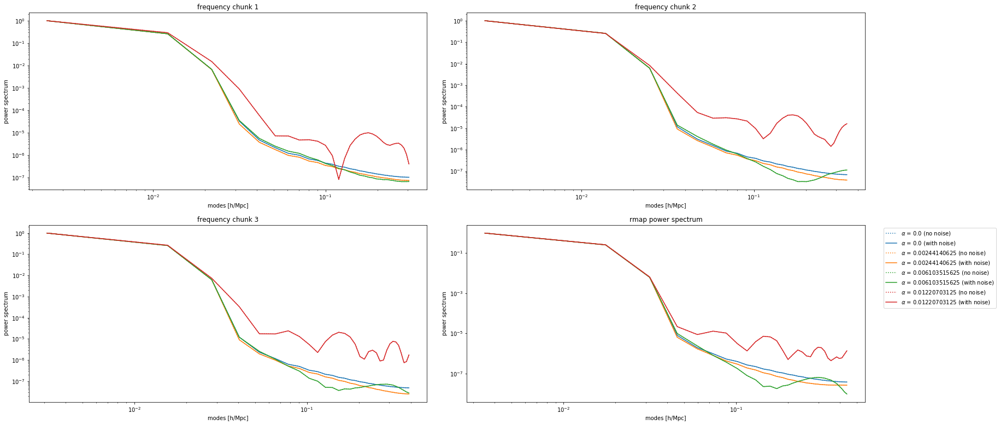

In [190]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


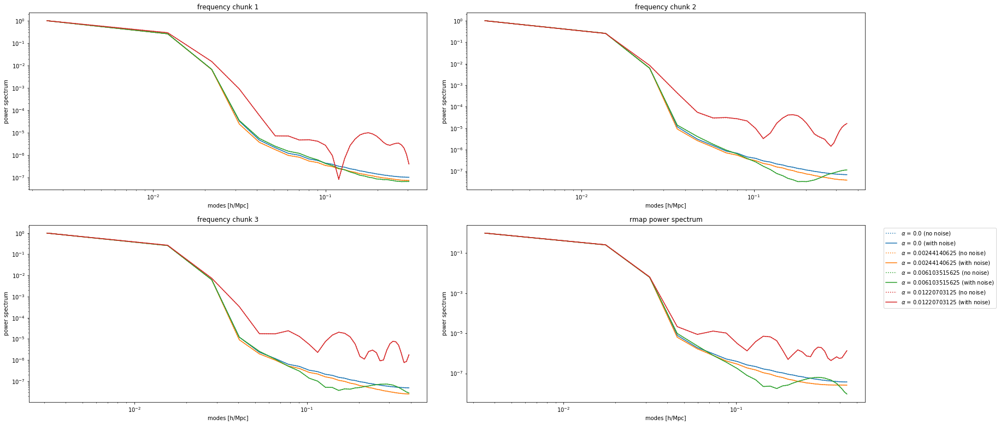

In [191]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


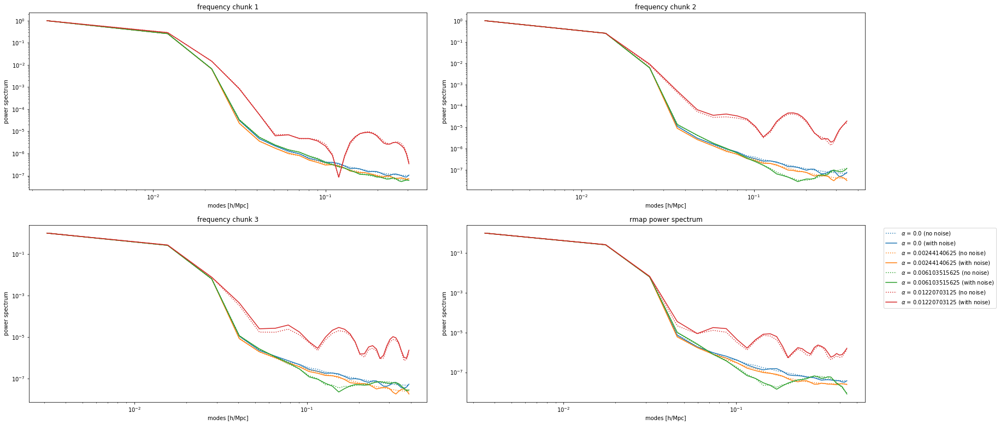

In [192]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [193]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


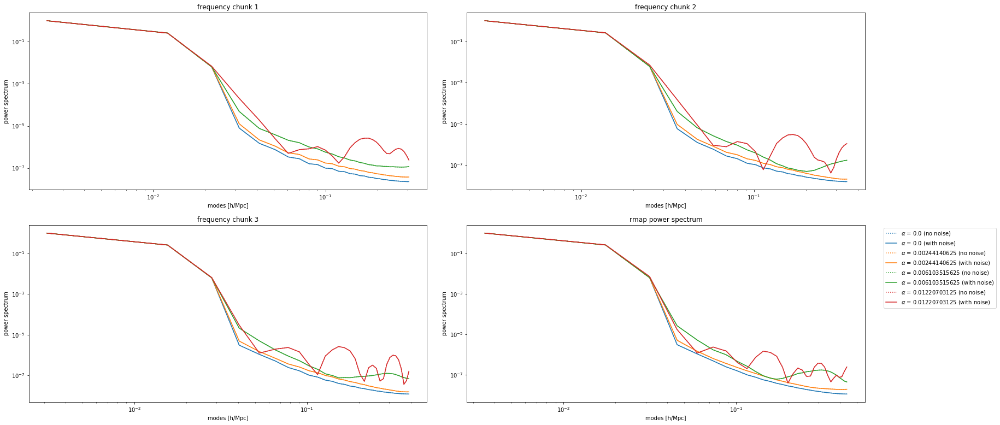

In [194]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


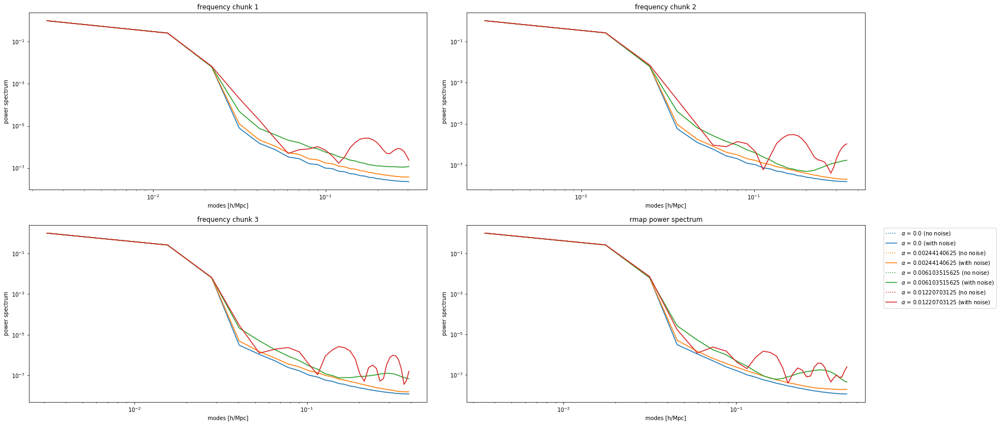

In [195]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


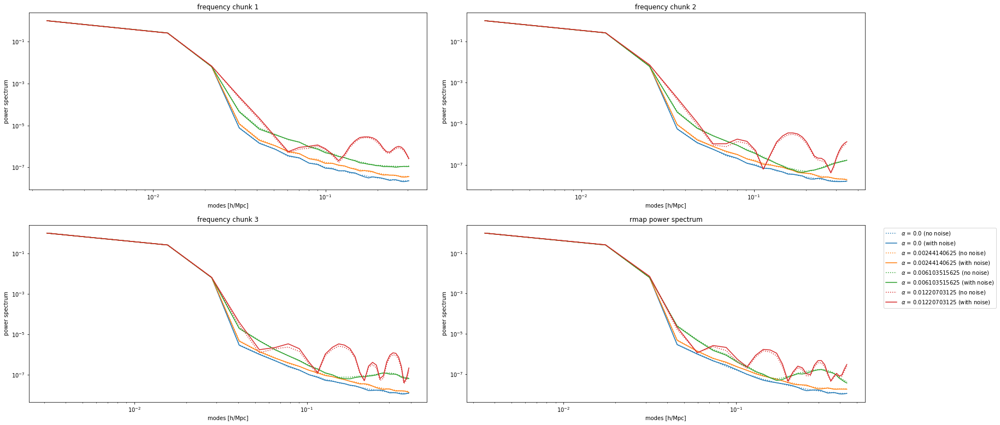

In [196]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 64 dishes, Npix_fft 8192.

In [197]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=64, DDish=6, Npix_fft=2**13, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [198]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


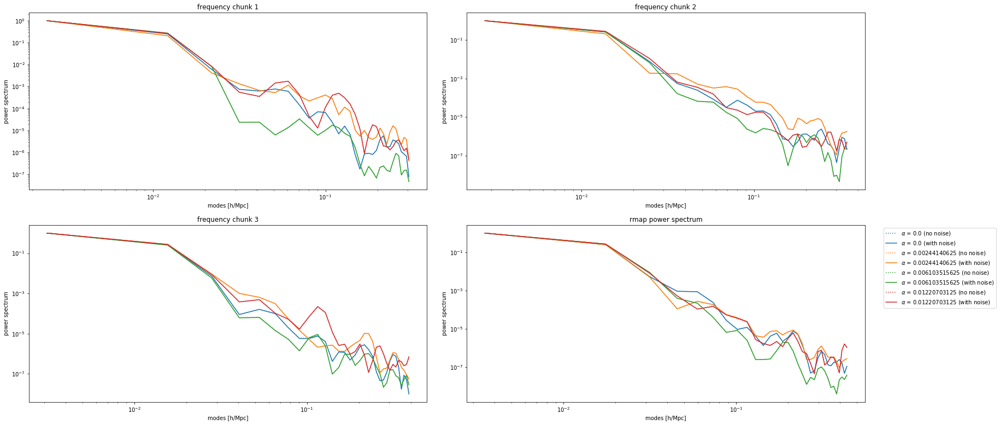

In [199]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


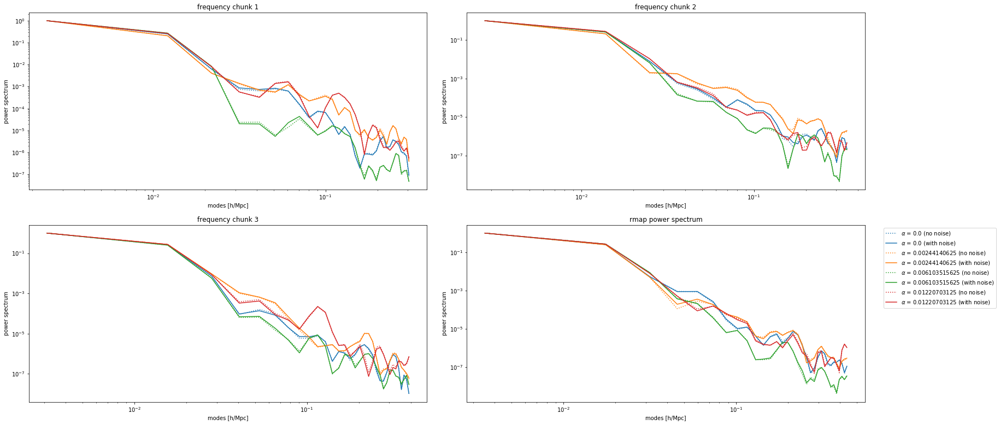

In [200]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


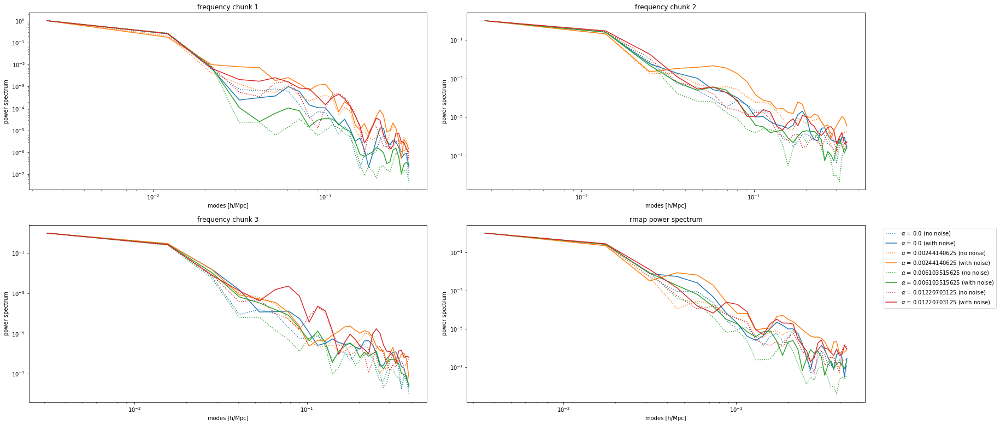

In [201]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [202]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


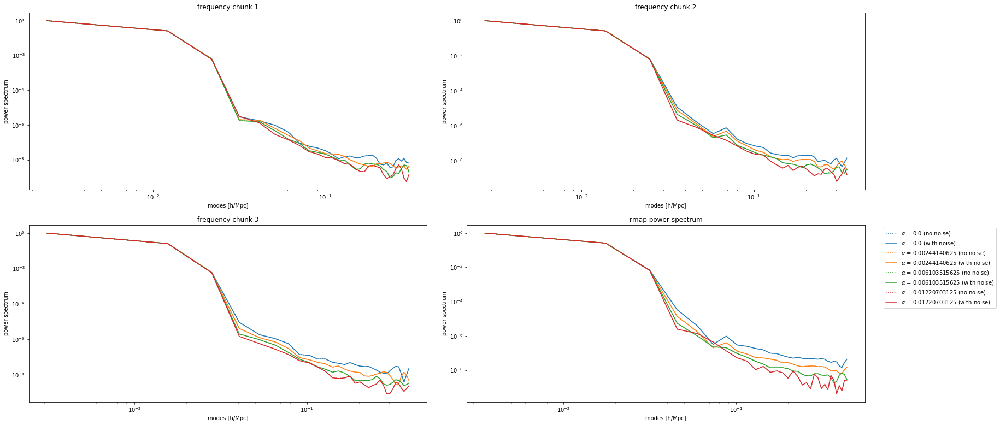

In [203]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


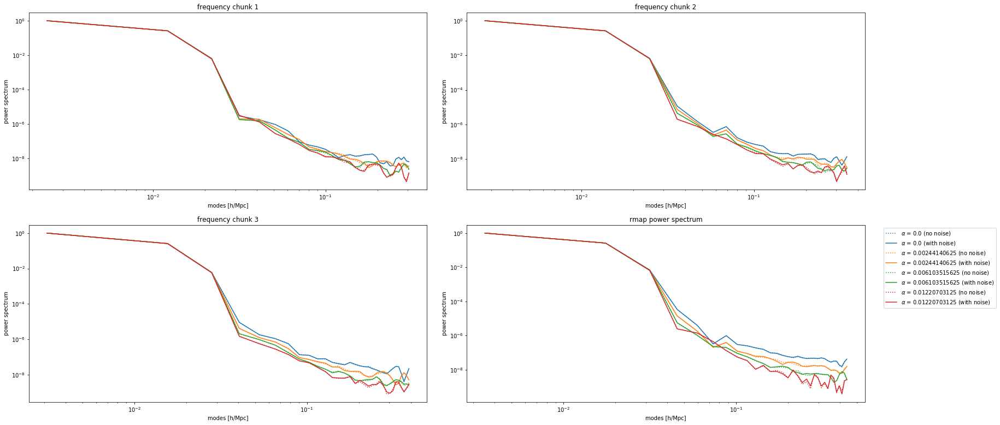

In [204]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


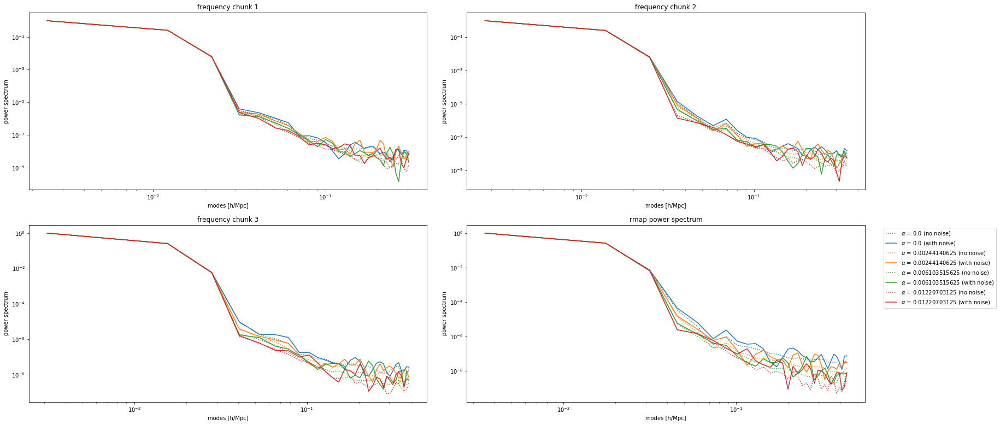

In [205]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [206]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


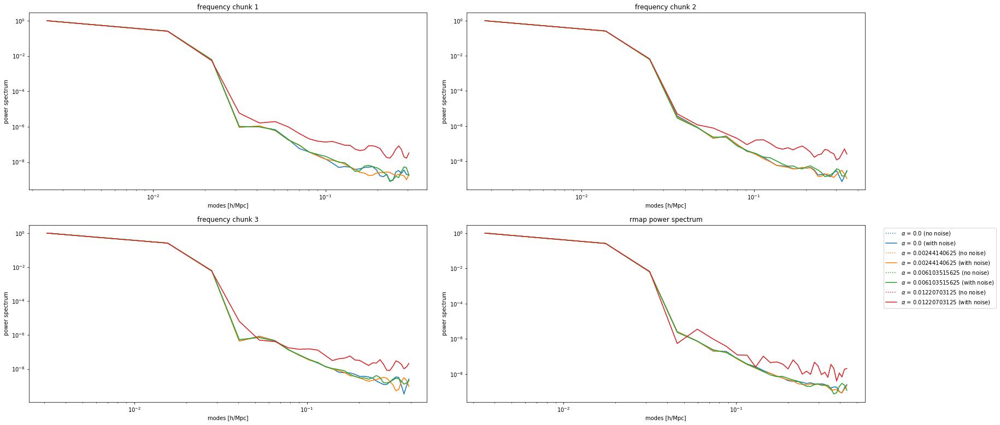

In [207]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


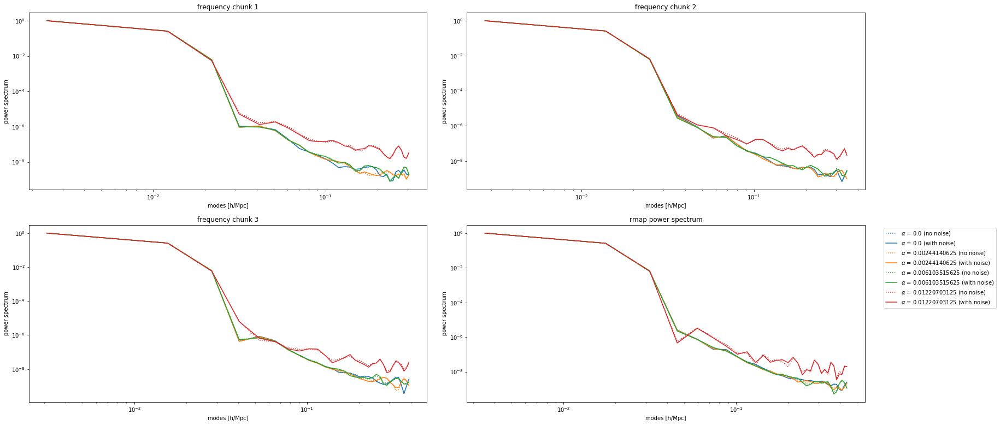

In [208]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


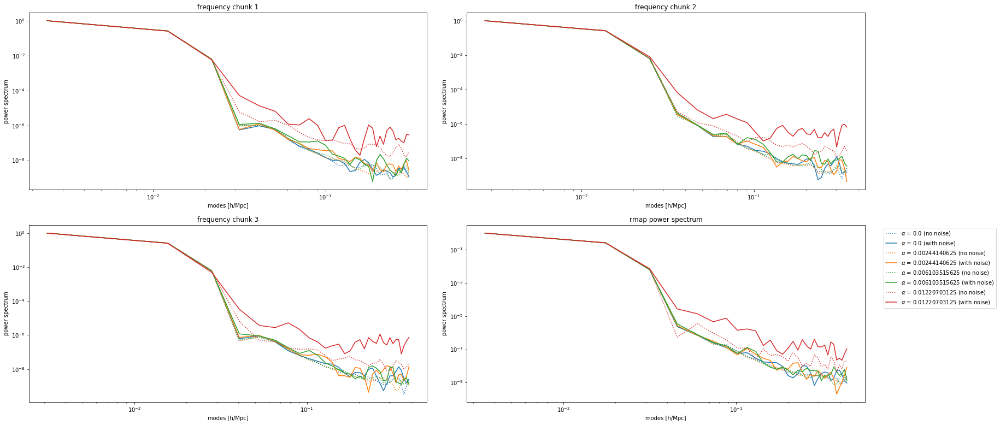

In [209]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Redundant array with 128 dishes, Npix_fft is 8192.

In [210]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=128, DDish=6, Npix_fft=2**13, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=True)

Uniform random sky.

In [211]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


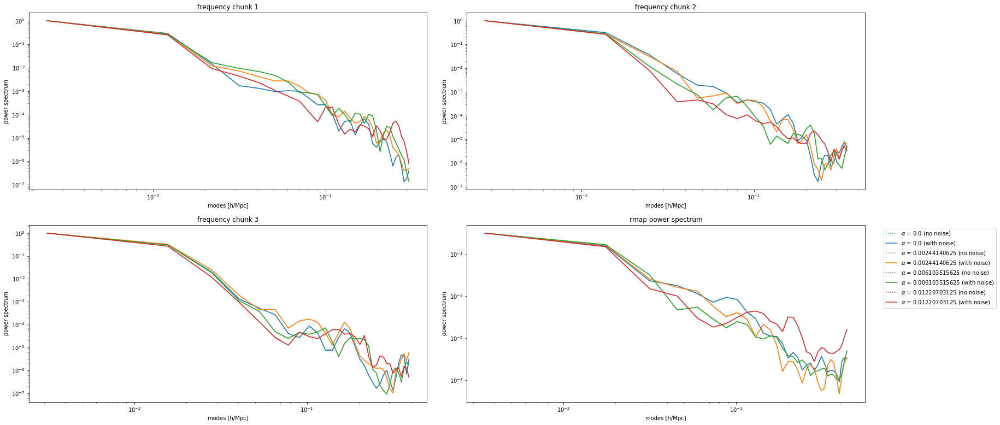

In [212]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


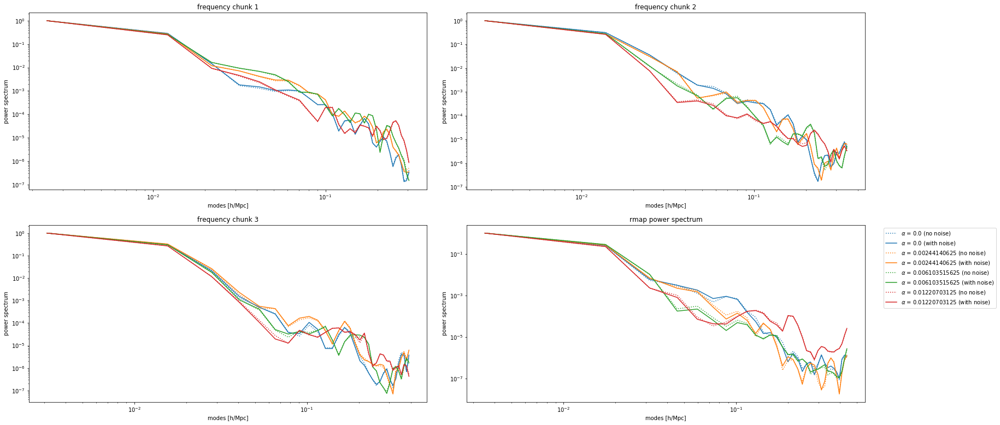

In [213]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


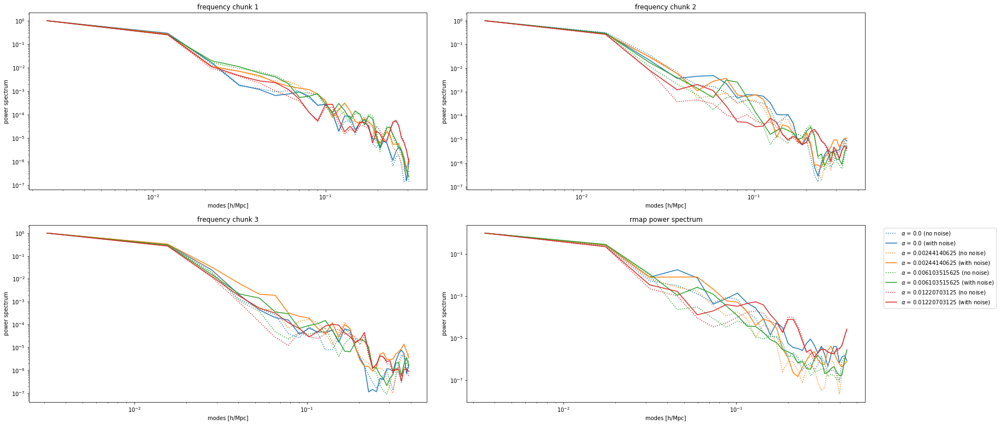

In [214]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [215]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


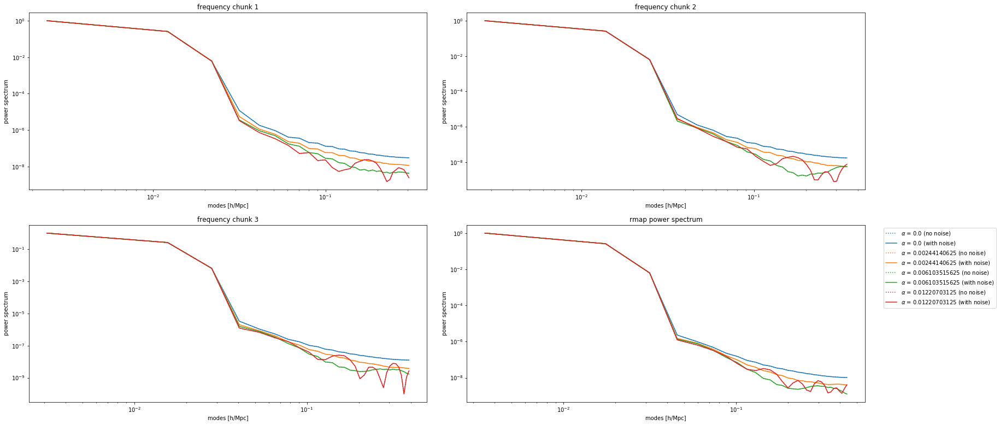

In [216]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


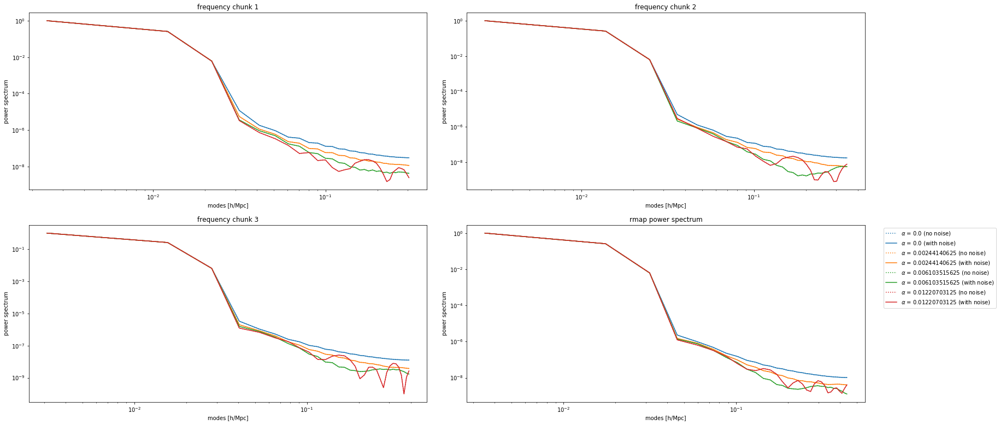

In [217]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


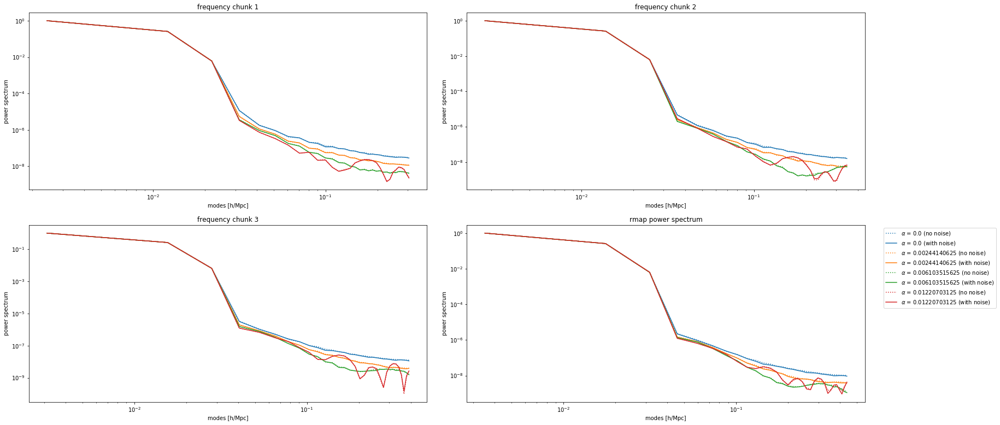

In [218]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [219]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


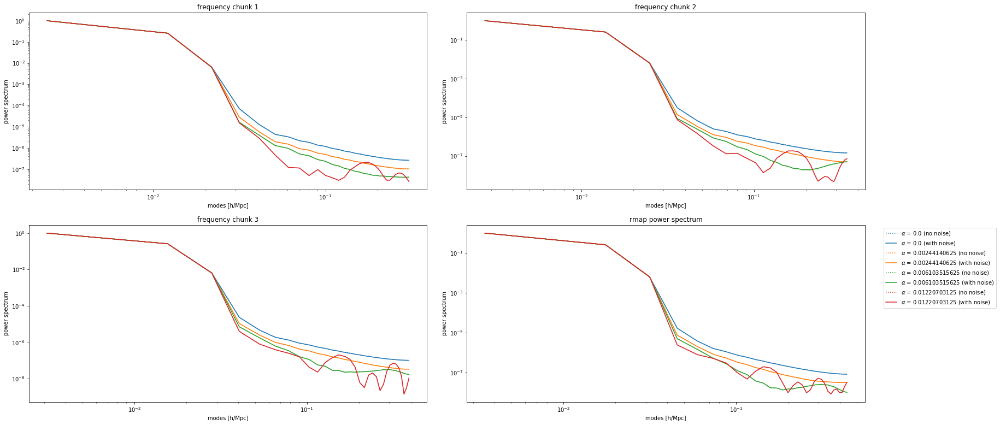

In [220]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


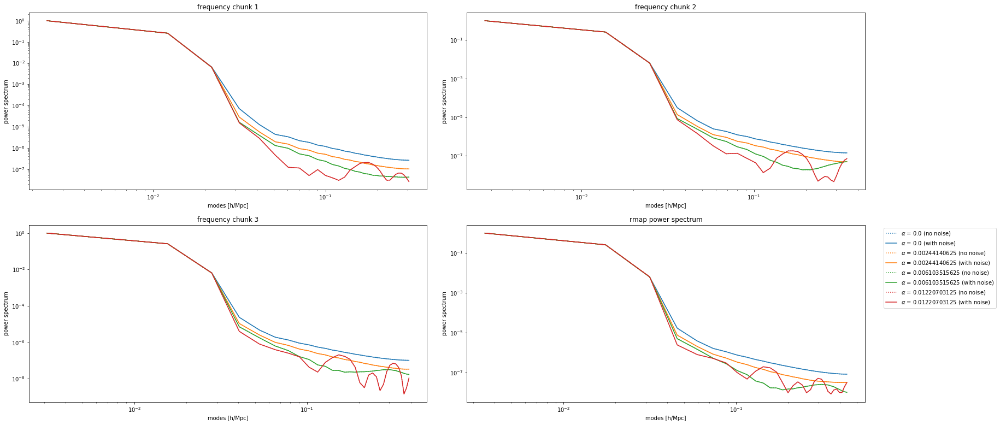

In [221]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


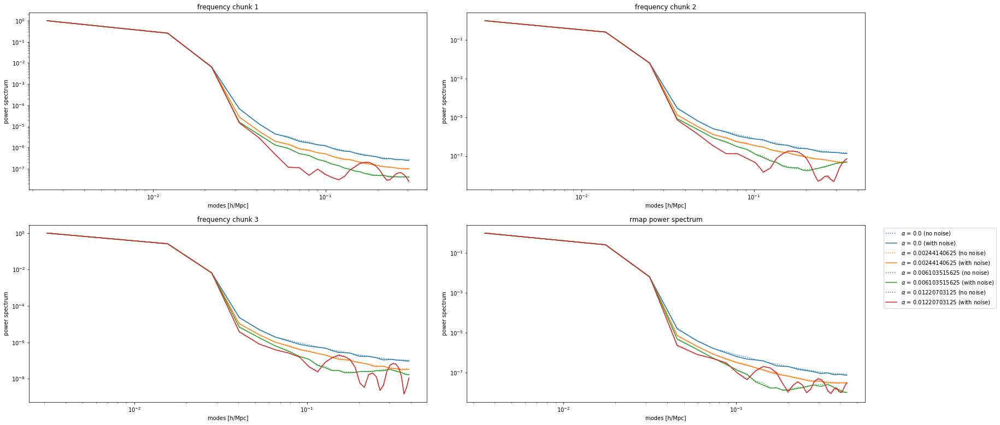

In [222]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Less redundant array with 128 dishes, Npix_fft is 8192.

In [223]:
t = telescope_1d.Telescope1D(Nfreq=256, Ndishes=128, DDish=6, Npix_fft=2**13, Npad=2**8,
                             minfreq=400, maxfreq=800, redundant=False)

Uniform random sky.

In [224]:
image = t.get_uniform_sky(high=2)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


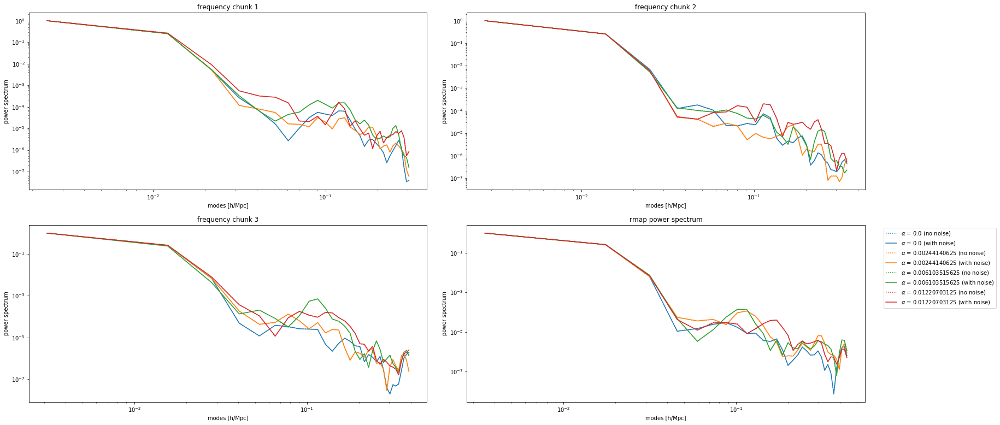

In [225]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


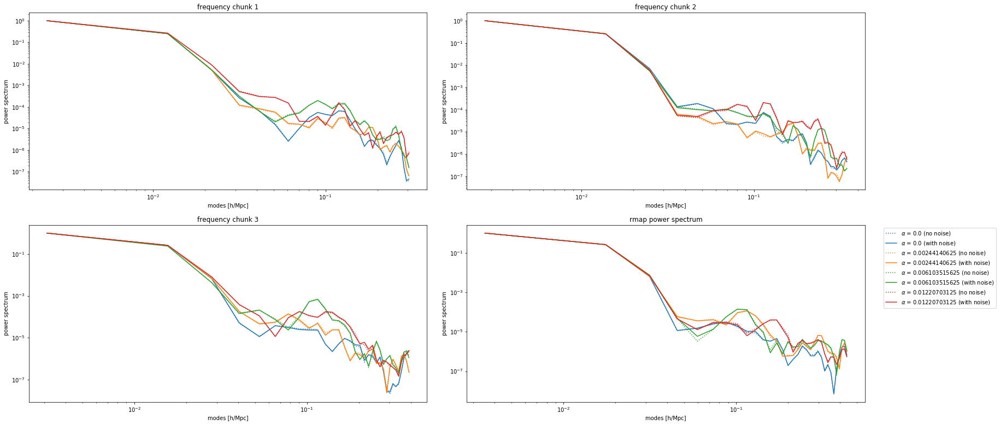

In [226]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


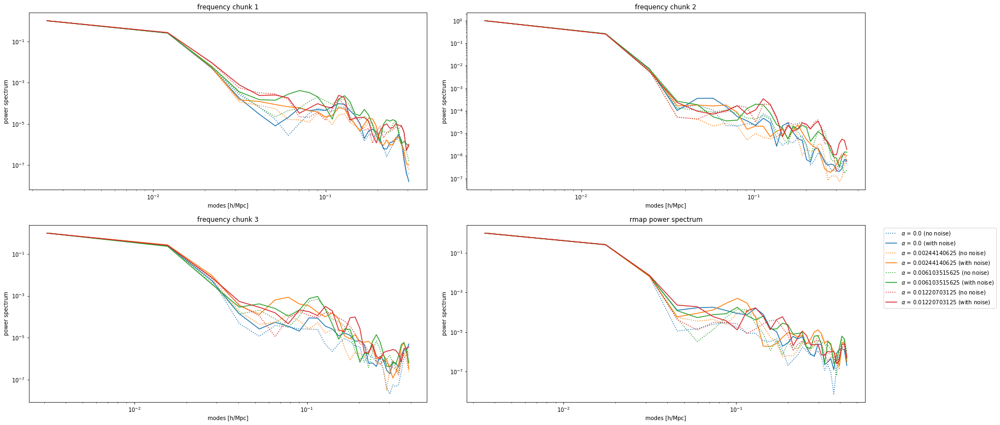

In [227]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Poisson sky.

In [228]:
image = t.get_poisson_sky(lam=1, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


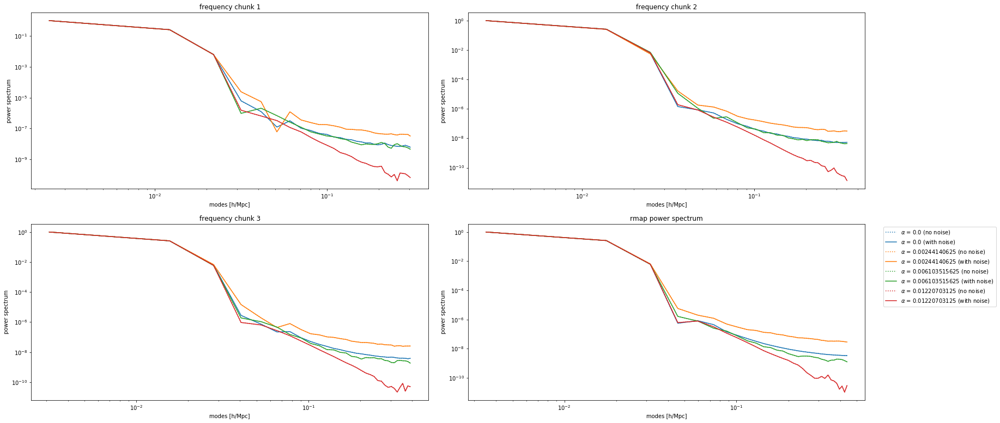

In [229]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


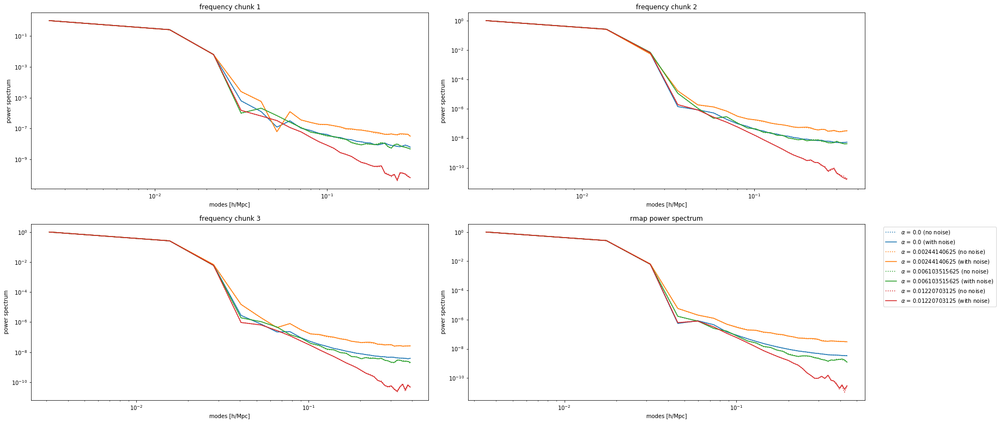

In [230]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


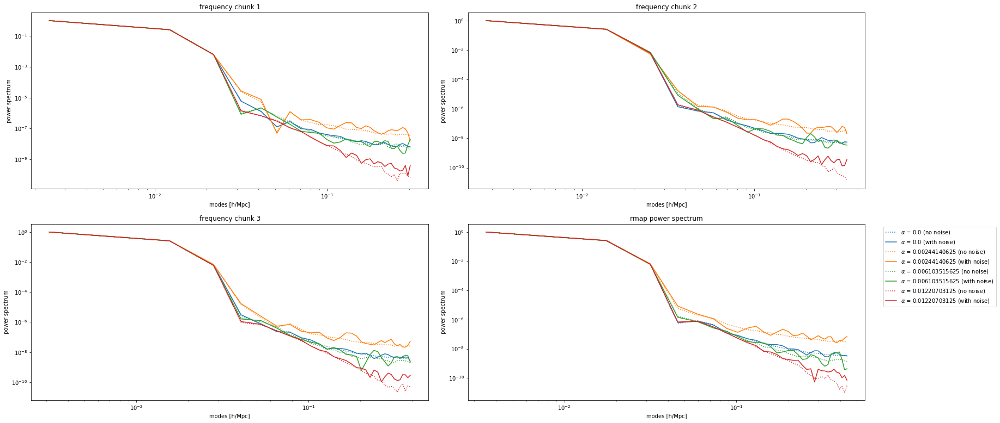

In [231]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Gaussian sky.

In [232]:
image = t.get_gaussian_sky(mean=1, sigma_o=0.5, sigma_f=40)
uvplane = t.beam_convolution(image)

Time error of 1 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832
Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


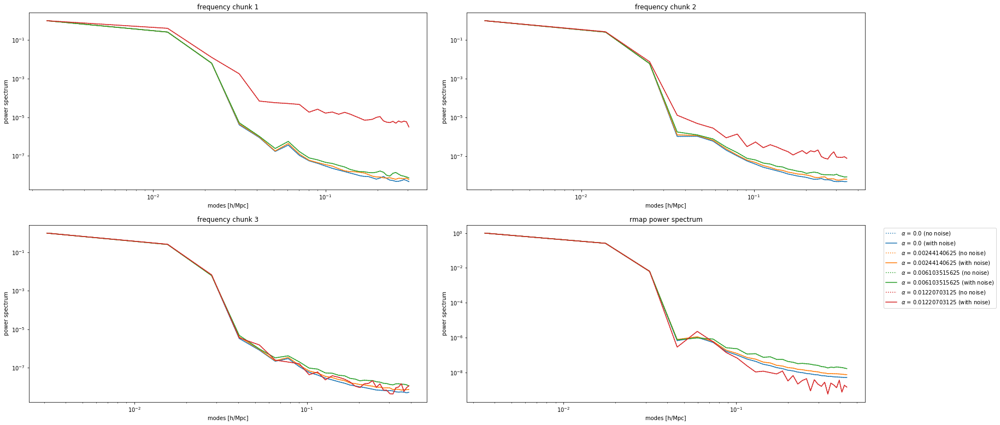

In [233]:
rmap_no_error = t.get_obs_rmap(uvplane, time_error_sigma=0)
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=1e-12)
(ps_binned_no_error, k_modes_no_error, alpha_binned_no_error) = t.get_rmap_ps(rmap_no_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 10 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


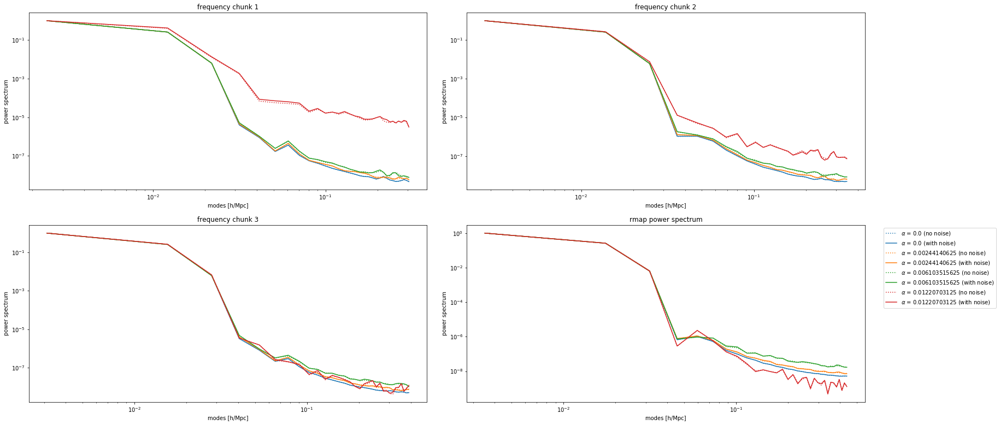

In [234]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=10e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)

Time error of 100 picoseconds.

Fundamental mode for chunk 0 is 0.004867932835219629
Fundamental mode for chunk 1 is 0.0055324652253057474
Fundamental mode for chunk 2 is 0.00623923927472226
Fundamental mode for chunk 3 is 0.007015544276754832


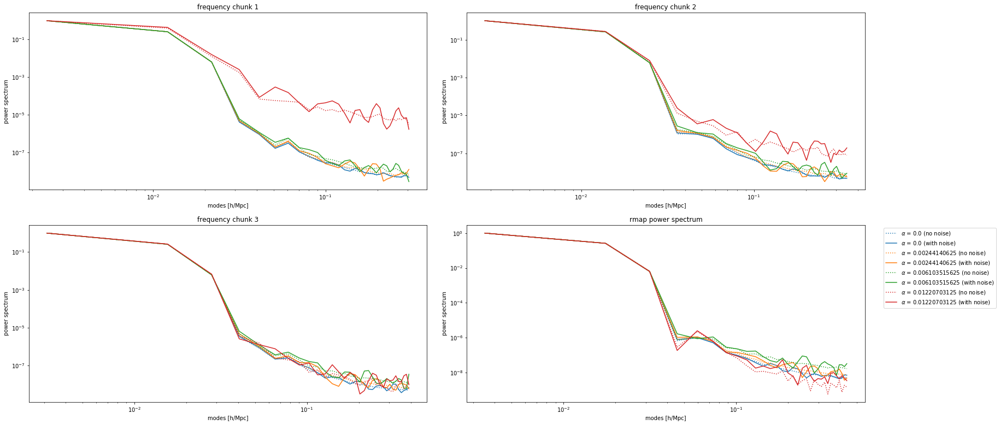

In [235]:
rmap_with_error = t.get_obs_rmap(uvplane, time_error_sigma=100e-12)
(ps_binned_with_error, k_modes_with_error, alpha_binned_with_error) = t.get_rmap_ps(rmap_with_error, Nfreqchunks=4, m_alpha=2, m_freq=2, padding=1, window_fn=np.blackman)
f = t.plot_rmap_ps_slice(ps_binned_no_error, ps_binned_with_error, k_modes_no_error, alpha_binned_no_error, alpha_idx_source=[], 
                     alpha_idx_no_source=[t.Npix//2, t.Npix//2+10, t.Npix//2+25, t.Npix//2+50], Nfreqchunks=4)